# Warawa Local Govt Area Data

In this notebook, we'll be working with the cleaned data for Warawa, a Local Govt Area (LGA) in South Kano.

## Loading Data

In [1]:
warawa_path = 'https://raw.githubusercontent.com/ashwinsingh7/Omdena-Smart-Agri-Using-AI-in-Kano-Nigeria/refs/heads/main/Warawa_South_Kano_cleaned.csv'

In [2]:
import pandas as pd

df = pd.read_csv(warawa_path)

## Inspecting Data

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4018 entries, 0 to 4017
Data columns (total 20 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Unnamed: 0                            4018 non-null   int64  
 1   LGA Name                              4018 non-null   object 
 2   Sub-Region                            4018 non-null   object 
 3   Latitude                              4018 non-null   float64
 4   Longitude                             4018 non-null   float64
 5   Date                                  4018 non-null   object 
 6   YEAR                                  4018 non-null   int64  
 7   DOY                                   4018 non-null   int64  
 8   Temperature_at_2_Meters_Average_(C)   4018 non-null   float64
 9   Temperature_at_2_Meters_Maximum_(C)   4018 non-null   float64
 10  Temperature_at_2_Meters_Minimum_(C)   4018 non-null   float64
 11  Relative_Humidity

In [4]:
df.head()

,Unnamed: 0,LGA Name,Sub-Region,Latitude,Longitude,Date,YEAR,DOY,Temperature_at_2_Meters_Average_(C),Temperature_at_2_Meters_Maximum_(C),Temperature_at_2_Meters_Minimum_(C),Relative_Humidity_at_2_Meters_(%),Precipitation_Corrected_(mm/day),Wind_Speed_at_2_Meters_Average_(m/s),Wind_Speed_at_2_Meters_Maximum_(m/s),Wind_Speed_at_2_Meters_Minimum_(m/s),Wind_Direction_at_2_Meters_(Degrees),Surface_Soil_Wetness_(1),Root_Zone_Soil_Wetness_(1),Profile_Soil_Moisture_(1)
0,0,Warawa,Southern,11.9067,8.7724,2014-01-01,2014,1,19.92,31.58,10.23,18.48,0.0,0.90,1.70,0.50,39.4,0.19,0.24,0.26
1,1,Warawa,Southern,11.9067,8.7724,2014-01-02,2014,2,20.21,29.80,12.59,15.86,0.0,1.07,1.85,0.62,43.7,0.19,0.24,0.26
2,2,Warawa,Southern,11.9067,8.7724,2014-01-03,2014,3,20.56,30.12,12.44,16.93,0.0,1.33,2.46,0.76,45.2,0.18,0.24,0.26
3,3,Warawa,Southern,11.9067,8.7724,2014-01-04,2014,4,20.51,30.72,12.47,19.74,0.0,1.34,2.46,0.72,52.8,0.18,0.24,0.26
4,4,Warawa,Southern,11.9067,8.7724,2014-01-05,2014,5,20.17,29.41,12.13,22.80,0.0,1.23,2.10,0.65,55.0,0.18,0.24,0.26


In [5]:
# data type of Date column

print(df['Date'].dtype)

object


Changing Date to datetime type


In [6]:
# Convert 'Date' column to datetime type
df['Date'] = pd.to_datetime(df['Date'])

# Print the data type again to verify the conversion
print(df['Date'].dtype)

datetime64[ns]


# Inspecting Weather Data Time Series

## Important Weather Parameters

Based on our EDA and theoretical agriculture insights, we can say that the following metrics will probably be of highest interest to us:

<br>

For direct impact on crops -

- Precipitation_Corrected_(mm/day)
- Surface_Soil_Wetness_(1)
- Root_Zone_Soil_Wetness_(1)

<br>

Indirect impact and supplementary information -

- Temperature_at_2_Meters_Average_(C)
- Temperature_at_2_Meters_Maximum_(C)
- Relative_Humidity_at_2_Meters_(%)
- Wind_Speed_at_2_Meters_Average_(m/s)
- Wind_Speed_at_2_Meters_Maximum_(m/s)
- Profile_Soil_Moisture_(1)

## Visualising Time Series & Histograms

In [7]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [8]:
# defining variables of interest

vars_of_int = ['Temperature_at_2_Meters_Average_(C)',
       'Temperature_at_2_Meters_Maximum_(C)',
       'Temperature_at_2_Meters_Minimum_(C)',
       'Relative_Humidity_at_2_Meters_(%)', 'Precipitation_Corrected_(mm/day)',
       'Wind_Speed_at_2_Meters_Average_(m/s)',
       'Wind_Speed_at_2_Meters_Maximum_(m/s)',
       'Wind_Speed_at_2_Meters_Minimum_(m/s)',
       'Wind_Direction_at_2_Meters_(Degrees)', 'Surface_Soil_Wetness_(1)',
       'Root_Zone_Soil_Wetness_(1)', 'Profile_Soil_Moisture_(1)']

In [9]:
#Function for plotting time series and histogram


def plot_time_series_and_histogram(data, column_name):

  print(f'\n\n\n{column_name}\n')

  #time series plot
  plt.figure(figsize=(20, 4))  # Adjust width for a wider chart
  plt.plot(df['Date'], df[column_name])
  plt.xlabel('Date')
  plt.ylabel(column_name)
  plt.title(f'Time Series of {column_name}')
  plt.grid(True)
  plt.show()

  print('\n')

  #histogram plot
  plt.figure(figsize=(6, 3))
  plt.hist(df[column_name], bins=50, edgecolor='black')
  plt.xlabel(column_name)
  plt.ylabel('Frequency')
  plt.title(f'Histogram of {column_name}')
  plt.grid(True)
  plt.show()




Temperature_at_2_Meters_Average_(C)



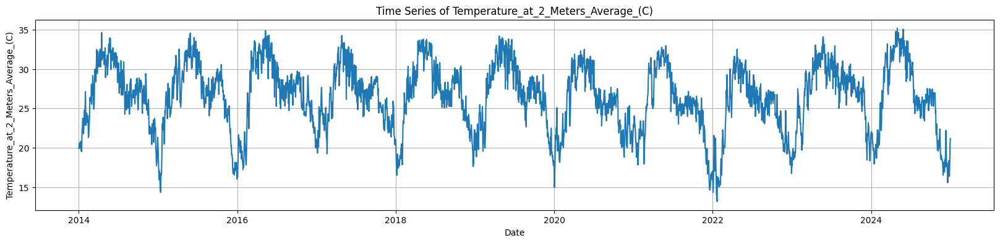

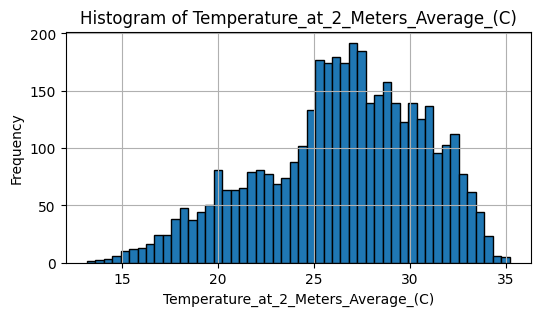




Temperature_at_2_Meters_Maximum_(C)



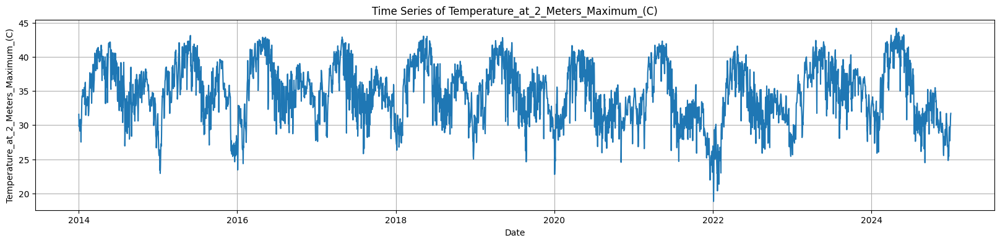

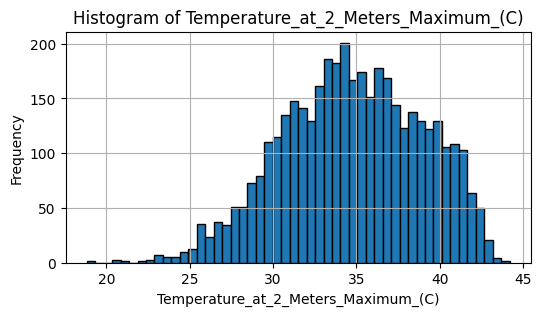




Temperature_at_2_Meters_Minimum_(C)



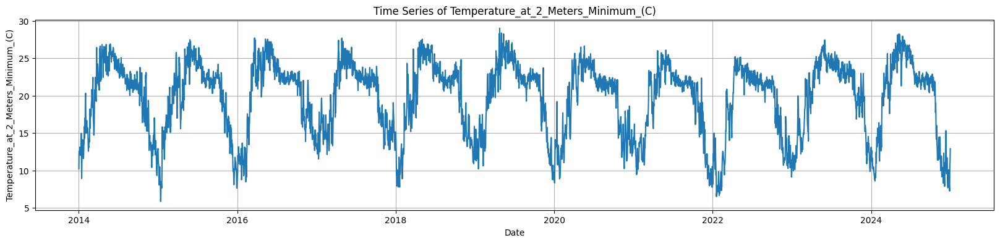

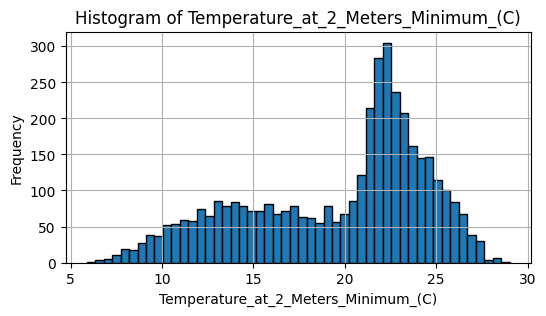




Relative_Humidity_at_2_Meters_(%)



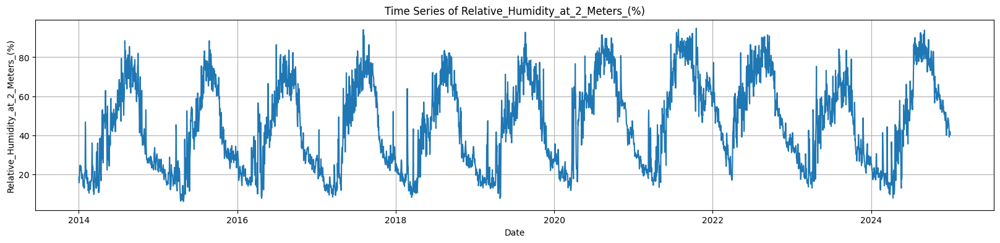

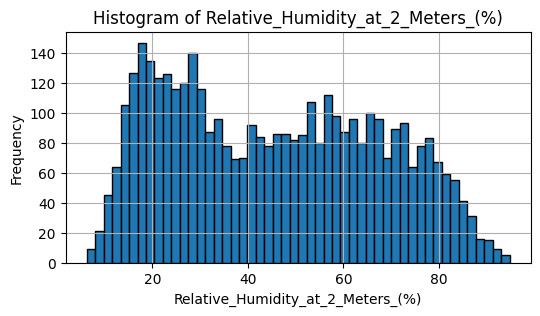




Precipitation_Corrected_(mm/day)



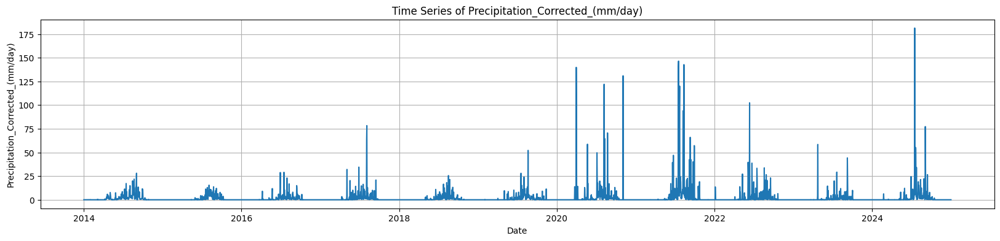

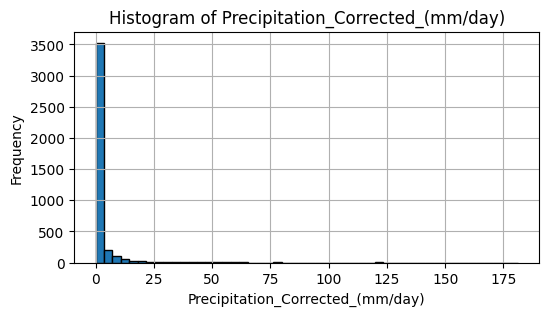




Wind_Speed_at_2_Meters_Average_(m/s)



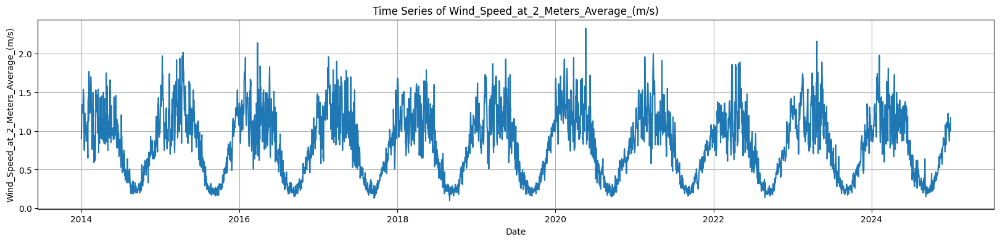

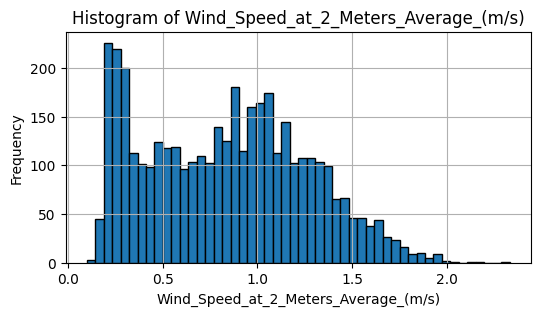




Wind_Speed_at_2_Meters_Maximum_(m/s)



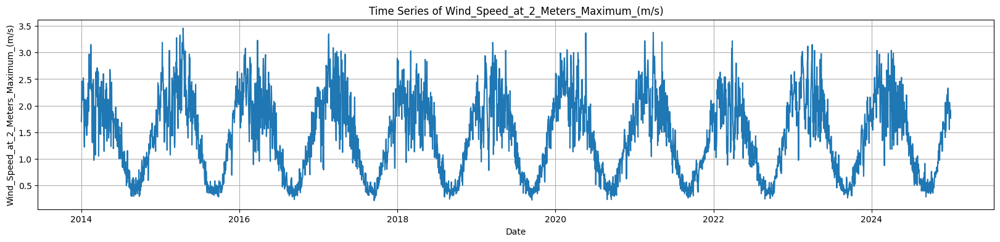

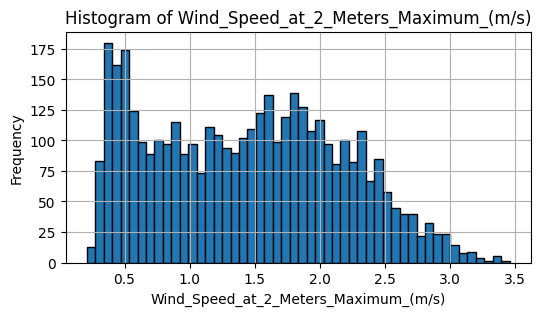




Wind_Speed_at_2_Meters_Minimum_(m/s)



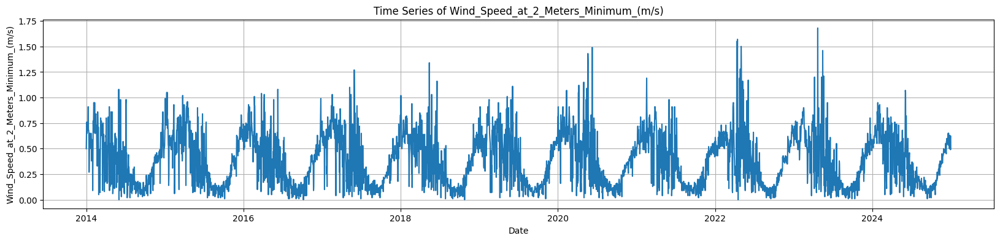

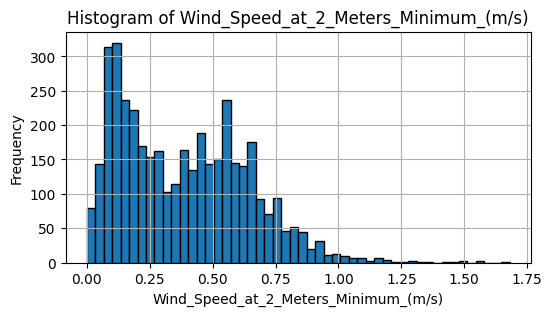




Wind_Direction_at_2_Meters_(Degrees)



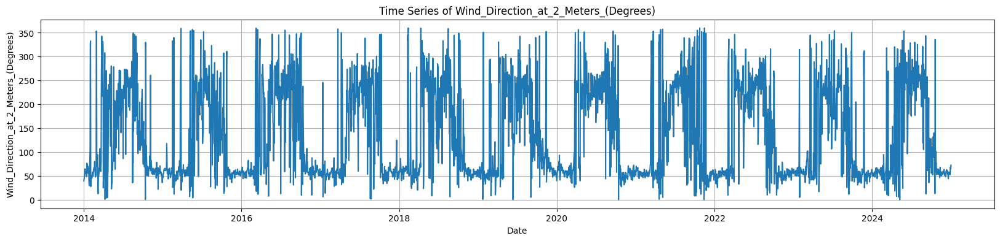

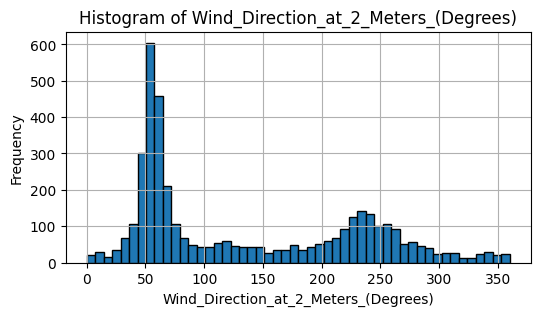




Surface_Soil_Wetness_(1)



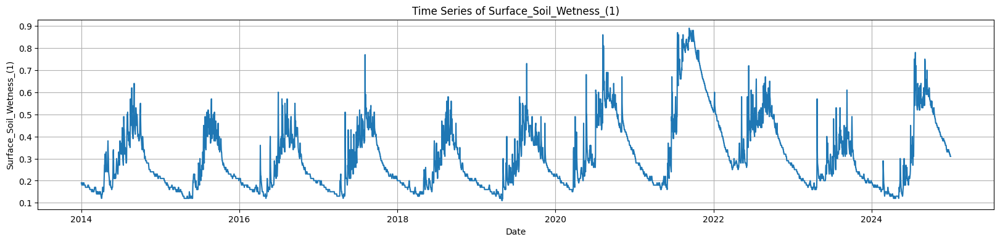

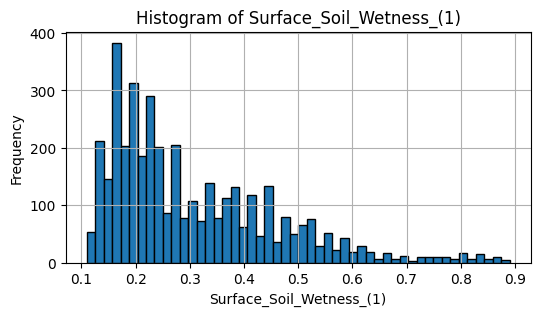




Root_Zone_Soil_Wetness_(1)



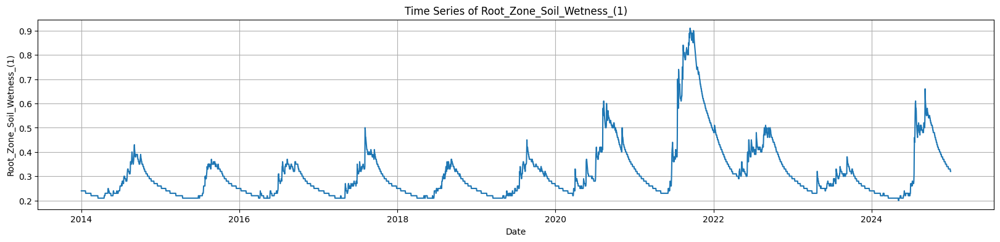

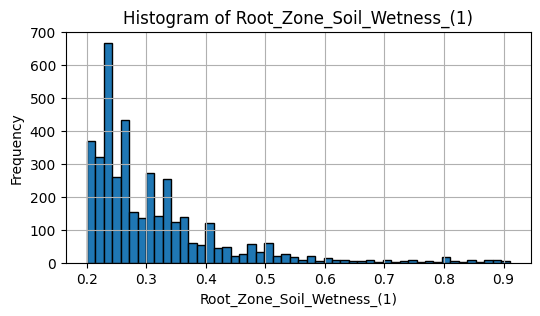




Profile_Soil_Moisture_(1)



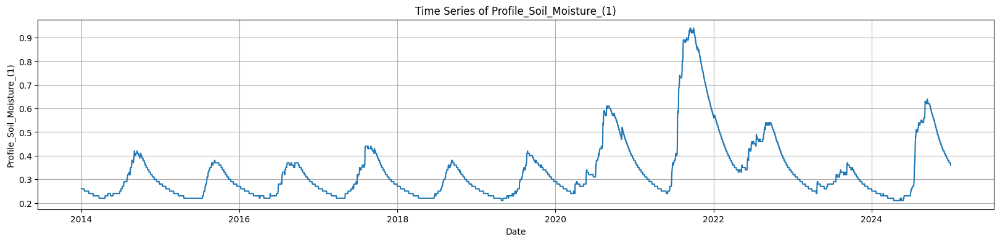

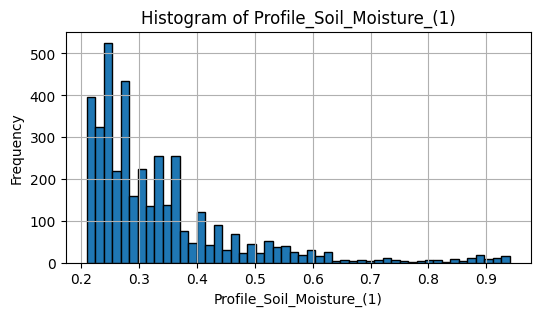

In [10]:
for col in vars_of_int:
  plot_time_series_and_histogram(df, col)

### All Soil Moisture

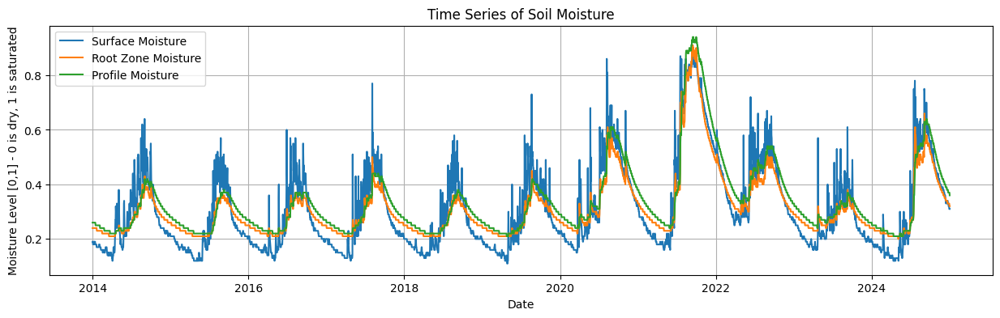

In [11]:
# time series plot for surface, root and profile moisture

import matplotlib.pyplot as plt

def plot_moisture_time_series(df):
  """Plots time series for surface, root, and profile moisture."""

  plt.figure(figsize=(15, 4))
  plt.plot(df['Date'], df['Surface_Soil_Wetness_(1)'], label='Surface Moisture')
  plt.plot(df['Date'], df['Root_Zone_Soil_Wetness_(1)'], label='Root Zone Moisture')
  plt.plot(df['Date'], df['Profile_Soil_Moisture_(1)'], label='Profile Moisture')
  plt.xlabel('Date')
  plt.ylabel('Moisture Level [0,1] - 0 is dry, 1 is saturated')
  plt.title('Time Series of Soil Moisture')
  plt.legend()
  plt.grid(True)
  plt.show()

plot_moisture_time_series(df)

### All Temperature

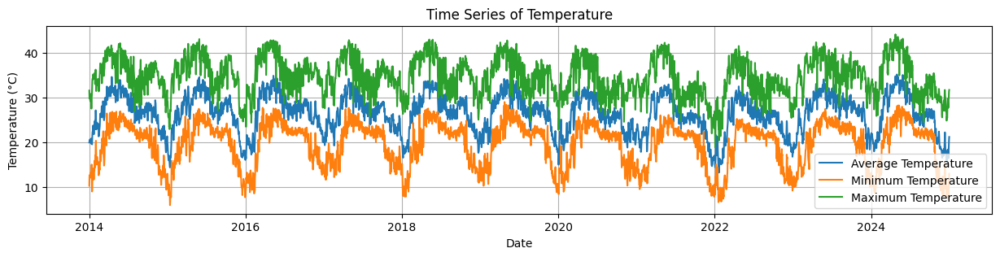

In [12]:
# time series plot for avg, min and max temp

import matplotlib.pyplot as plt
def plot_temp_time_series(df):
  """Plots time series for average, minimum, and maximum temperature."""

  plt.figure(figsize=(15, 3))
  plt.plot(df['Date'], df['Temperature_at_2_Meters_Average_(C)'], label='Average Temperature')
  plt.plot(df['Date'], df['Temperature_at_2_Meters_Minimum_(C)'], label='Minimum Temperature')
  plt.plot(df['Date'], df['Temperature_at_2_Meters_Maximum_(C)'], label='Maximum Temperature')
  plt.xlabel('Date')
  plt.ylabel('Temperature (°C)')
  plt.title('Time Series of Temperature')
  plt.legend()
  plt.grid(True)
  plt.show()

plot_temp_time_series(df)

### All Wind Speed

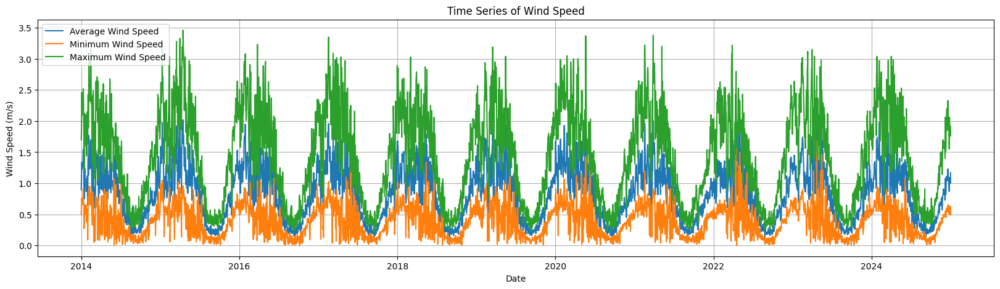

In [13]:
# time series for min max avg wind speed

import matplotlib.pyplot as plt
def plot_wind_speed_time_series(df):
  """Plots time series for average, minimum, and maximum wind speed."""

  plt.figure(figsize=(20, 5))
  plt.plot(df['Date'], df['Wind_Speed_at_2_Meters_Average_(m/s)'], label='Average Wind Speed')
  plt.plot(df['Date'], df['Wind_Speed_at_2_Meters_Minimum_(m/s)'], label='Minimum Wind Speed')
  plt.plot(df['Date'], df['Wind_Speed_at_2_Meters_Maximum_(m/s)'], label='Maximum Wind Speed')
  plt.xlabel('Date')
  plt.ylabel('Wind Speed (m/s)')
  plt.title('Time Series of Wind Speed')
  plt.legend()
  plt.grid(True)
  plt.show()

plot_wind_speed_time_series(df)

### Precipitation & Humidity

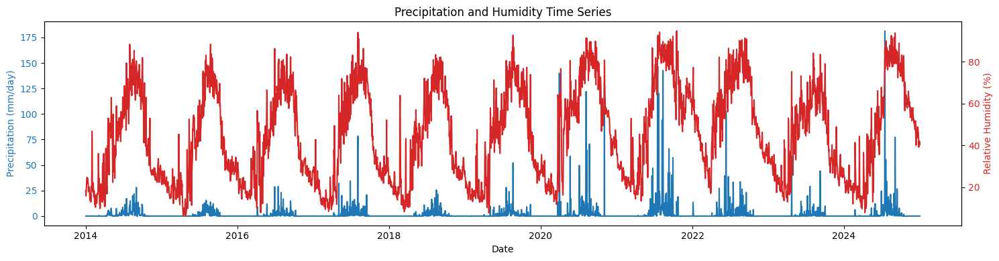

In [14]:
# time series for precipitation and humidity with precipitation

import matplotlib.pyplot as plt
def plot_precipitation_humidity(df):
  """Plots precipitation and humidity time series on separate y-axes."""

  fig, ax1 = plt.subplots(figsize=(15, 4))

  # Plot precipitation on the left y-axis
  color = 'tab:blue'
  ax1.set_xlabel('Date')
  ax1.set_ylabel('Precipitation (mm/day)', color=color)
  ax1.plot(df['Date'], df['Precipitation_Corrected_(mm/day)'], color=color)
  ax1.tick_params(axis='y', labelcolor=color)

  # Create a second y-axis for humidity on the right
  ax2 = ax1.twinx()
  color = 'tab:red'
  ax2.set_ylabel('Relative Humidity (%)', color=color)
  ax2.plot(df['Date'], df['Relative_Humidity_at_2_Meters_(%)'], color=color)
  ax2.tick_params(axis='y', labelcolor=color)

  plt.title('Precipitation and Humidity Time Series')
  fig.tight_layout()  # Adjust layout to prevent overlapping labels
  plt.show()

plot_precipitation_humidity(df)


### Takeaways from Visual Inspection

- For the **temperature, humidity and wind speed** parameters, the mean and variance of the time series seem to be fairly constant over time.

- For **soil moisture/wetness**, while the mean and variance are fairly constant for most years, 2021 seems to be a year with abnormally high soil moisture levels.

- For **precipitation**, the mean and variance seem to be fairly uniform from 2014-2019 and in 2023. The charts show unusually high rainfall in 2020, 2021, 2022 and 2024.

**POINTS TO NOTE:**

<br>

After doing some research, it seems like the **naive forecast** (one where predicted value = last day's value, i.e., y_pred_(t) = y_(t-1) ) does a very good job at **univariate** time series forecasting of weather metrics.

This is especially the case for variables that may show considerable variation from one year to the next (as is the case with precipitation and soil moisture levels in our dataset).

It also seems like sophisticated and powerful modelling techniques like SARIMA, XGBOOST and LSTM are not substantially better than the naive forecast, and in fact, often mimic the naive forecast's predictions.

<br>

Reference:
- https://github.com/georgezoto/Coding-in-TensorFlow/blob/master/Time-Series-Prediction/Sample_Code_Weather_data_Madrid.ipynb

- https://www.youtube.com/watch?v=FHmIq_6V7wk

- https://docs.google.com/presentation/d/1XXSLSTDOUnlYK1ksA4p3Kym-sDd7Nzj2r7__2fYqkxo/edit#slide=id.g93d1cce560_0_59

- Temp modelling with fourier series + ARIMA https://github.com/rkraig/DLA/blob/master/202008_codingChallenges/20200904_madrid/madridWeather.ipynb

# Forecastability

# Seasonal Decomposition & Stationarity Testing

# Holt Winters Smoothing - Theoretical Overview

We use the Holt Winter's model which captures the following components of a time series using an EWMA (Exponential Weighted Moving Average) process:

- Level (this is the stable long term average)
- Trend (this is the long term upward or downward movement of the time series)
- Seasonality (this is the seasonal variation based on the specificed seasonal length)

Since our time series does not visually show any strong trend, we can go with a linear approach where:

time series = level + trend + seasonality

**Why Use Holt-Winters?**

Holt-Winters is perfect when:

✅ There is a trend (e.g. temperature increasing/decreasing over time)

✅ There is seasonality (e.g. temperature rises in summer, drops in winter)

✅ The variable is relatively smooth and continuous (e.g.  temperature)

Unlike ARIMA, Holt-Winters does not require differencing and is great when you don't want to go through a lot of pre-processing.

<br>

**Step-by-Step Theoretical Layout:**

Holt-Winters is an extension of Exponential Smoothing, which weights recent values more than older ones. It adds:

Level (ℓ) – The baseline of the series

Trend (b) – The direction the data is moving (up/down)

Seasonality (s) – The repeating pattern over time (like temperature rising every summer)

<br>

h-step forecast: Y_pred(t+h) = ℓ(t) + b(t).h + s(t+h-mk)

where -

k = floor((h-1)/m) + 1

```
in Python -> k = ((h-1)//m) + 1
```

  , and,

m = season length (365 for annual daily forecasts)

<br>

**Additive vs. Multiplicative Seasonality:**

Additive model if seasonality remains constant in magnitude (e.g., temperature rises 10°C every summer consistently).
Multiplicative model if seasonality changes with the trend (e.g., hotter summers as years pass → seasonality "grows").


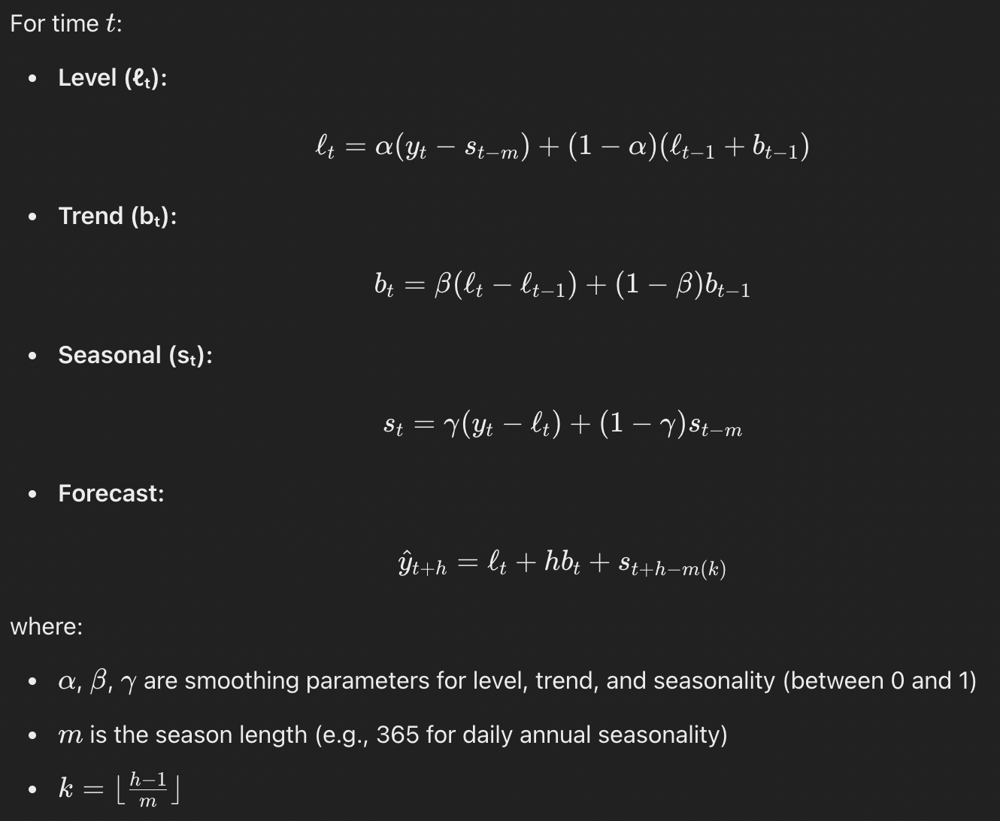

## Performance Evaluation - MAE, RMSE, sMAPE, R-Squared

sMAPE

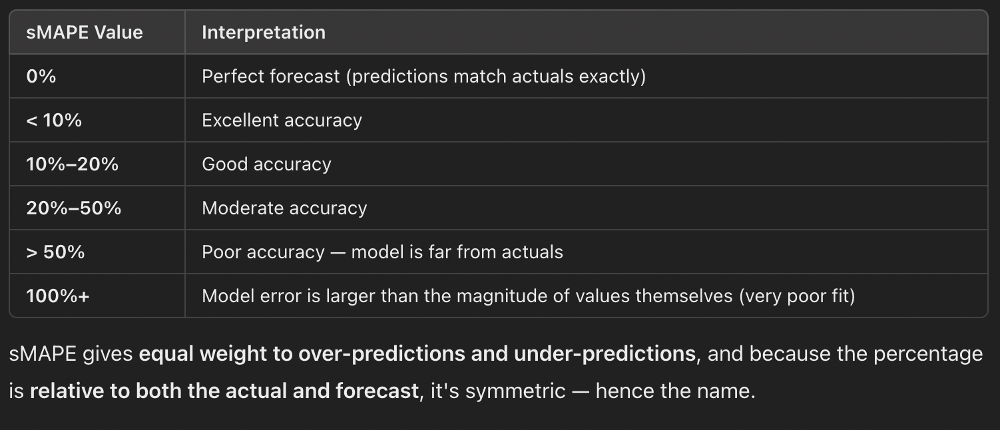

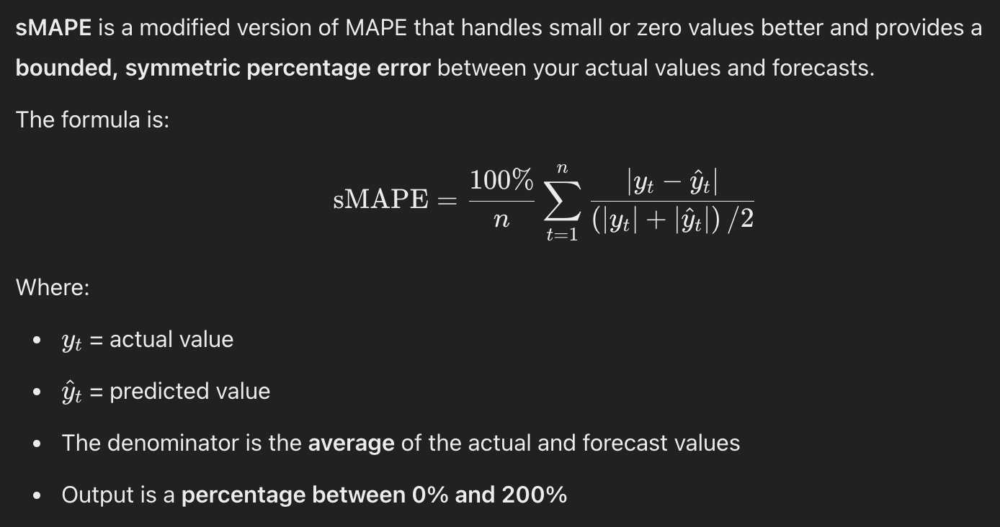

# 1) Average Temperature Time Series Analysis

## A) Holt Winters

### Modelling

In [15]:
# set Date as index

import pandas as pd

df = df.set_index('Date')

In [16]:
df

,Unnamed: 0,LGA Name,Sub-Region,Latitude,Longitude,YEAR,DOY,Temperature_at_2_Meters_Average_(C),Temperature_at_2_Meters_Maximum_(C),Temperature_at_2_Meters_Minimum_(C),Relative_Humidity_at_2_Meters_(%),Precipitation_Corrected_(mm/day),Wind_Speed_at_2_Meters_Average_(m/s),Wind_Speed_at_2_Meters_Maximum_(m/s),Wind_Speed_at_2_Meters_Minimum_(m/s),Wind_Direction_at_2_Meters_(Degrees),Surface_Soil_Wetness_(1),Root_Zone_Soil_Wetness_(1),Profile_Soil_Moisture_(1)
Date,,,,,,,,,,,,,,,,,,,
2014-01-01,0,Warawa,Southern,11.9067,8.7724,2014,1,19.92,31.58,10.23,18.48,0.0,0.90,1.70,0.50,39.4,0.19,0.24,0.26
2014-01-02,1,Warawa,Southern,11.9067,8.7724,2014,2,20.21,29.80,12.59,15.86,0.0,1.07,1.85,0.62,43.7,0.19,0.24,0.26
2014-01-03,2,Warawa,Southern,11.9067,8.7724,2014,3,20.56,30.12,12.44,16.93,0.0,1.33,2.46,0.76,45.2,0.18,0.24,0.26
2014-01-04,3,Warawa,Southern,11.9067,8.7724,2014,4,20.51,30.72,12.47,19.74,0.0,1.34,2.46,0.72,52.8,0.18,0.24,0.26
2014-01-05,4,Warawa,Southern,11.9067,8.7724,2014,5,20.17,29.41,12.13,22.80,0.0,1.23,2.10,0.65,55.0,0.18,0.24,0.26
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-12-27,4013,Warawa,Southern,11.9067,8.7724,2024,362,16.39,27.71,7.66,41.28,0.0,1.06,1.92,0.63,52.6,0.32,0.33,0.37
2024-12-28,4014,Warawa,Southern,11.9067,8.7724,2024,363,17.33,29.54,7.27,42.18,0.0,1.01,1.82,0.55,68.5,0.32,0.33,0.37
2024-12-29,4015,Warawa,Southern,11.9067,8.7724,2024,364,19.01,29.99,10.75,41.41,0.0,1.08,1.86,0.58,64.4,0.31,0.33,0.37


In [17]:
vars_of_int

['Temperature_at_2_Meters_Average_(C)',
 'Temperature_at_2_Meters_Maximum_(C)',
 'Temperature_at_2_Meters_Minimum_(C)',
 'Relative_Humidity_at_2_Meters_(%)',
 'Precipitation_Corrected_(mm/day)',
 'Wind_Speed_at_2_Meters_Average_(m/s)',
 'Wind_Speed_at_2_Meters_Maximum_(m/s)',
 'Wind_Speed_at_2_Meters_Minimum_(m/s)',
 'Wind_Direction_at_2_Meters_(Degrees)',
 'Surface_Soil_Wetness_(1)',
 'Root_Zone_Soil_Wetness_(1)',
 'Profile_Soil_Moisture_(1)']

Preprocessing and Visual Inspection

In [18]:
#Imports

import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Select temperature column
avg_temp_series = df['Temperature_at_2_Meters_Average_(C)']

avg_temp_series


,Temperature_at_2_Meters_Average_(C)
Date,
2014-01-01,19.92
2014-01-02,20.21
2014-01-03,20.56
2014-01-04,20.51
2014-01-05,20.17
...,...
2024-12-27,16.39
2024-12-28,17.33
2024-12-29,19.01


In [19]:
#check missing values

avg_temp_series.isna().sum()

np.int64(0)

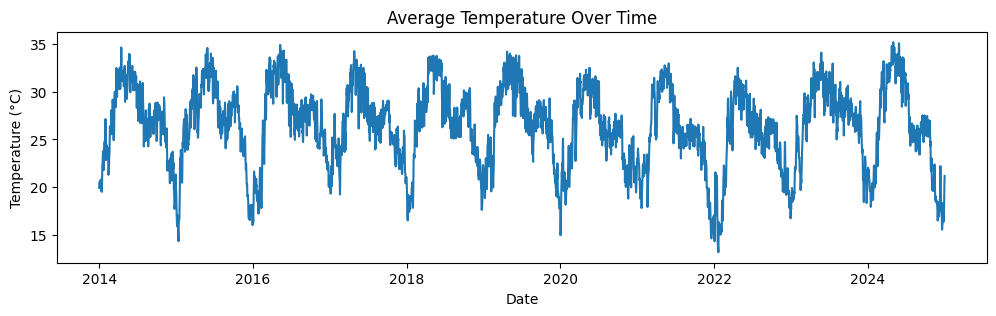

In [20]:
# Plot to check trend & seasonality
plt.figure(figsize=(12, 3))
plt.plot(avg_temp_series)
plt.title("Average Temperature Over Time")
plt.ylabel("Temperature (°C)")
plt.xlabel("Date")
plt.show()

Model Fitting

In [21]:
#FITTING THE MODEL

# Seasonality length: 365 for daily data with yearly seasonality
season_length = 365

# Fit Holt-Winters additive model (trend + seasonality)
hw_model_avg_temp = ExponentialSmoothing(
    avg_temp_series,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

# Forecast next 365 days
#forecast = hw_model_avg_temp.forecast(365)


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Inspecting Level, Trend, Seasonal Components and Residuals


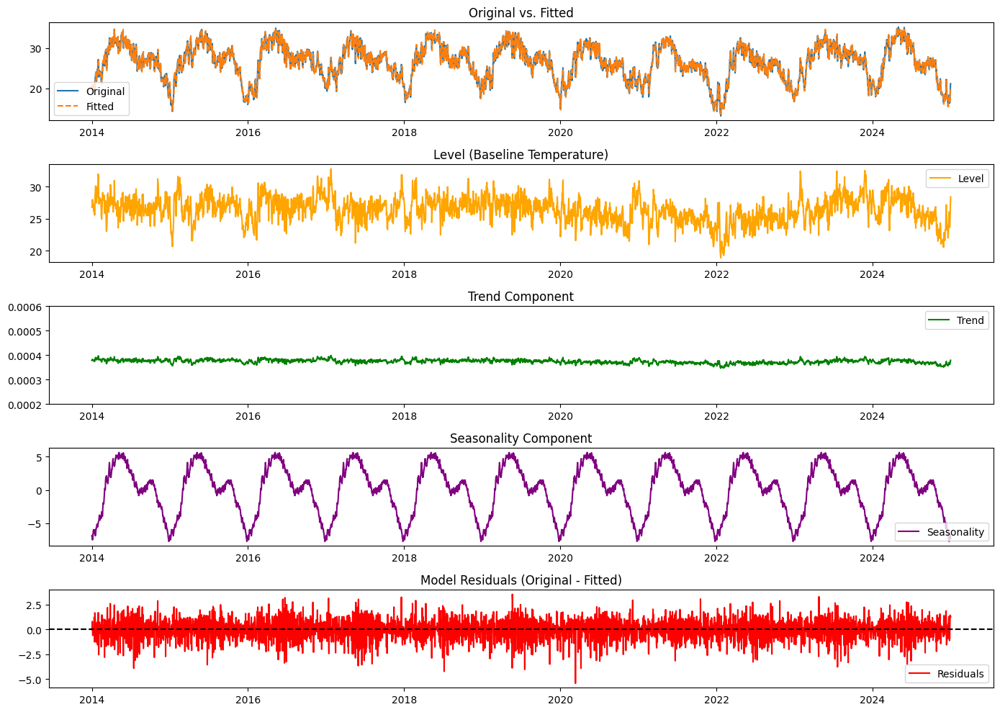

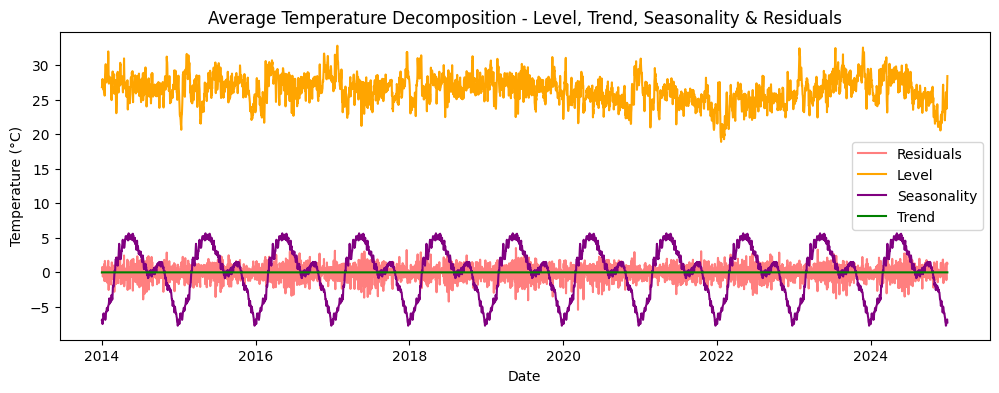

In [22]:
residuals = avg_temp_series - hw_model_avg_temp.fittedvalues

#PLOTTING TREND LEVEL AND SEASONALITY

import matplotlib.pyplot as plt

# Get components
level = hw_model_avg_temp.level
trend = hw_model_avg_temp.trend
season = hw_model_avg_temp.season
fitted = hw_model_avg_temp.fittedvalues

# Create subplots
plt.figure(figsize=(14, 10))

# Original series and fitted values
plt.subplot(5, 1, 1)
plt.plot(avg_temp_series, label='Original')
plt.plot(fitted, label='Fitted', linestyle='--')
plt.title('Original vs. Fitted')
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label='Level', color='orange')
plt.title('Level (Baseline Temperature)')
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label='Trend', color='green')
plt.title('Trend Component')
plt.ylim(0.0002,0.0006)
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label='Seasonality', color='purple')
plt.title('Seasonality Component')
plt.legend()

#R Residuals

plt.subplot(5,1,5)
plt.plot(residuals, label='Residuals', color='red')
plt.title('Model Residuals (Original - Fitted)')
plt.axhline(0, color='black', linestyle='--')
plt.legend()

'''
plt.figure(figsize=(12, 4))
plt.plot(residuals)
plt.title("Model Residuals (Original - Fitted)")
plt.axhline(0, color='black', linestyle='--')
plt.show()
'''

plt.tight_layout()
plt.show()




#plotting all-in-one

plt.figure(figsize=(12, 4))
#plt.plot(fitted, label='Fitted')
plt.plot(residuals, label='Residuals', color='red', alpha = 0.5)
plt.plot(level, label='Level', color='orange')
plt.plot(season, label='Seasonality', color='purple')
plt.plot(trend, label='Trend', color='green')

plt.legend()
plt.title("Average Temperature Decomposition - Level, Trend, Seasonality & Residuals")
plt.ylabel("Temperature (°C)")
plt.xlabel("Date")
plt.show()


**Interpretation Summary of Holt-Winters Model Components with Residuals:**

<br>

1. Original vs. Fitted:

The fitted line closely follows the original temperature series, indicating that the Holt-Winters model has accurately captured the underlying patterns in the data. The alignment suggests strong model performance in replicating observed temperature values.

<br>

2. Level (Baseline Temperature):

The level component shows the smoothed base temperature over time after removing seasonal and trend effects. It remains within a reasonable range of approximately 25–30°C with some fluctuations, reflecting short-term shifts in the central tendency of temperature.

<br>

3. Trend Component:

The trend is nearly flat and very small in magnitude, indicating that the model detects no significant long-term warming or cooling trend across the observed time span. The temperature series appears relatively stable in terms of directional change.

If we look closely, we can see a value of ~0.00037, which means the model believes the temperature increases very very slightly each day. This line shows the daily rate of change in the level — it's the slope of the trend.

<br>

4. Seasonality Component:

The seasonal pattern exhibits a clear and regular yearly cycle, ranging from approximately –5.5°C to +5.5°C. This reflects predictable annual temperature fluctuations, with peaks and troughs corresponding to warm and cool months, respectively.

<br>

5. Model Residuals (Original – Fitted):

The residuals are centered around zero with no clear trend, showing that the model errors are randomly distributed. This supports the assumption that the model has captured the systematic components (trend and seasonality) well. The magnitude of most residuals stays within ±2.5°C, which is acceptable for temperature modeling.

<br>

Overall Assessment:

The Holt-Winters model provides a good fit for the temperature data, effectively modeling both the seasonal structure and the overall baseline. The residual plot confirms that most of the structure in the data has been accounted for, making the model suitable for forecasting.

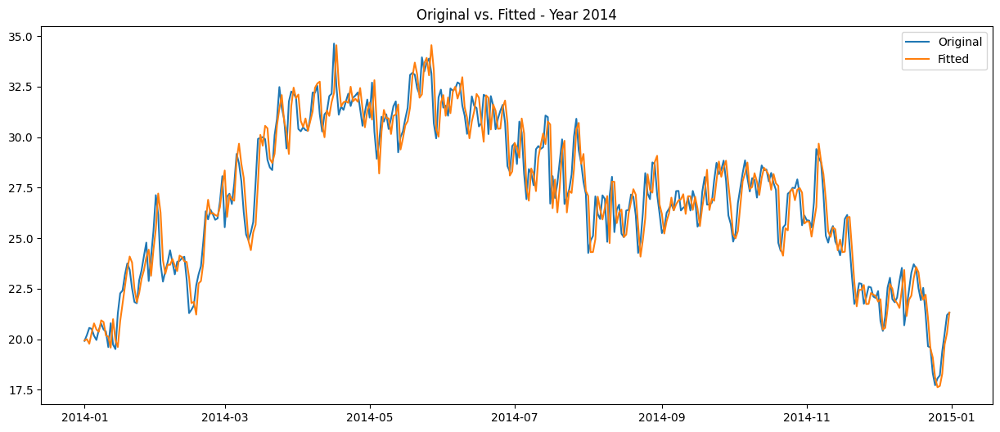

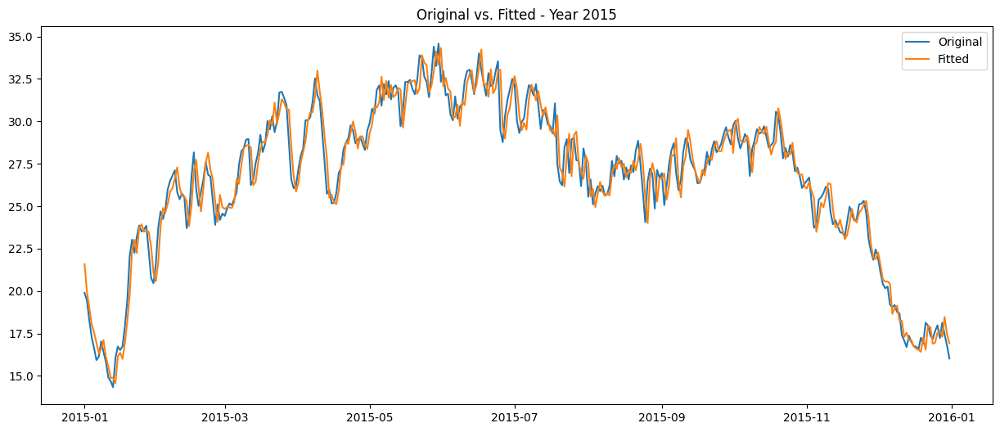

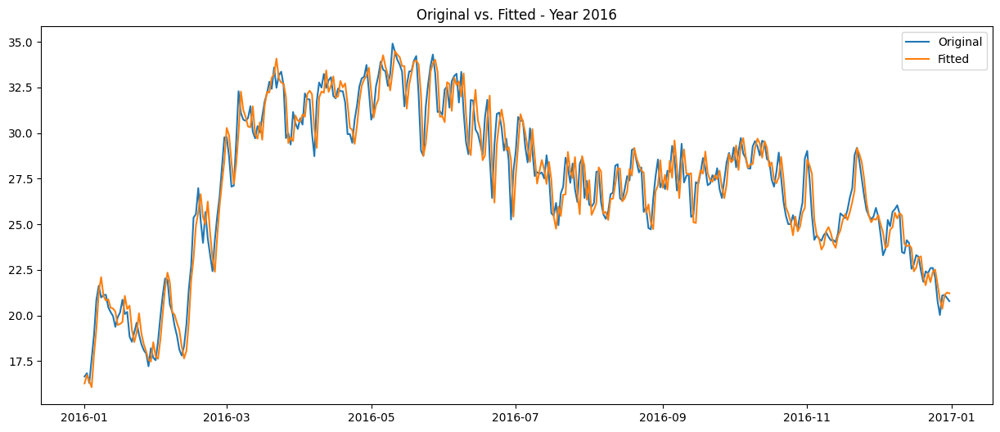

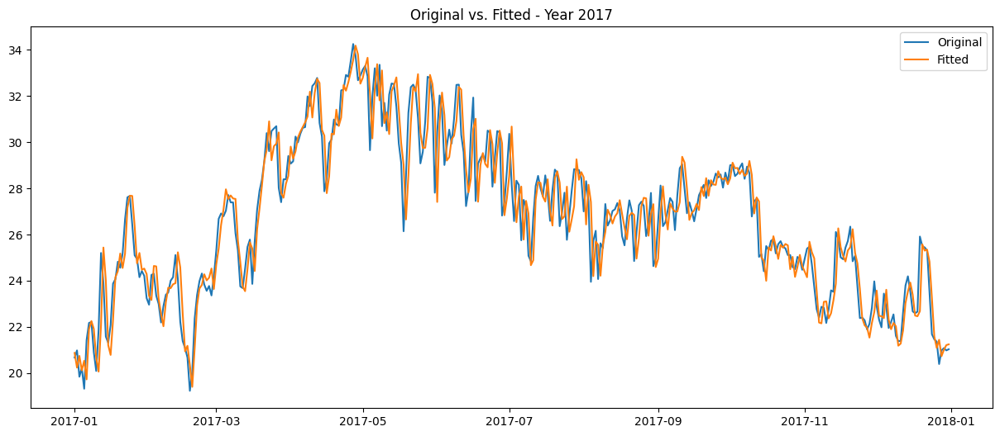

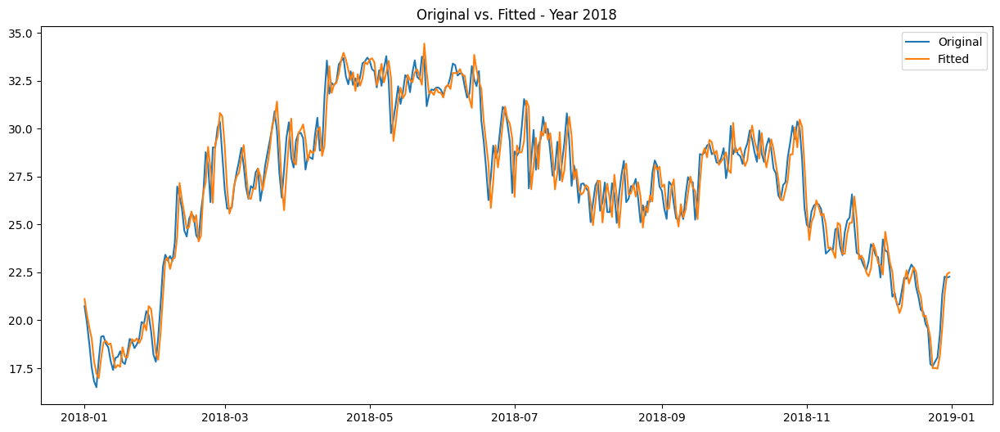

...

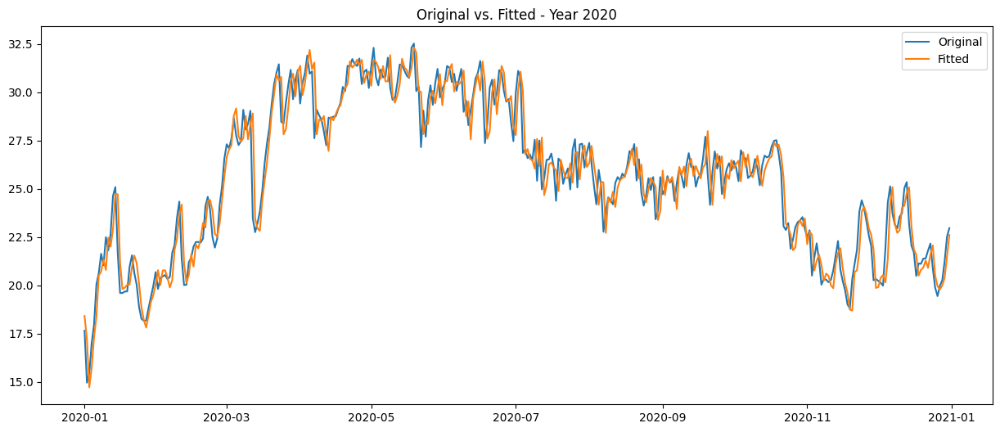

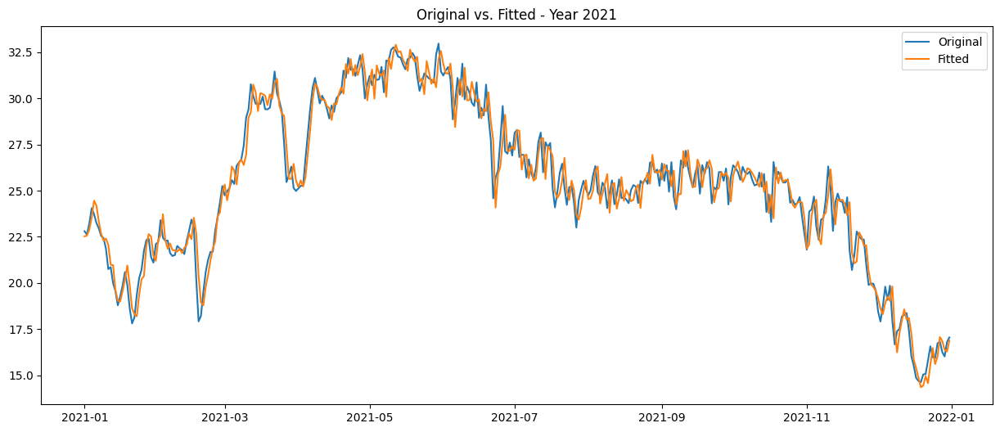

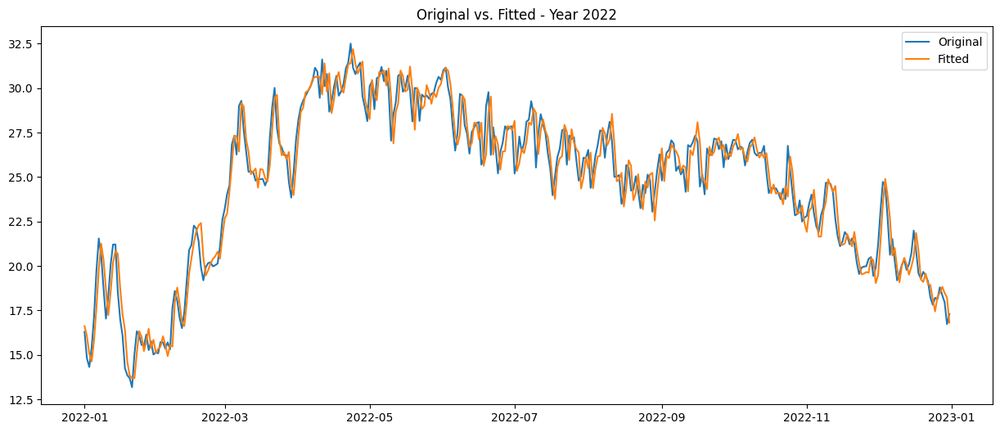

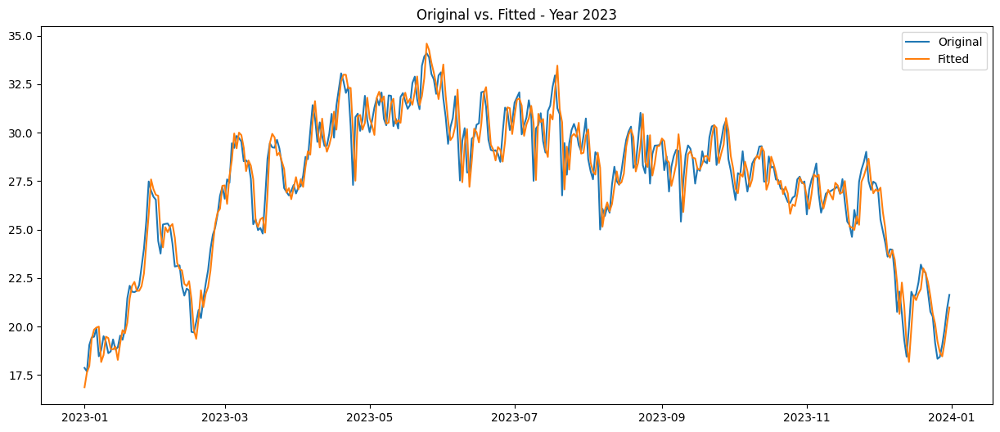

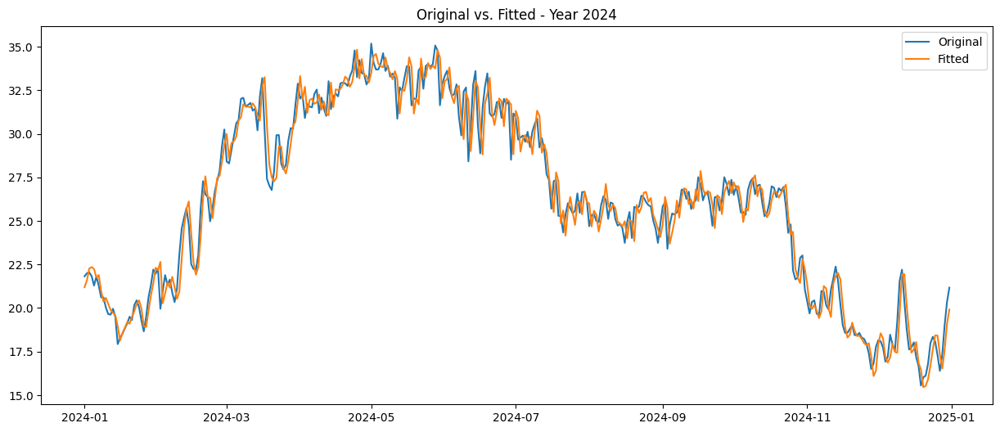

In [23]:
# temp_series vs fitted for each individual year

import pandas as pd
import matplotlib.pyplot as plt


# Convert the index to datetime objects if it's not already
df.index = pd.to_datetime(df.index)

# Group the data by year
for year, year_data in df.groupby(df.index.year):
    temp_series_year = year_data['Temperature_at_2_Meters_Average_(C)']
    fitted_year = hw_model_avg_temp.fittedvalues[year_data.index]

    plt.figure(figsize=(15, 6))
    plt.plot(temp_series_year, label='Original')
    plt.plot(fitted_year, label='Fitted')
    plt.title(f'Original vs. Fitted - Year {year}')
    plt.legend()
    plt.show()

### 2025 Forecast

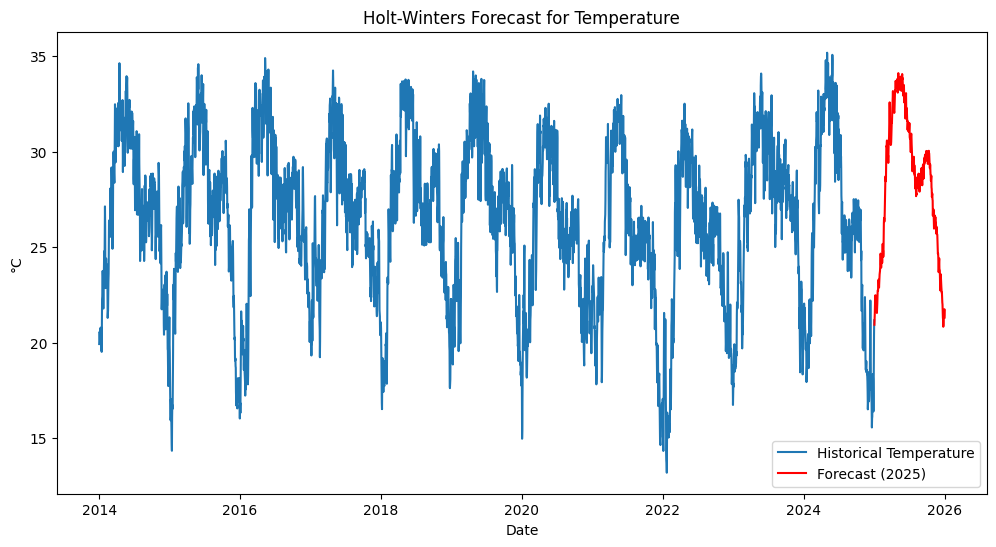

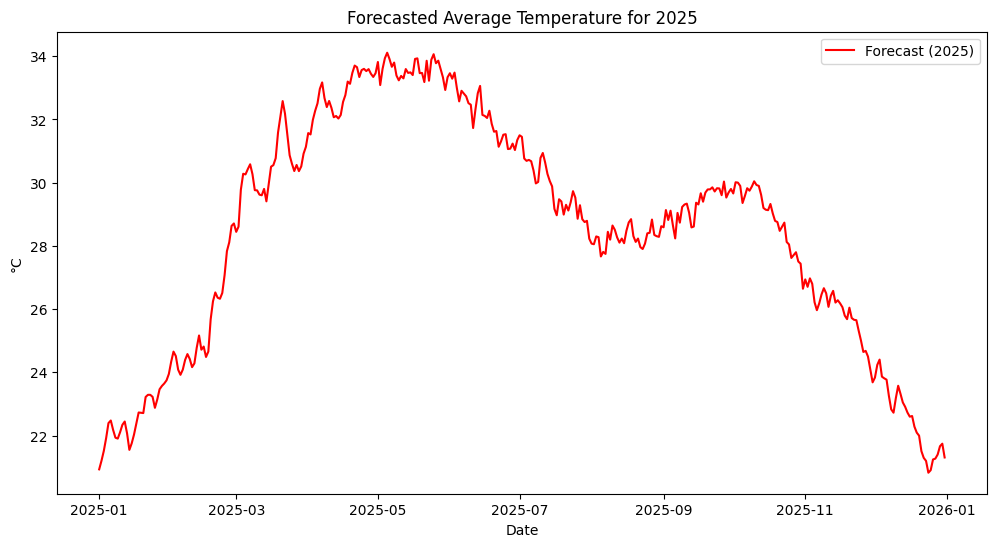

In [24]:
# Forecast next 365 days
forecast_avg_temp = hw_model_avg_temp.forecast(365)

#visualise all years
plt.figure(figsize=(12, 6))
plt.plot(avg_temp_series, label="Historical Temperature")
plt.plot(forecast_avg_temp.index, forecast_avg_temp, label="Forecast (2025)", color='red')
plt.title("Holt-Winters Forecast for Temperature")
plt.xlabel("Date")
plt.ylabel("°C")
plt.legend()
plt.show()

#visualise forecast
plt.figure(figsize=(12, 6))
plt.plot(forecast_avg_temp.index, forecast_avg_temp, label="Forecast (2025)", color='red')
plt.title("Forecasted Average Temperature for 2025")
plt.xlabel("Date")
plt.ylabel("°C")
plt.legend()
plt.show()

### Model Evaluation (Train: 2014-2023, Test: 2024)

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


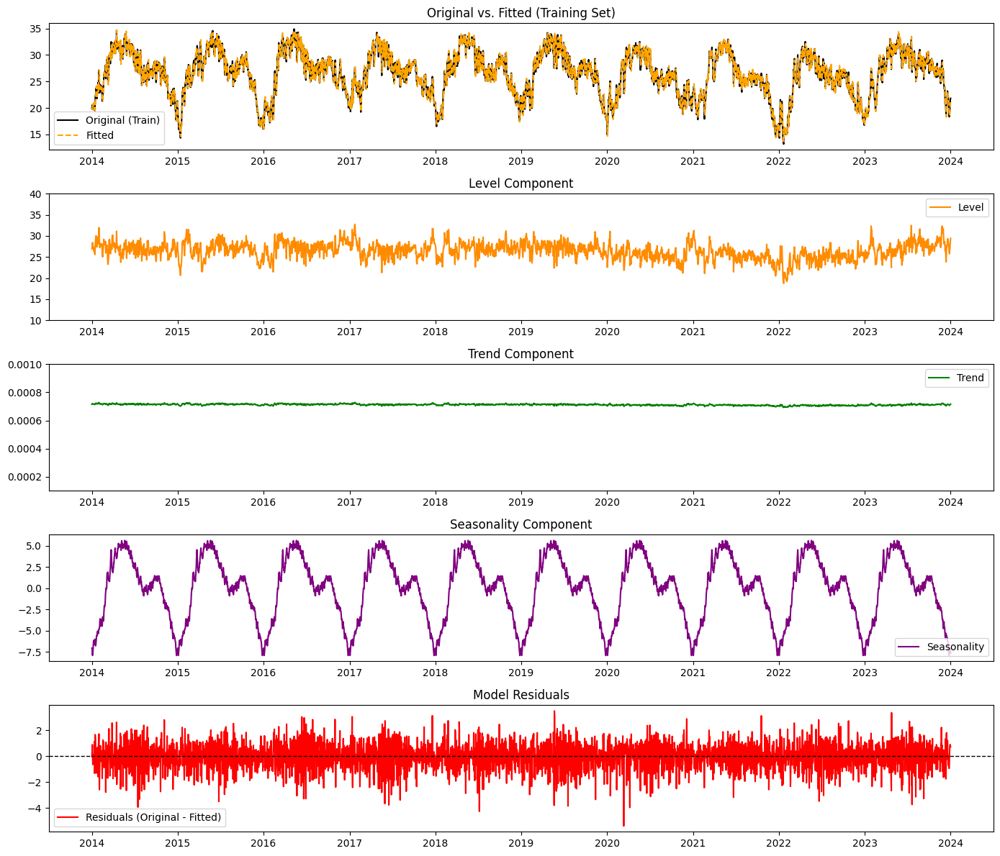

In [25]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
import numpy as np

# Train-test split (last 365 days as test set)
train = avg_temp_series[:-365]
test = avg_temp_series[-365:]

# Fit Holt-Winters model on training data
hw_model_eval = ExponentialSmoothing(
    train,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

# Forecast using Holt-Winters
test_pred_hw = hw_model_eval.forecast(365)


# Benchmark: Naive Forecast (each prediction = previous day's value)
test_pred_naive = test.shift(1)

# For the first day, use the last value from training
test_pred_naive.iloc[0] = train.iloc[-1]




# Extract components
level = hw_model_eval.level
trend = hw_model_eval.trend
season = hw_model_eval.season
fitted = hw_model_eval.fittedvalues

# Compute residuals (train set only)
residuals = train - fitted

# Plot all components
plt.figure(figsize=(14, 12))

# Original vs. Fitted
plt.subplot(5, 1, 1)
plt.plot(train, label="Original (Train)", color="black")
plt.plot(fitted, label="Fitted", linestyle="--", color="orange")
plt.title("Original vs. Fitted (Training Set)")
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label="Level", color="darkorange")
plt.ylim(10,40)
plt.title("Level Component")
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label="Trend", color="green")
plt.ylim(0.0001,0.001)
plt.title("Trend Component")
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label="Seasonality", color="purple")
plt.title("Seasonality Component")
plt.legend()

# Residuals
plt.subplot(5, 1, 5)
plt.plot(residuals, label="Residuals (Original - Fitted)", color="red")
plt.axhline(0, linestyle="--", color="black", linewidth=1)
plt.title("Model Residuals")
plt.legend()

plt.tight_layout()
plt.show()


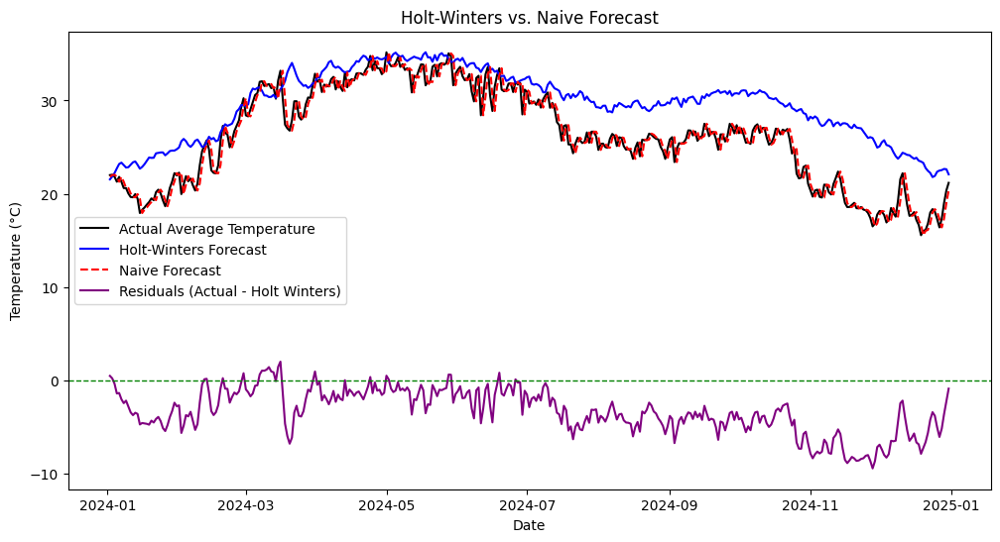

Performance Comparison:
Holt-Winters Annual → MAE: 3.466, RMSE: 4.140, R-Squared: 0.359, sMAPE: 13.624%
Naive Forecast → MAE: 0.768, RMSE: 1.026, R-Squared: 0.961, sMAPE: 2.993%


In [26]:
test_residuals = test - test_pred_hw

# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(test.index, test, label="Actual Average Temperature", color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Forecast", color='blue')
plt.plot(test_pred_naive.index, test_pred_naive, label="Naive Forecast", linestyle="--", color='red')
plt.plot(test_residuals.index, test_residuals, label="Residuals (Actual - Holt Winters)", color='purple')
plt.axhline(0, linestyle="--", color="green", linewidth=1)
plt.title("Holt-Winters vs. Naive Forecast")
plt.xlabel("Date")
plt.ylabel("Temperature (°C)")
plt.legend()
plt.show()

def rmse(y,t):
  return np.sqrt(np.mean((y-t)**2))

# Evaluation: Holt-Winters
mae_hw = mean_absolute_error(test, test_pred_hw)
rmse_hw = rmse(test, test_pred_hw)

# Evaluation: Naive
mae_naive = mean_absolute_error(test, test_pred_naive)
rmse_naive = rmse(test, test_pred_naive)


from sklearn.metrics import r2_score

# R²
r2_hw = r2_score(test, test_pred_hw)
r2_naive = r2_score(test, test_pred_naive)


#sMAPE
import numpy as np

def smape(y_true, y_pred):
    numerator = np.abs(y_true - y_pred)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

hw_annual_smape = smape(test, test_pred_hw)
naive_smape = smape(test, test_pred_naive)

#print(f"Overall sMAPE for Annual Holt-Winters Forecast (2024): {_smape:.2f}%")



# Print comparison
print("Performance Comparison:")
print(f"Holt-Winters Annual → MAE: {mae_hw:.3f}, RMSE: {rmse_hw:.3f}, R-Squared: {r2_hw:.3f}, sMAPE: {hw_annual_smape:.3f}%")
print(f"Naive Forecast → MAE: {mae_naive:.3f}, RMSE: {rmse_naive:.3f}, R-Squared: {r2_naive:.3f}, sMAPE: {naive_smape:.3f}%")


We can see that while the annual forecast broadly captures seasonality well, it is consistently oversestimating the average temperature, especially during the latter half of the year. This suggests that 365 days may be too long a time horizon for getting a reasonably accurate forecast based on univariate time series modelling using Holt Winters Smoothing.

Next, we consider a rolling monthly forecast approach.

### Rolling Forecasts (Every Month) for 2024 - reduces MAE and RSME by 50% ; reduces sMAPE from 14% to 6% ; increases R-Sq from 0.36 to 0.84

In [27]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Select the temperature series and interpolate missing values
temp_series = df['Temperature_at_2_Meters_Average_(C)']


# Define the full range of 2024
forecast_start = '2024-01-01'
forecast_end = '2024-12-31'
forecast_dates = pd.date_range(start=forecast_start, end=forecast_end, freq='D')

# Get initial training data: up to Dec 31, 2023
train_series = temp_series[:'2024-01-01']

In [28]:
from datetime import timedelta

# Container to collect forecast results
monthly_forecasts = []

# Define monthly forecast dates for 2024
start_date = pd.to_datetime(forecast_start)
end_date = pd.to_datetime(forecast_end)

# Loop over each month
while start_date <= end_date:
    # Define forecast window: one month
    forecast_window_end = (start_date + pd.DateOffset(months=1)) - timedelta(days=1)
    forecast_dates_month = pd.date_range(start=start_date, end=forecast_window_end, freq='D')

    # Fit Holt-Winters model on available data
    model = ExponentialSmoothing(
        train_series,
        trend='add',
        seasonal='add',
        seasonal_periods=365,
        initialization_method='estimated'
    ).fit()

    # Forecast one month ahead
    forecast = model.forecast(len(forecast_dates_month))
    forecast.name = 'Forecast'
    forecast.index = forecast_dates_month

    # Store forecast
    monthly_forecasts.append(forecast)

    # Update training series with actual observed data from that month (real case)
    # In real use, replace forecast with real 2024 data when available
    actual_observed = temp_series[forecast_dates_month]  # simulate using real 2024 data
    train_series = pd.concat([train_series, actual_observed])

    # Move to the next month
    start_date = forecast_window_end + timedelta(days=1)


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  r

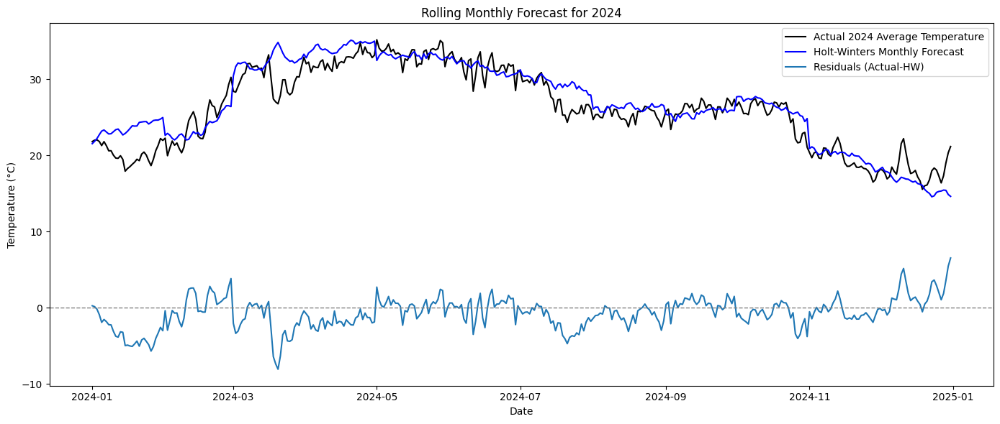

In [29]:
# Combine all forecasts into one series
full_rolling_forecast = pd.concat(monthly_forecasts)

# Extract actual values from 2024
actual_2024 = temp_series['2024-01-01':'2024-12-31']

residuals_monthly = actual_2024 - full_rolling_forecast

# Plot forecast vs actual
plt.figure(figsize=(14, 6))
plt.plot(actual_2024, label='Actual 2024 Average Temperature', color='black')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Forecast', color='blue')
plt.plot(residuals_monthly, label='Residuals (Actual-HW)')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)
plt.title("Rolling Monthly Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("Temperature (°C)")
plt.legend()
plt.tight_layout()
plt.show()

In [30]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

mae_monthly_forecast = mean_absolute_error(actual_2024, full_rolling_forecast)
rmse_monthly_forecast = rmse(actual_2024, full_rolling_forecast)
r2_score_monthly_forecast = r2_score(actual_2024, full_rolling_forecast)

print(f"Rolling Forecast MAE: {mae_monthly_forecast:.3f} °C")
print(f"Rolling Forecast RMSE: {rmse_monthly_forecast:.3f} °C")
print(f"Rolling Forecast R-Squared: {r2_score_monthly_forecast:.3f}")


# Calculate sMAPE for entire 2024
hw_monthly_smape = smape(actual_2024, full_rolling_forecast)

print(f"Overall sMAPE for Rolling Holt-Winters Forecast (2024): {hw_monthly_smape:.2f}%")

Rolling Forecast MAE: 1.592 °C
Rolling Forecast RMSE: 2.121 °C
Rolling Forecast R-Squared: 0.832
Overall sMAPE for Rolling Holt-Winters Forecast (2024): 6.41%


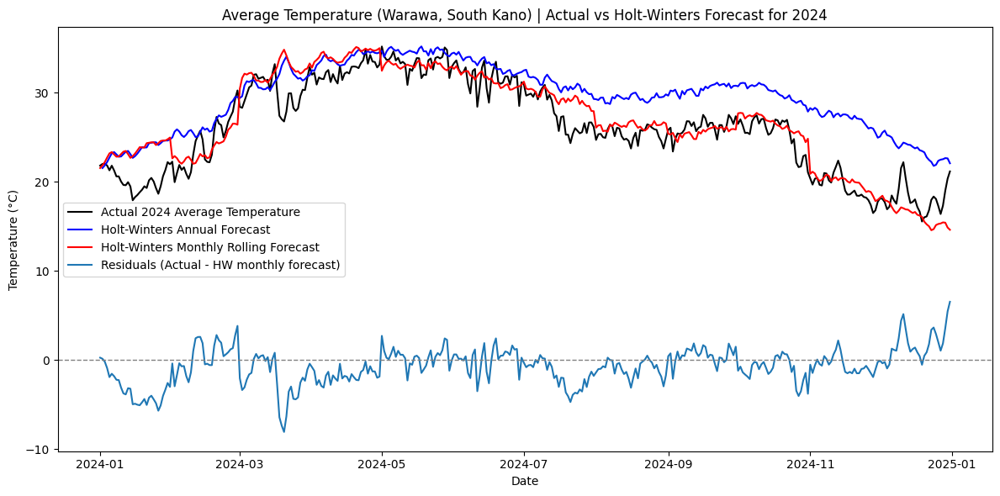

,HW Annual Forecast,| Naive Forecast (benchmark),| HW Monthly Rolling Forecast
Metric,,,
MAE,3.465519,0.768301,1.592375
RMSE,4.140470,1.026233,2.120721
R-squared (>0.8 is good),0.359127,0.960630,0.831740
sMAPE % (<10% is good),13.624347,2.993004,6.406998


In [31]:
# COMPARISON CHART AND EVALUATION TABLE


# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(actual_2024, label='Actual 2024 Average Temperature', color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Annual Forecast", color='blue')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Rolling Forecast', color='red')
plt.plot(residuals_monthly, label='Residuals (Actual - HW monthly forecast)')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)

plt.title("Average Temperature (Warawa, South Kano) | Actual vs Holt-Winters Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("Temperature (°C)")
plt.legend()
plt.tight_layout()
plt.show()




# table for mae_hw, rmse_hw, mae_naive, rmse_naive, mae_monthly_forecast, rmse_monthly_forecast, r2_hw, r2_naive, r2_score_monthly_forecast

import pandas as pd
# Create a dictionary to store the evaluation metrics
data = {
    'Metric': ['MAE', 'RMSE', 'R-squared (>0.8 is good)', 'sMAPE % (<10% is good)'],
    'HW Annual Forecast': [mae_hw, rmse_hw, r2_hw, hw_annual_smape],
    '| Naive Forecast (benchmark)': [mae_naive, rmse_naive, r2_naive, naive_smape],
    '| HW Monthly Rolling Forecast': [mae_monthly_forecast, rmse_monthly_forecast, r2_score_monthly_forecast, hw_monthly_smape]
}

# Create the DataFrame
evaluation_df = pd.DataFrame(data)

# Set 'Metric' column as index
evaluation_df = evaluation_df.set_index('Metric')

# Display the DataFrame
evaluation_df

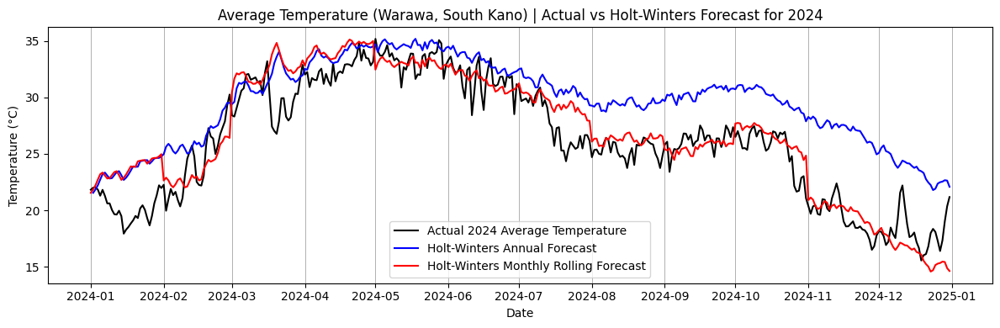

In [32]:
# actual_2024, test_pred_hw, full_rolling_forecast with vertical gridlines at the start of each month

import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Assuming actual_2024, test_pred_hw, and full_rolling_forecast are defined as in the provided code

plt.figure(figsize=(12, 4))
plt.plot(actual_2024, label='Actual 2024 Average Temperature', color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Annual Forecast", color='blue')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Rolling Forecast', color='red')

# Customize the x-axis to show month starts
plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
plt.grid(axis='x', which='major', linewidth=0.7)


plt.title("Average Temperature (Warawa, South Kano) | Actual vs Holt-Winters Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("Temperature (°C)")
plt.legend()
plt.tight_layout()
plt.show()


 So we can see that while the annual forecast does a resonably good job of capturing the seasonality and overall movement of the average temperature, it consistently overestimates the average temperature. The monthly rolling forecast helps remedy this by updating the level component at the beginning of each month which helps predict the avg temperature more accurately.

# 2) Maximum Temperature Time Series Analysis

## A) Holt Winters

###Modelling

In [33]:
vars_of_int

['Temperature_at_2_Meters_Average_(C)',
 'Temperature_at_2_Meters_Maximum_(C)',
 'Temperature_at_2_Meters_Minimum_(C)',
 'Relative_Humidity_at_2_Meters_(%)',
 'Precipitation_Corrected_(mm/day)',
 'Wind_Speed_at_2_Meters_Average_(m/s)',
 'Wind_Speed_at_2_Meters_Maximum_(m/s)',
 'Wind_Speed_at_2_Meters_Minimum_(m/s)',
 'Wind_Direction_at_2_Meters_(Degrees)',
 'Surface_Soil_Wetness_(1)',
 'Root_Zone_Soil_Wetness_(1)',
 'Profile_Soil_Moisture_(1)']

Preprocessing and Visual Inspection

In [34]:
#Imports

import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Select temperature column
max_temp_series = df['Temperature_at_2_Meters_Maximum_(C)']

max_temp_series

,Temperature_at_2_Meters_Maximum_(C)
Date,
2014-01-01,31.58
2014-01-02,29.80
2014-01-03,30.12
2014-01-04,30.72
2014-01-05,29.41
...,...
2024-12-27,27.71
2024-12-28,29.54
2024-12-29,29.99


In [35]:
#check missing values

max_temp_series.isna().sum()

np.int64(0)

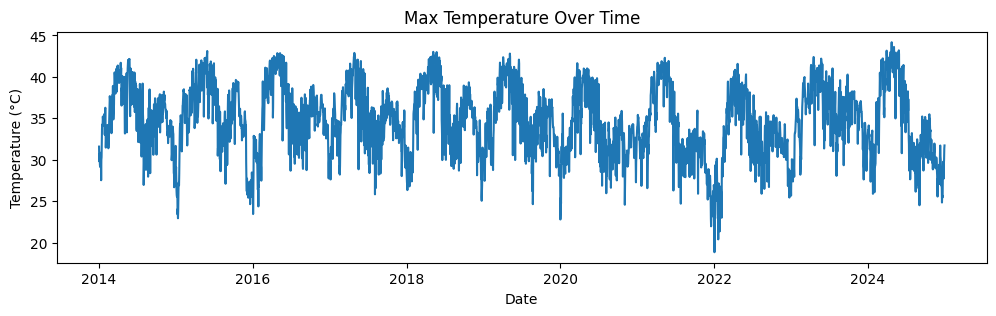

In [36]:
# Plot to check trend & seasonality
plt.figure(figsize=(12, 3))
plt.plot(max_temp_series)
plt.title("Max Temperature Over Time")
plt.ylabel("Temperature (°C)")
plt.xlabel("Date")
plt.show()

Model Fitting

In [37]:
#FITTING THE MODEL

# Seasonality length: 365 for daily data with yearly seasonality
season_length = 365

# Fit Holt-Winters additive model (trend + seasonality)
hw_model_max_temp = ExponentialSmoothing(
    max_temp_series,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

# Forecast next 365 days
#forecast = hw_model_max_temp.forecast(365)

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


Inspecting Level, Trend, Seasonal Components and Residuals

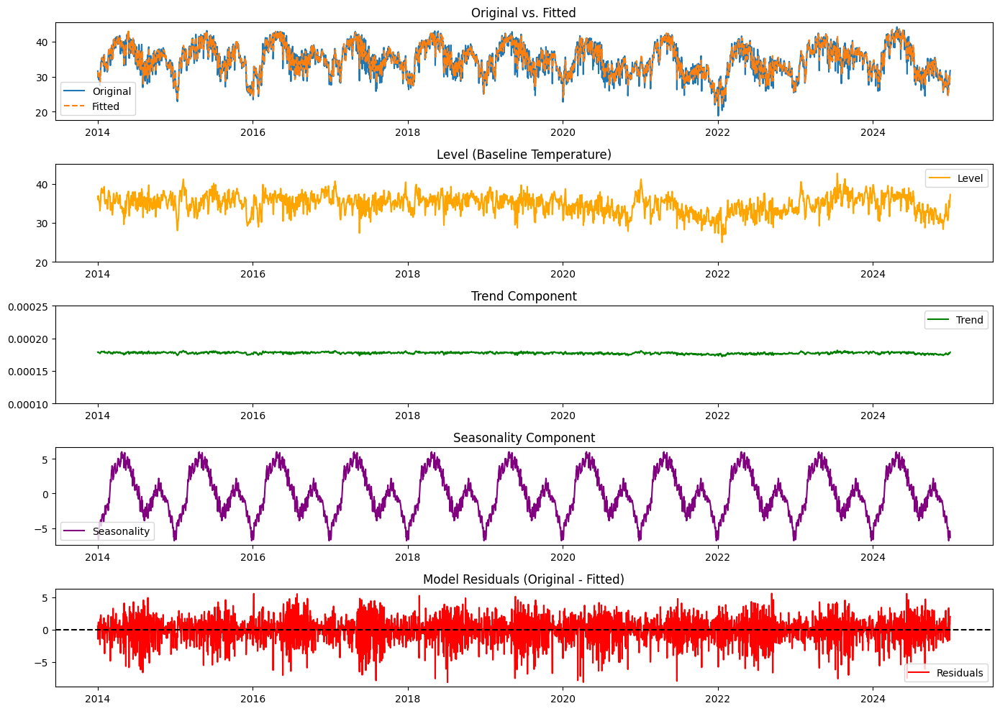

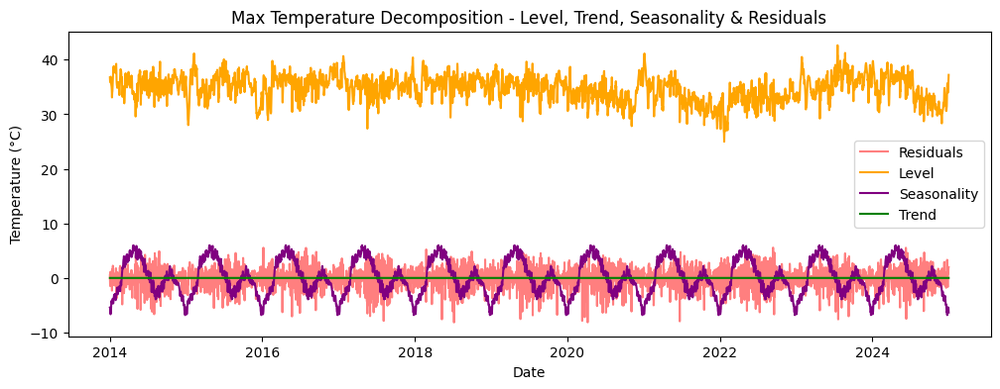

In [38]:
residuals = max_temp_series - hw_model_max_temp.fittedvalues

#PLOTTING TREND LEVEL AND SEASONALITY

import matplotlib.pyplot as plt

# Get components
level = hw_model_max_temp.level
trend = hw_model_max_temp.trend
season = hw_model_max_temp.season
fitted = hw_model_max_temp.fittedvalues

# Create subplots
plt.figure(figsize=(14, 10))

# Original series and fitted values
plt.subplot(5, 1, 1)
plt.plot(max_temp_series, label='Original')
plt.plot(fitted, label='Fitted', linestyle='--')
plt.title('Original vs. Fitted')
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label='Level', color='orange')
plt.ylim(20,45)
plt.title('Level (Baseline Temperature)')
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label='Trend', color='green')
plt.title('Trend Component')
plt.ylim(0.0001,0.00025)
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label='Seasonality', color='purple')
plt.title('Seasonality Component')
plt.legend()

#R Residuals

plt.subplot(5,1,5)
plt.plot(residuals, label='Residuals', color='red')
plt.title('Model Residuals (Original - Fitted)')
plt.axhline(0, color='black', linestyle='--')
plt.legend()

'''
plt.figure(figsize=(12, 4))
plt.plot(residuals)
plt.title("Model Residuals (Original - Fitted)")
plt.axhline(0, color='black', linestyle='--')
plt.show()
'''

plt.tight_layout()
plt.show()




#plotting all-in-one

plt.figure(figsize=(12, 4))
#plt.plot(fitted, label='Fitted')
plt.plot(residuals, label='Residuals', color='red', alpha = 0.5)
plt.plot(level, label='Level', color='orange')
plt.plot(season, label='Seasonality', color='purple')
plt.plot(trend, label='Trend', color='green')

plt.legend()
plt.title("Max Temperature Decomposition - Level, Trend, Seasonality & Residuals")
plt.ylabel("Temperature (°C)")
plt.xlabel("Date")
plt.show()


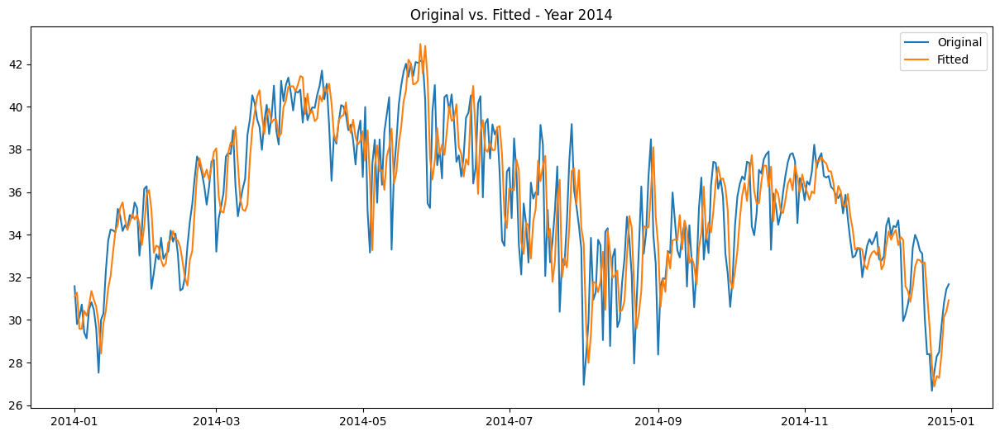

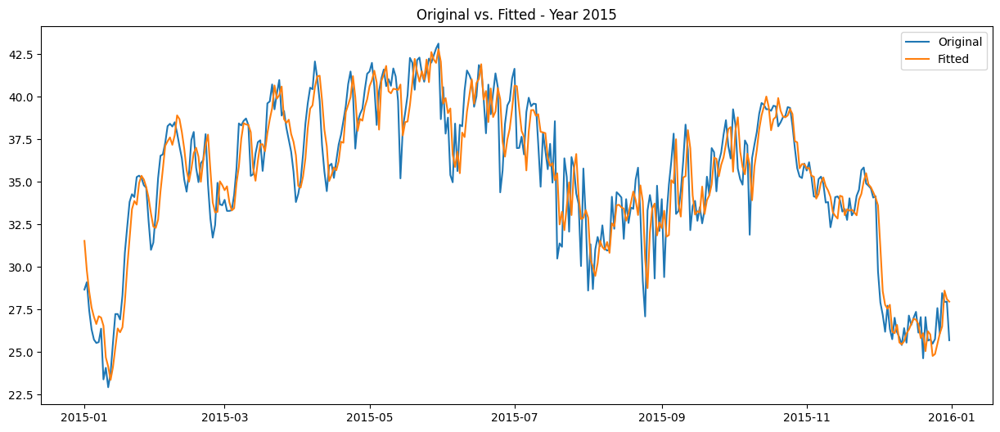

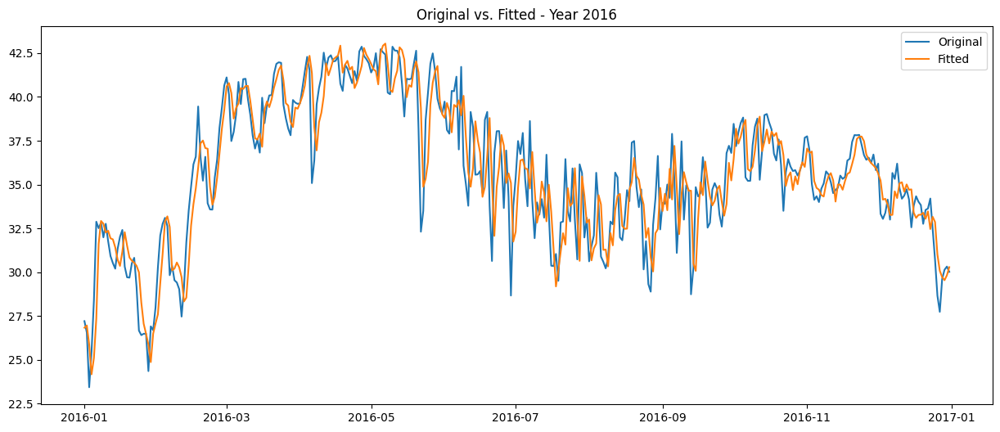

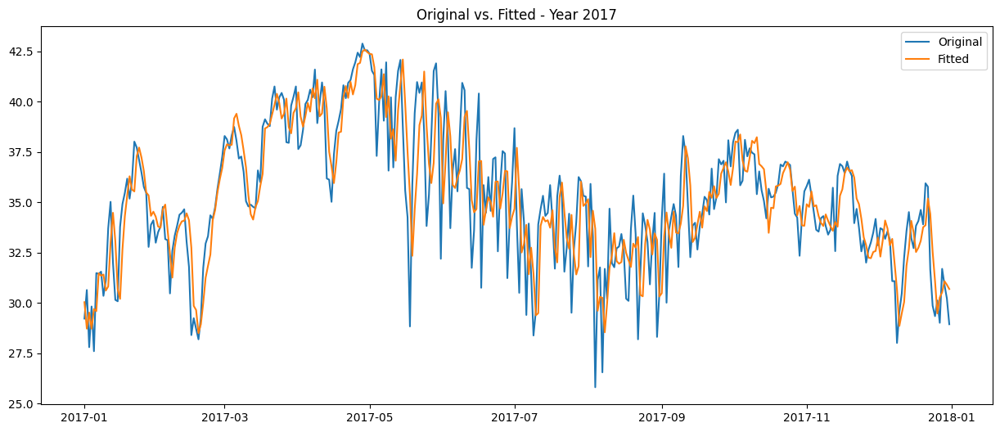

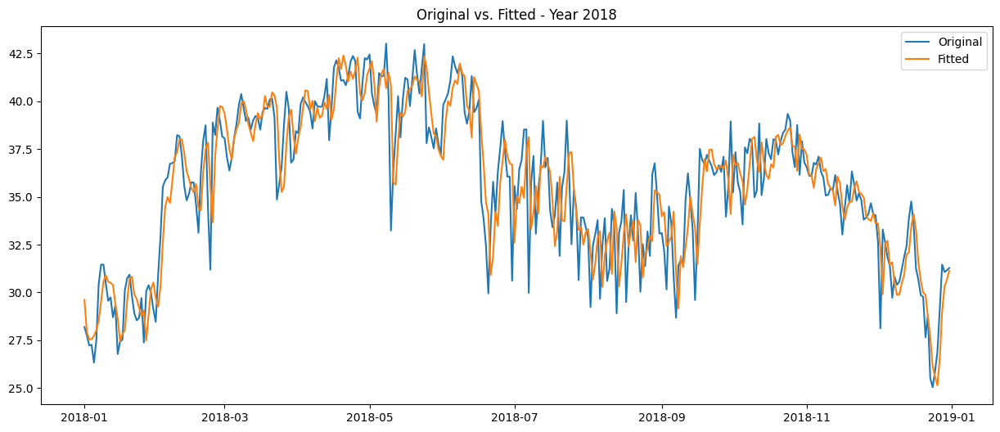

...

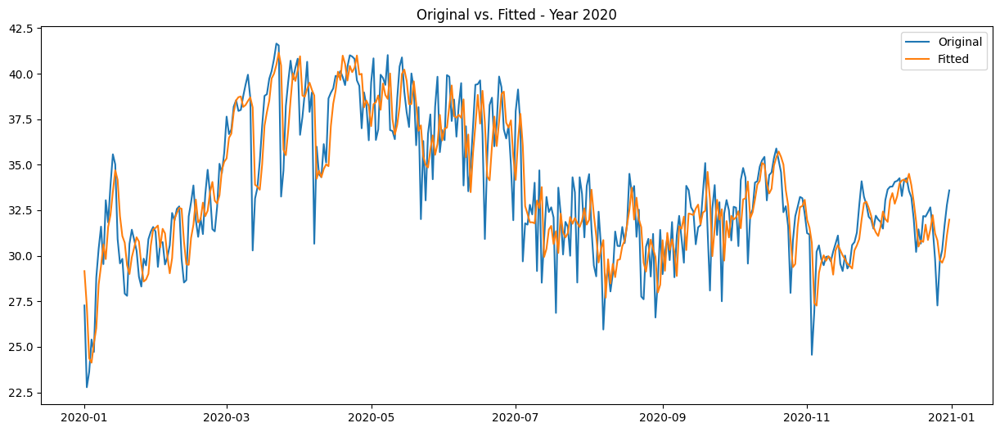

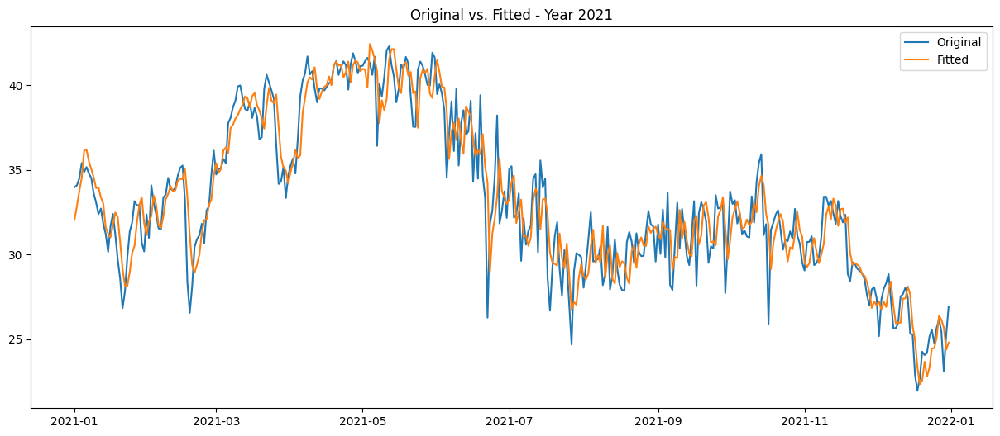

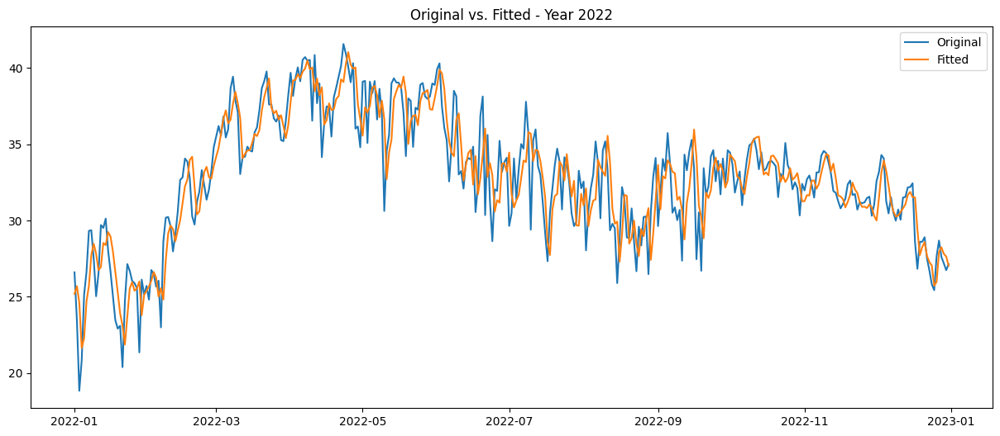

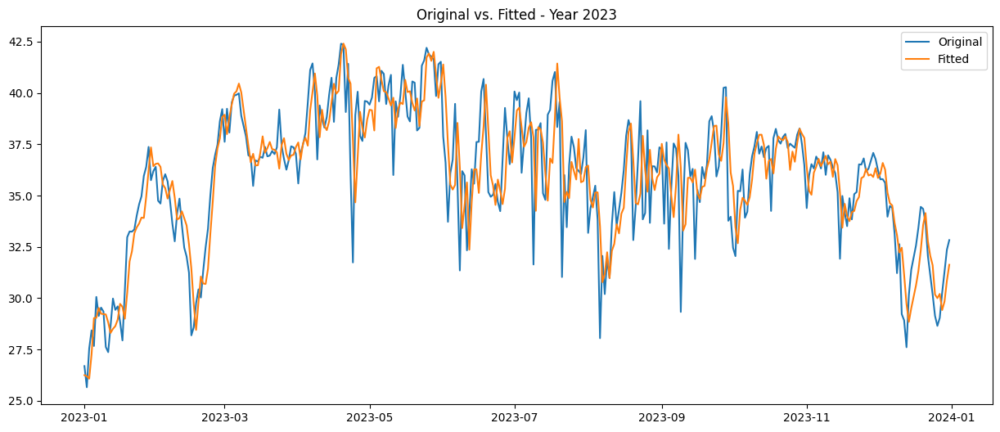

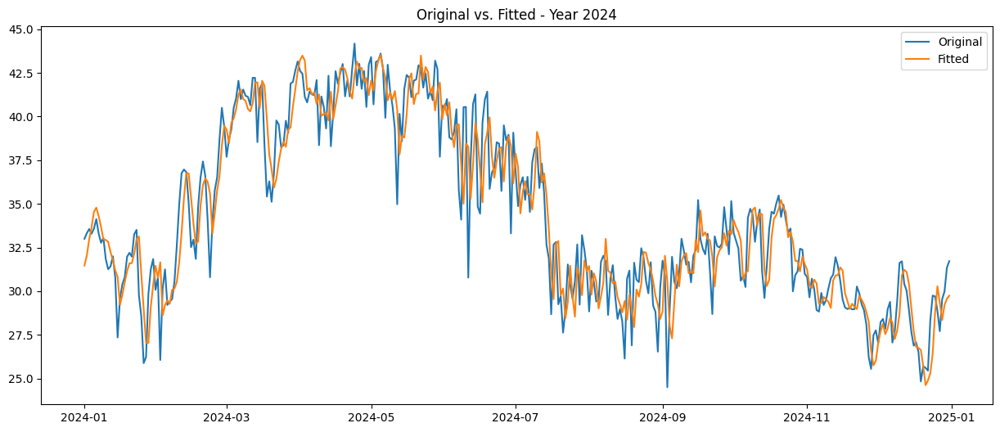

In [39]:
# temp_series vs fitted for each individual year

import pandas as pd
import matplotlib.pyplot as plt


# Convert the index to datetime objects if it's not already
df.index = pd.to_datetime(df.index)

# Group the data by year
for year, year_data in df.groupby(df.index.year):
    temp_series_year = year_data['Temperature_at_2_Meters_Maximum_(C)']
    fitted_year = hw_model_max_temp.fittedvalues[year_data.index]

    plt.figure(figsize=(15, 6))
    plt.plot(temp_series_year, label='Original')
    plt.plot(fitted_year, label='Fitted')
    plt.title(f'Original vs. Fitted - Year {year}')
    plt.legend()
    plt.show()

###2025 Forecast

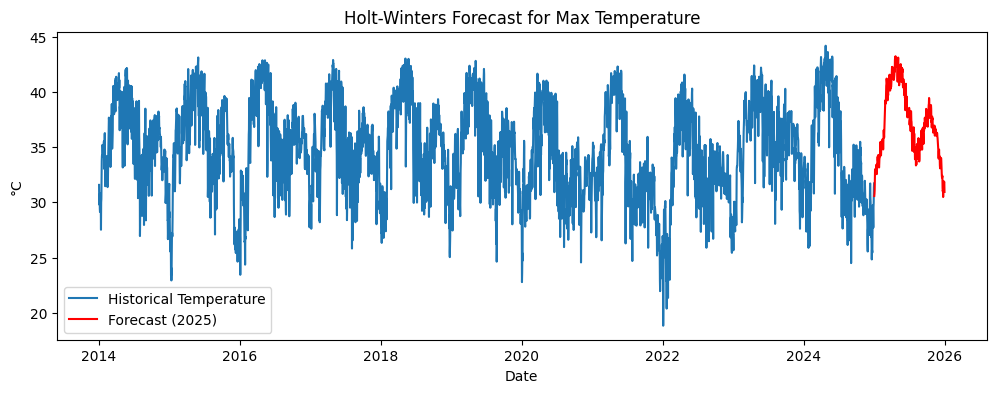

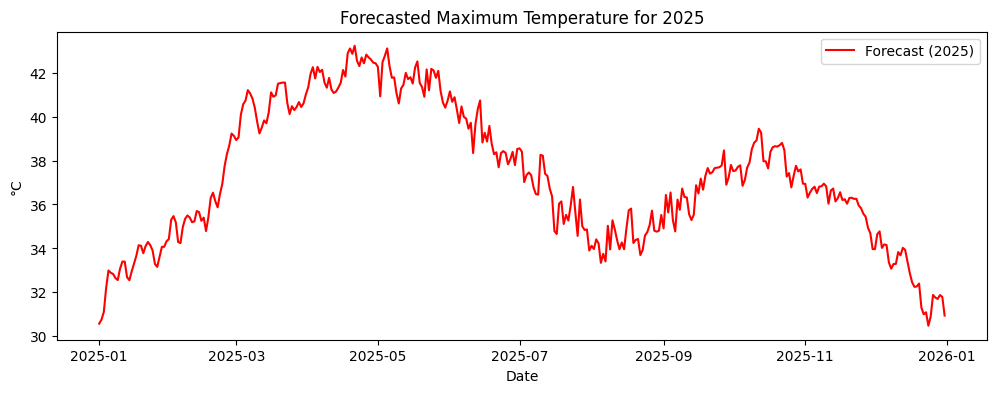

In [40]:
# Forecast next 365 days
forecast_max_temp = hw_model_max_temp.forecast(365)

#visualise all years
plt.figure(figsize=(12, 4))
plt.plot(max_temp_series, label="Historical Temperature")
plt.plot(forecast_max_temp.index, forecast_max_temp, label="Forecast (2025)", color='red')
plt.title("Holt-Winters Forecast for Max Temperature")
plt.xlabel("Date")
plt.ylabel("°C")
plt.legend()
plt.show()

#visualise forecast
plt.figure(figsize=(12, 4))
plt.plot(forecast_max_temp.index, forecast_max_temp, label="Forecast (2025)", color='red')
plt.title("Forecasted Maximum Temperature for 2025")
plt.xlabel("Date")
plt.ylabel("°C")
plt.legend()
plt.show()

### Model Evaluation (Train: 2014-2023, Test: 2024)

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


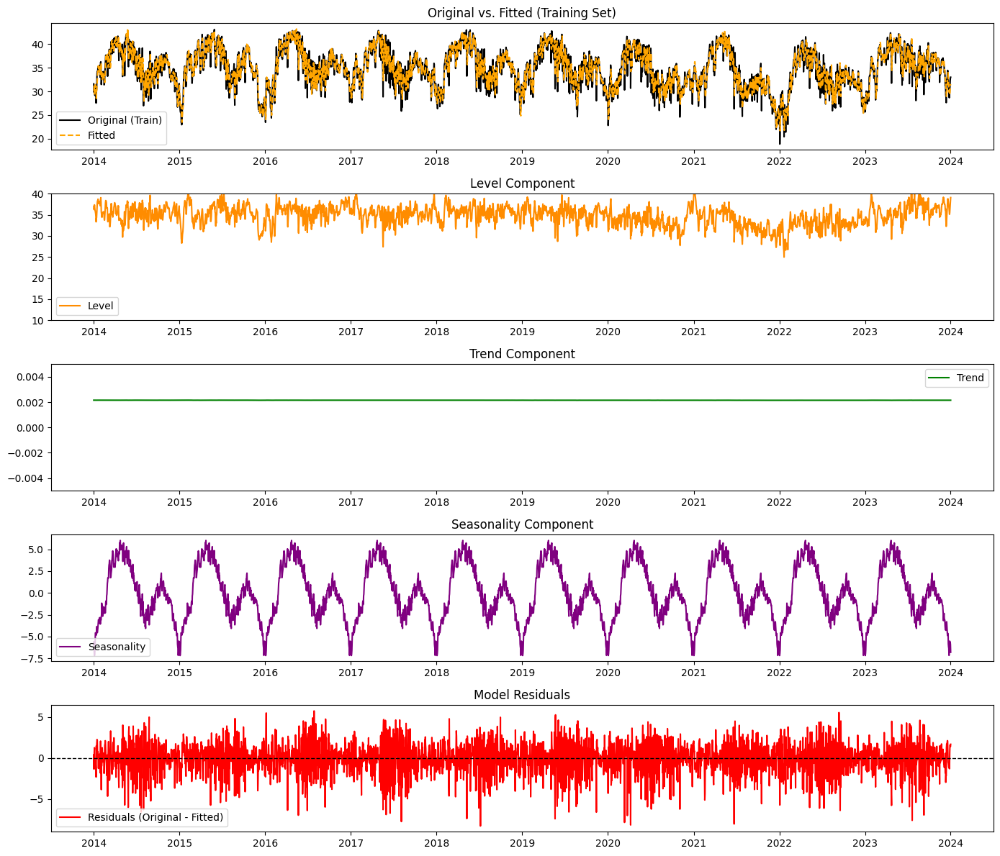

In [41]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
import numpy as np

# Train-test split (last 365 days as test set)
train = max_temp_series[:-365]
test = max_temp_series[-365:]

# Fit Holt-Winters model on training data
hw_model_eval = ExponentialSmoothing(
    train,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

# Forecast using Holt-Winters
test_pred_hw = hw_model_eval.forecast(365)


# Benchmark: Naive Forecast (each prediction = previous day's value)
test_pred_naive = test.shift(1)

# For the first day, use the last value from training
test_pred_naive.iloc[0] = train.iloc[-1]




# Extract components
level = hw_model_eval.level
trend = hw_model_eval.trend
season = hw_model_eval.season
fitted = hw_model_eval.fittedvalues

# Compute residuals (train set only)
residuals = train - fitted

# Plot all components
plt.figure(figsize=(14, 12))

# Original vs. Fitted
plt.subplot(5, 1, 1)
plt.plot(train, label="Original (Train)", color="black")
plt.plot(fitted, label="Fitted", linestyle="--", color="orange")
plt.title("Original vs. Fitted (Training Set)")
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label="Level", color="darkorange")
plt.ylim(10,40)
plt.title("Level Component")
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label="Trend", color="green")
plt.ylim(-0.005,0.005)
plt.title("Trend Component")
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label="Seasonality", color="purple")
plt.title("Seasonality Component")
plt.legend()

# Residuals
plt.subplot(5, 1, 5)
plt.plot(residuals, label="Residuals (Original - Fitted)", color="red")
plt.axhline(0, linestyle="--", color="black", linewidth=1)
plt.title("Model Residuals")
plt.legend()

plt.tight_layout()
plt.show()


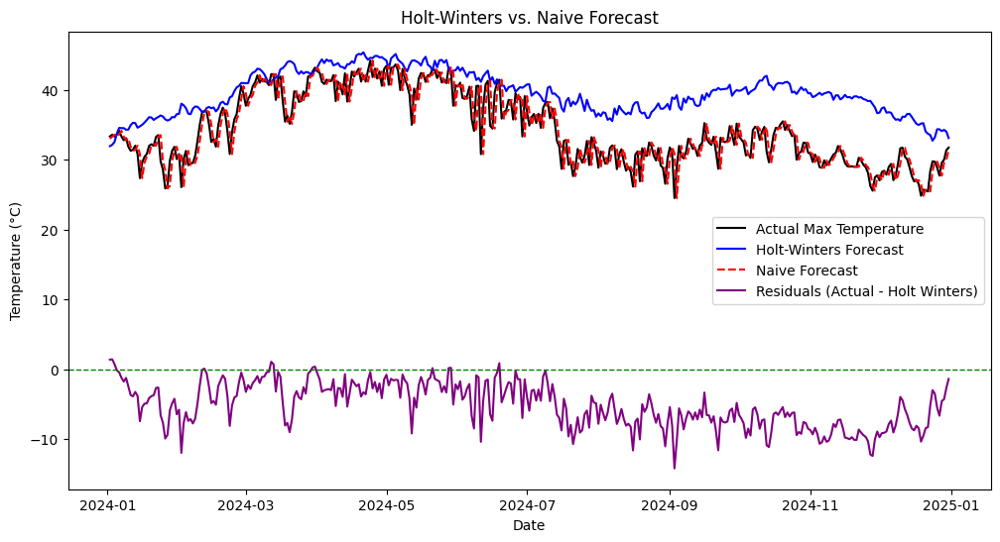

Performance Comparison:
Holt-Winters Annual → MAE: 5.210, RMSE: 6.067, R-Squared: -0.457, sMAPE: 14.831%
Naive Forecast → MAE: 1.467, RMSE: 2.016, R-Squared: 0.839, sMAPE: 4.355%


In [42]:
test_residuals = test - test_pred_hw

# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(test.index, test, label="Actual Max Temperature", color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Forecast", color='blue')
plt.plot(test_pred_naive.index, test_pred_naive, label="Naive Forecast", linestyle="--", color='red')
plt.plot(test_residuals.index, test_residuals, label="Residuals (Actual - Holt Winters)", color='purple')
plt.axhline(0, linestyle="--", color="green", linewidth=1)
plt.title("Holt-Winters vs. Naive Forecast")
plt.xlabel("Date")
plt.ylabel("Temperature (°C)")
plt.legend()
plt.show()

def rmse(y,t):
  return np.sqrt(np.mean((y-t)**2))

# Evaluation: Holt-Winters
mae_hw = mean_absolute_error(test, test_pred_hw)
rmse_hw = rmse(test, test_pred_hw)

# Evaluation: Naive
mae_naive = mean_absolute_error(test, test_pred_naive)
rmse_naive = rmse(test, test_pred_naive)


from sklearn.metrics import r2_score

# R²
r2_hw = r2_score(test, test_pred_hw)
r2_naive = r2_score(test, test_pred_naive)


#sMAPE
import numpy as np

def smape(y_true, y_pred):
    numerator = np.abs(y_true - y_pred)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

hw_annual_smape = smape(test, test_pred_hw)
naive_smape = smape(test, test_pred_naive)

#print(f"Overall sMAPE for Annual Holt-Winters Forecast (2024): {_smape:.2f}%")



# Print comparison
print("Performance Comparison:")
print(f"Holt-Winters Annual → MAE: {mae_hw:.3f}, RMSE: {rmse_hw:.3f}, R-Squared: {r2_hw:.3f}, sMAPE: {hw_annual_smape:.3f}%")
print(f"Naive Forecast → MAE: {mae_naive:.3f}, RMSE: {rmse_naive:.3f}, R-Squared: {r2_naive:.3f}, sMAPE: {naive_smape:.3f}%")


We can see that while the annual forecast broadly captures seasonality well, it is consistently oversestimating the max temperature, especially during the latter half of the year. This suggests that 365 days may be too long a time horizon for getting a reasonably accurate forecast based on univariate time series modelling using Holt Winters Smoothing.

Next, we consider a rolling monthly forecast approach.

### Rolling Forecasts (Every Month) for 2024 - reduces MAE and RSME by 50% ; reduces sMAPE from 15% to 7% ; increases R-Sq from -0.4 to to 0.65

In [43]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Select the temperature series and interpolate missing values
temp_series = df['Temperature_at_2_Meters_Maximum_(C)']


# Define the full range of 2024
forecast_start = '2024-01-01'
forecast_end = '2024-12-31'
forecast_dates = pd.date_range(start=forecast_start, end=forecast_end, freq='D')

# Get initial training data: up to Dec 31, 2023
train_series = temp_series[:'2024-01-01']

In [44]:
from datetime import timedelta

# Container to collect forecast results
monthly_forecasts = []

# Define monthly forecast dates for 2024
start_date = pd.to_datetime(forecast_start)
end_date = pd.to_datetime(forecast_end)

# Loop over each month
while start_date <= end_date:
    # Define forecast window: one month
    forecast_window_end = (start_date + pd.DateOffset(months=1)) - timedelta(days=1)
    forecast_dates_month = pd.date_range(start=start_date, end=forecast_window_end, freq='D')

    # Fit Holt-Winters model on available data
    model = ExponentialSmoothing(
        train_series,
        trend='add',
        seasonal='add',
        seasonal_periods=365,
        initialization_method='estimated'
    ).fit()

    # Forecast one month ahead
    forecast = model.forecast(len(forecast_dates_month))
    forecast.name = 'Forecast'
    forecast.index = forecast_dates_month

    # Store forecast
    monthly_forecasts.append(forecast)

    # Update training series with actual observed data from that month (real case)
    # In real use, replace forecast with real 2024 data when available
    actual_observed = temp_series[forecast_dates_month]  # simulate using real 2024 data
    train_series = pd.concat([train_series, actual_observed])

    # Move to the next month
    start_date = forecast_window_end + timedelta(days=1)


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/usr/local/lib/python3.11/dist-packages/statsmode

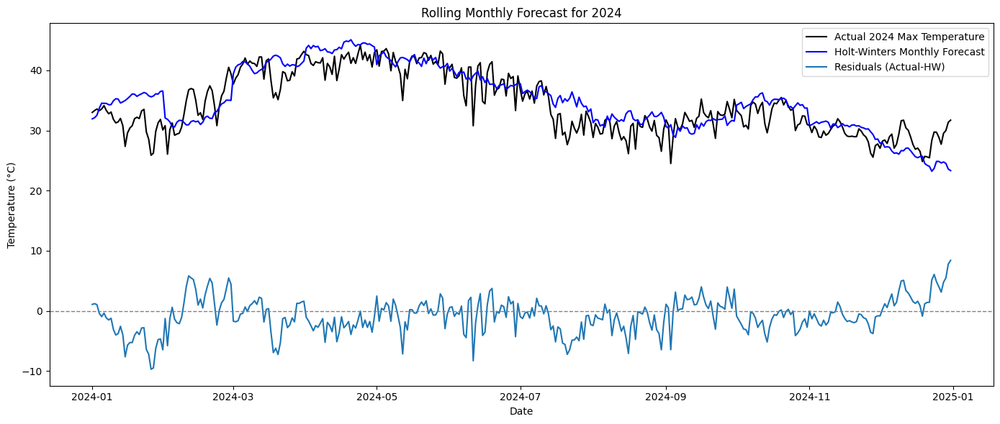

In [45]:
# Combine all forecasts into one series
full_rolling_forecast = pd.concat(monthly_forecasts)

# Extract actual values from 2024
actual_2024 = temp_series['2024-01-01':'2024-12-31']

residuals_monthly = actual_2024 - full_rolling_forecast

# Plot forecast vs actual
plt.figure(figsize=(14, 6))
plt.plot(actual_2024, label='Actual 2024 Max Temperature', color='black')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Forecast', color='blue')
plt.plot(residuals_monthly, label='Residuals (Actual-HW)')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)
plt.title("Rolling Monthly Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("Temperature (°C)")
plt.legend()
plt.tight_layout()
plt.show()

In [46]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

mae_monthly_forecast = mean_absolute_error(actual_2024, full_rolling_forecast)
rmse_monthly_forecast = rmse(actual_2024, full_rolling_forecast)
r2_score_monthly_forecast = r2_score(actual_2024, full_rolling_forecast)

print(f"Rolling Forecast MAE: {mae_monthly_forecast:.3f} °C")
print(f"Rolling Forecast RMSE: {rmse_monthly_forecast:.3f} °C")
print(f"Rolling Forecast R-Squared: {r2_score_monthly_forecast:.3f}")


# Calculate sMAPE for entire 2024
hw_monthly_smape = smape(actual_2024, full_rolling_forecast)

print(f"Overall sMAPE for Rolling Holt-Winters Forecast (2024): {hw_monthly_smape:.2f}%")

Rolling Forecast MAE: 2.277 °C
Rolling Forecast RMSE: 2.956 °C
Rolling Forecast R-Squared: 0.653
Overall sMAPE for Rolling Holt-Winters Forecast (2024): 6.81%


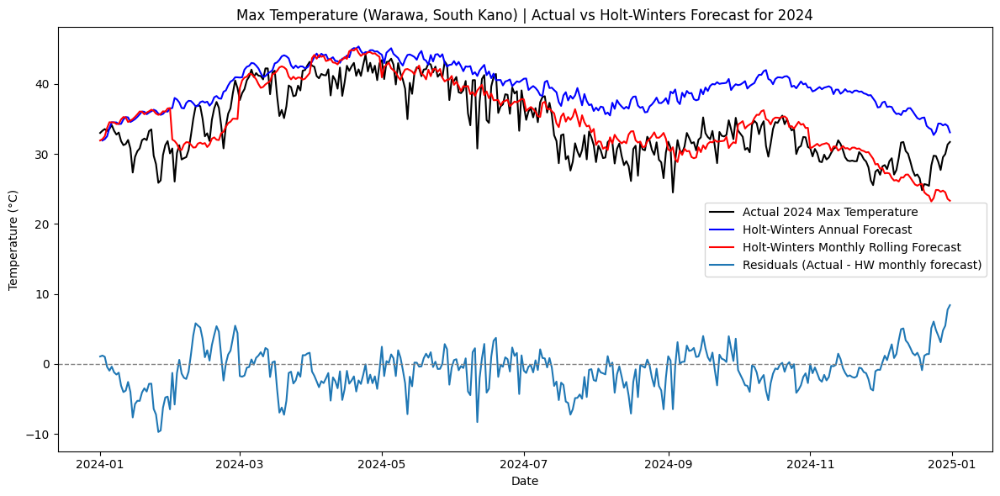

,HW Annual Forecast,| Naive Forecast (benchmark),| HW Monthly Rolling Forecast
Metric,,,
MAE,5.209810,1.467068,2.277129
RMSE,6.066942,2.016493,2.955840
R-squared (>0.8 is good),-0.456742,0.839070,0.653335
sMAPE % (<10% is good),14.831118,4.354550,6.810551


In [47]:
# COMPARISON CHART AND EVALUATION TABLE


# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(actual_2024, label='Actual 2024 Max Temperature', color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Annual Forecast", color='blue')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Rolling Forecast', color='red')
plt.plot(residuals_monthly, label='Residuals (Actual - HW monthly forecast)')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)

plt.title("Max Temperature (Warawa, South Kano) | Actual vs Holt-Winters Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("Temperature (°C)")
plt.legend()
plt.tight_layout()
plt.show()




# table for mae_hw, rmse_hw, mae_naive, rmse_naive, mae_monthly_forecast, rmse_monthly_forecast, r2_hw, r2_naive, r2_score_monthly_forecast

import pandas as pd
# Create a dictionary to store the evaluation metrics
data = {
    'Metric': ['MAE', 'RMSE', 'R-squared (>0.8 is good)', 'sMAPE % (<10% is good)'],
    'HW Annual Forecast': [mae_hw, rmse_hw, r2_hw, hw_annual_smape],
    '| Naive Forecast (benchmark)': [mae_naive, rmse_naive, r2_naive, naive_smape],
    '| HW Monthly Rolling Forecast': [mae_monthly_forecast, rmse_monthly_forecast, r2_score_monthly_forecast, hw_monthly_smape]
}

# Create the DataFrame
evaluation_df = pd.DataFrame(data)

# Set 'Metric' column as index
evaluation_df = evaluation_df.set_index('Metric')

# Display the DataFrame
evaluation_df

 So we can see that while the annual forecast does a resonably good job of capturing the seasonality and overall movement of the maximum temperature, it consistently overestimates the max temperature. The monthly rolling forecast helps remedy this by updating the level component at the beginning of each month which helps predict the max temperature more accurately.

# 3) Surface Soil Wetness Time Series Analysis

## A) Holt Winters

###Modelling

In [48]:
vars_of_int

['Temperature_at_2_Meters_Average_(C)',
 'Temperature_at_2_Meters_Maximum_(C)',
 'Temperature_at_2_Meters_Minimum_(C)',
 'Relative_Humidity_at_2_Meters_(%)',
 'Precipitation_Corrected_(mm/day)',
 'Wind_Speed_at_2_Meters_Average_(m/s)',
 'Wind_Speed_at_2_Meters_Maximum_(m/s)',
 'Wind_Speed_at_2_Meters_Minimum_(m/s)',
 'Wind_Direction_at_2_Meters_(Degrees)',
 'Surface_Soil_Wetness_(1)',
 'Root_Zone_Soil_Wetness_(1)',
 'Profile_Soil_Moisture_(1)']

Preprocessing and Visual Inspection

In [49]:
#Imports

import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Select surface soil wetness column
surf_soilmois_series = df['Surface_Soil_Wetness_(1)']


surf_soilmois_series

,Surface_Soil_Wetness_(1)
Date,
2014-01-01,0.19
2014-01-02,0.19
2014-01-03,0.18
2014-01-04,0.18
2014-01-05,0.18
...,...
2024-12-27,0.32
2024-12-28,0.32
2024-12-29,0.31


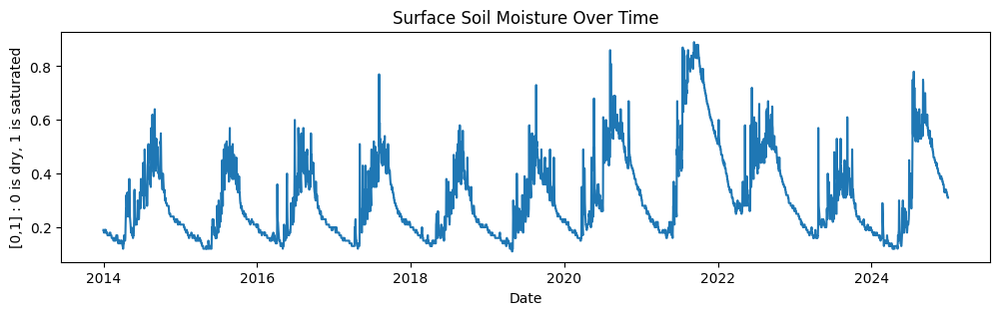

In [50]:
# Plot to check trend & seasonality
plt.figure(figsize=(12, 3))
plt.plot(surf_soilmois_series)
plt.title("Surface Soil Moisture Over Time")
plt.ylabel("[0,1] : 0 is dry, 1 is saturated")
plt.xlabel("Date")
plt.show()

In [51]:
#check missing values
print(surf_soilmois_series.isna().sum())

0


Model Fitting

In [52]:
#FITTING THE MODEL

# Seasonality length: 365 for daily data with yearly seasonality
season_length = 365

# Fit Holt-Winters additive model (trend + seasonality)
hw_model_surf_mois = ExponentialSmoothing(
    surf_soilmois_series,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Inspecting Level, Trend, Seasonal Components and Residuals

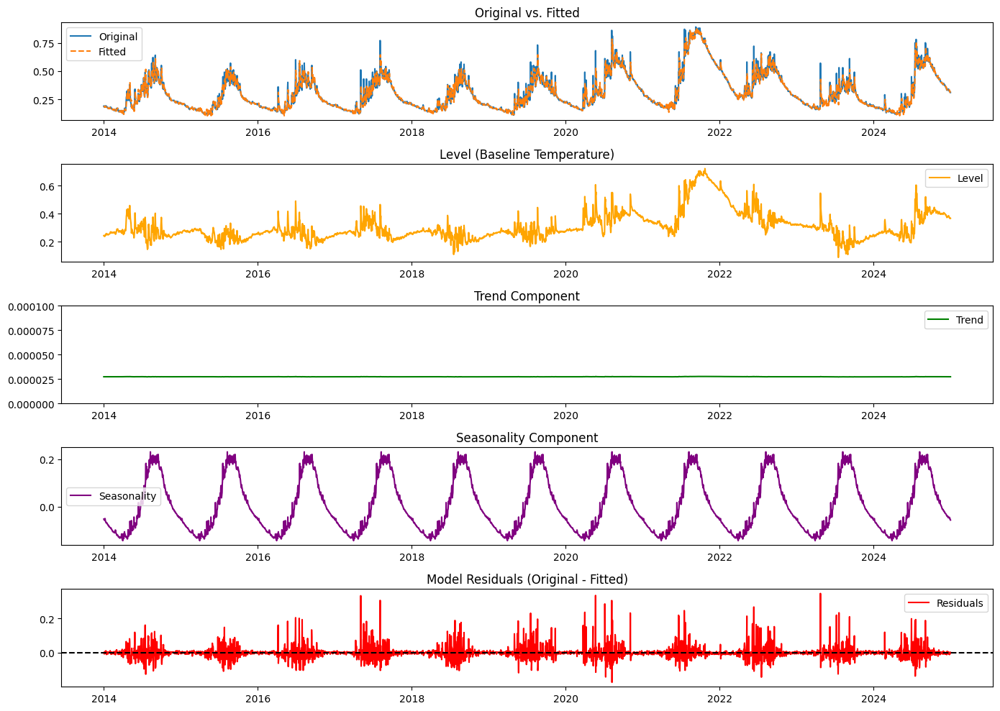

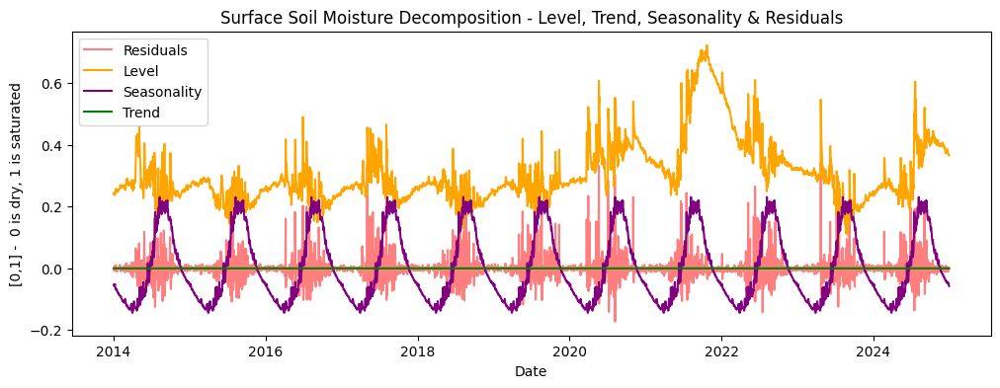

In [53]:
residuals = surf_soilmois_series - hw_model_surf_mois.fittedvalues

#PLOTTING TREND LEVEL AND SEASONALITY

import matplotlib.pyplot as plt

# Get components
level = hw_model_surf_mois.level
trend = hw_model_surf_mois.trend
season = hw_model_surf_mois.season
fitted = hw_model_surf_mois.fittedvalues

# Create subplots
plt.figure(figsize=(14, 10))

# Original series and fitted values
plt.subplot(5, 1, 1)
plt.plot(surf_soilmois_series, label='Original')
plt.plot(fitted, label='Fitted', linestyle='--')
plt.title('Original vs. Fitted')
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label='Level', color='orange')
plt.title('Level (Baseline Temperature)')
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label='Trend', color='green')
plt.title('Trend Component')
plt.ylim(0,0.0001)
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label='Seasonality', color='purple')
plt.title('Seasonality Component')
plt.legend()

#R Residuals

plt.subplot(5,1,5)
plt.plot(residuals, label='Residuals', color='red')
plt.title('Model Residuals (Original - Fitted)')
plt.axhline(0, color='black', linestyle='--')
plt.legend()

'''
plt.figure(figsize=(12, 4))
plt.plot(residuals)
plt.title("Model Residuals (Original - Fitted)")
plt.axhline(0, color='black', linestyle='--')
plt.show()
'''

plt.tight_layout()
plt.show()




#plotting all-in-one

plt.figure(figsize=(12, 4))
#plt.plot(fitted, label='Fitted')
plt.plot(residuals, label='Residuals', color='red', alpha = 0.5)
plt.plot(level, label='Level', color='orange')
plt.plot(season, label='Seasonality', color='purple')
plt.plot(trend, label='Trend', color='green')

plt.legend()
plt.title("Surface Soil Moisture Decomposition - Level, Trend, Seasonality & Residuals")
plt.ylabel("[0,1] -  0 is dry, 1 is saturated")
plt.xlabel("Date")
plt.show()

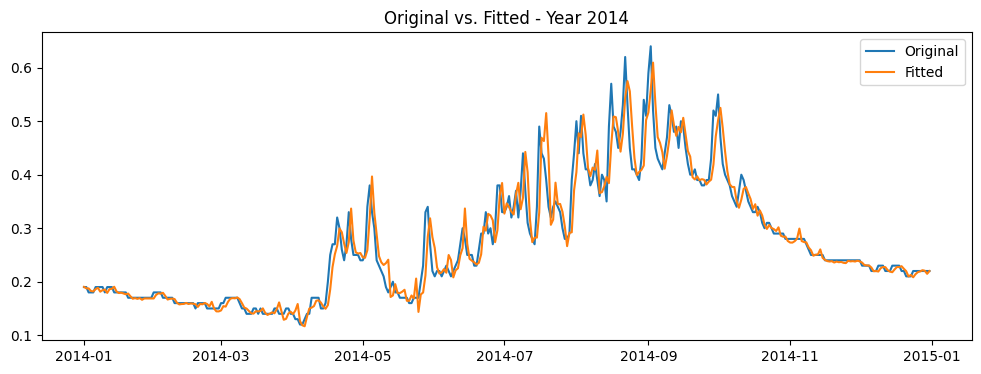

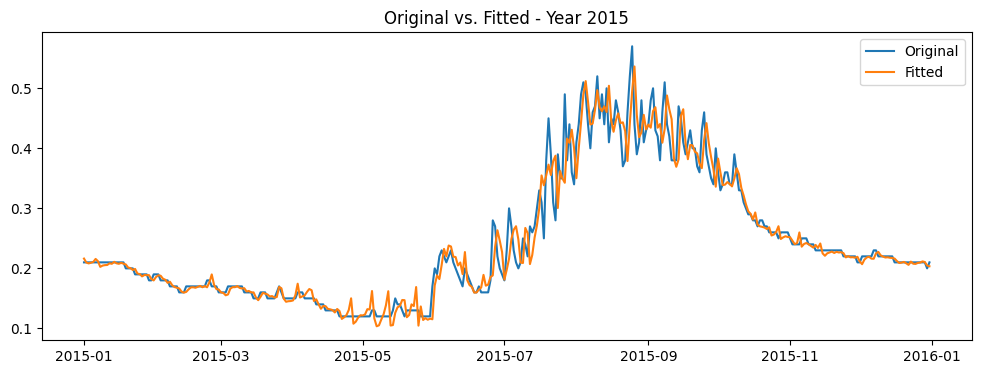

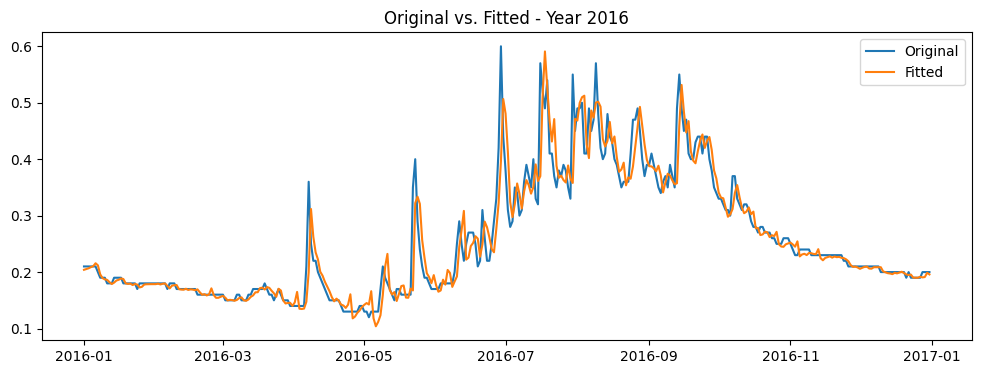

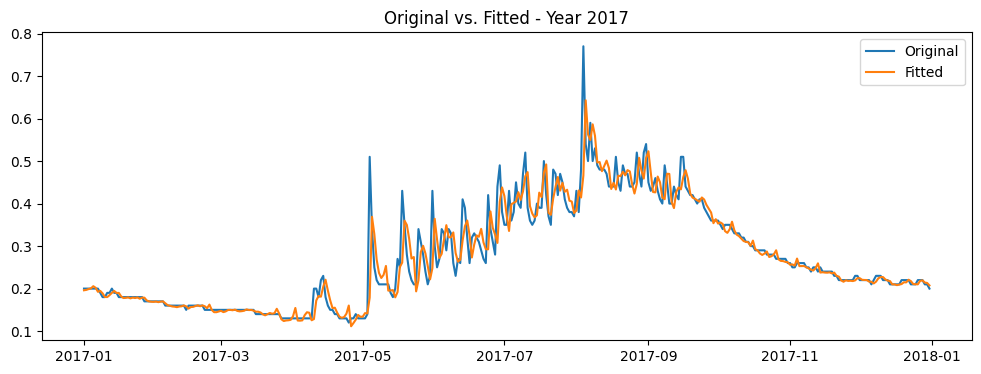

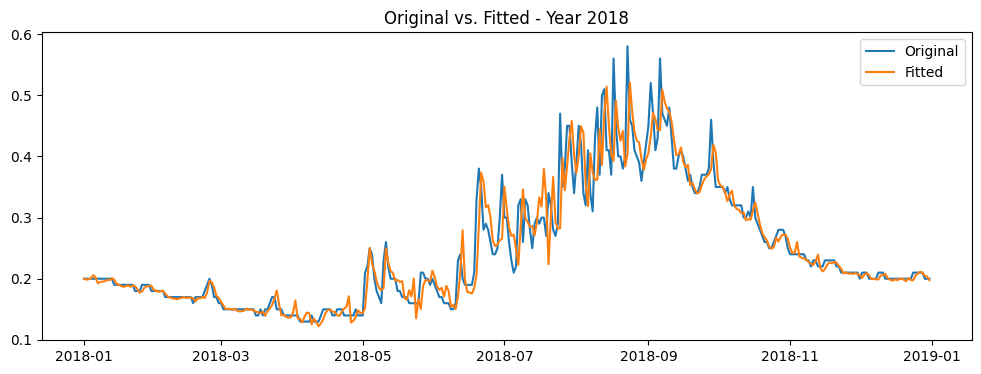

...

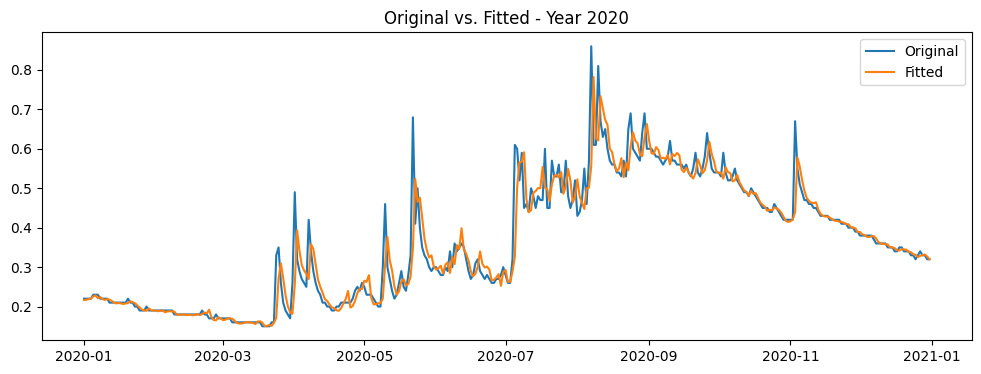

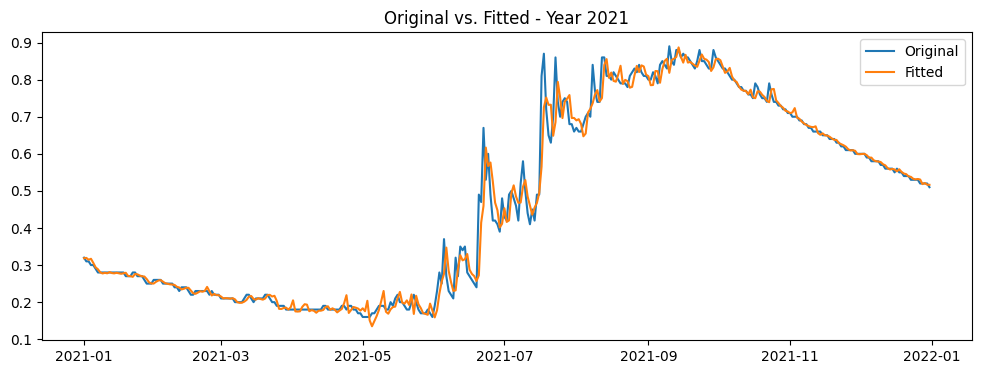

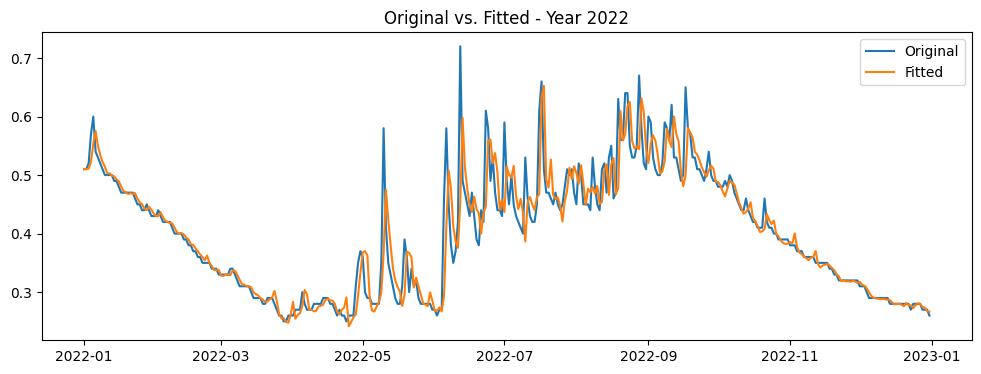

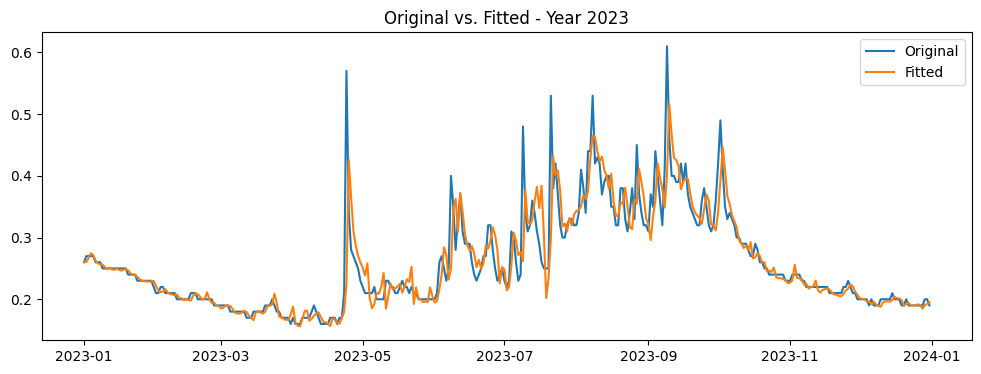

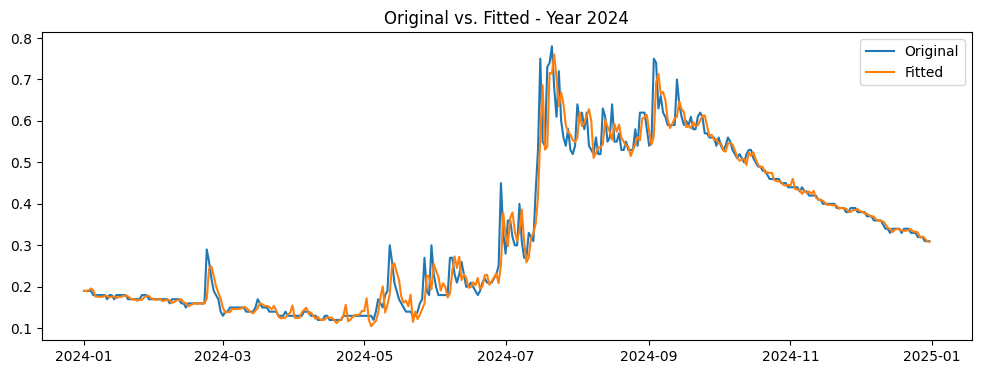

In [54]:
# surfmois_series vs fitted for each individual year

import pandas as pd
import matplotlib.pyplot as plt


# Convert the index to datetime objects if it's not already
df.index = pd.to_datetime(df.index)

# Group the data by year
for year, year_data in df.groupby(df.index.year):
    surf_soilmois_series_year = year_data['Surface_Soil_Wetness_(1)']
    fitted_year = hw_model_surf_mois.fittedvalues[year_data.index]

    plt.figure(figsize=(12, 4))
    plt.plot(surf_soilmois_series_year, label='Original')
    plt.plot(fitted_year, label='Fitted')
    plt.title(f'Original vs. Fitted - Year {year}')
    plt.legend()
    plt.show()

###2025 Forecast

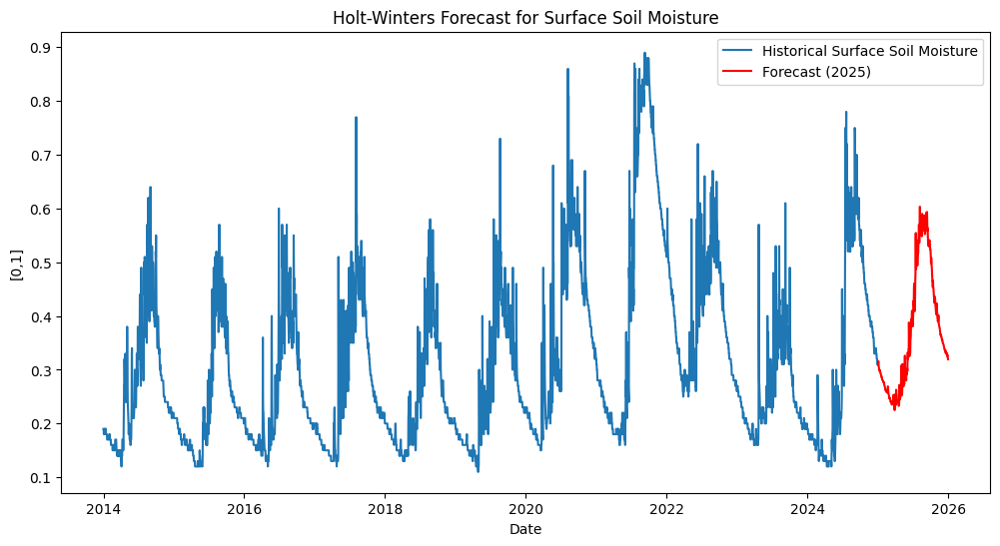

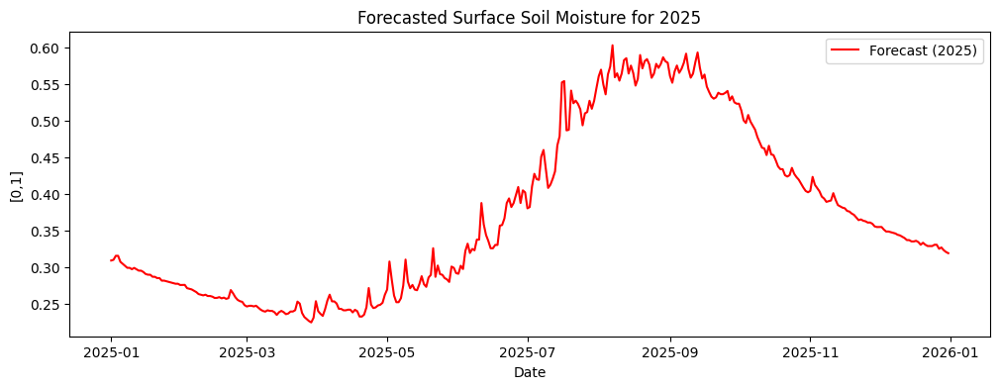

In [55]:
# Forecast next 365 days
forecast_surf_soilmois =  hw_model_surf_mois.forecast(365)

#visualise all years
plt.figure(figsize=(12, 6))
plt.plot(surf_soilmois_series, label="Historical Surface Soil Moisture")
plt.plot(forecast_surf_soilmois.index, forecast_surf_soilmois, label="Forecast (2025)", color='red')
plt.title("Holt-Winters Forecast for Surface Soil Moisture")
plt.xlabel("Date")
plt.ylabel("[0,1]")
plt.legend()
plt.show()

#visualise forecast
plt.figure(figsize=(12, 4))
plt.plot(forecast_surf_soilmois.index, forecast_surf_soilmois, label="Forecast (2025)", color='red')
plt.title("Forecasted Surface Soil Moisture for 2025")
plt.xlabel("Date")
plt.ylabel("[0,1]")
plt.legend()
plt.show()

### Model Evaluation (Train: 2014-2023, Test: 2024)

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


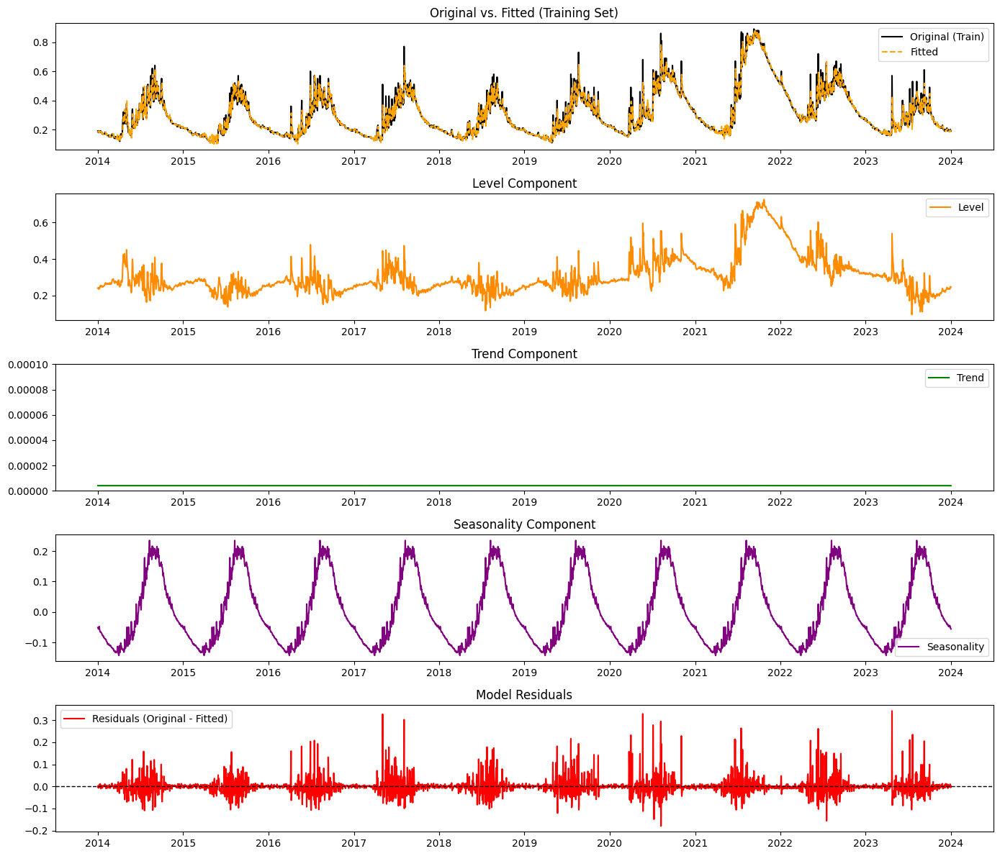

In [56]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
import numpy as np

# Train-test split (last 365 days as test set)
train = surf_soilmois_series[:-365]
test = surf_soilmois_series[-365:]

# Fit Holt-Winters model on training data
hw_model_eval = ExponentialSmoothing(
    train,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

# Forecast using Holt-Winters
test_pred_hw = hw_model_eval.forecast(365)

# Benchmark: Naive Forecast (each prediction = previous day's value)

test_pred_naive = test.shift(1)

# For the first day, use the last value from training
test_pred_naive.iloc[0] = train.iloc[-1]




# Extract components
level = hw_model_eval.level
trend = hw_model_eval.trend
season = hw_model_eval.season
fitted = hw_model_eval.fittedvalues

# Compute residuals (train set only)
residuals = train - fitted

# Plot all components
plt.figure(figsize=(14, 12))

# Original vs. Fitted
plt.subplot(5, 1, 1)
plt.plot(train, label="Original (Train)", color="black")
plt.plot(fitted, label="Fitted", linestyle="--", color="orange")
plt.title("Original vs. Fitted (Training Set)")
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label="Level", color="darkorange")
plt.title("Level Component")
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label="Trend", color="green")
plt.ylim(0,0.0001)
plt.title("Trend Component")
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label="Seasonality", color="purple")
plt.title("Seasonality Component")
plt.legend()

# Residuals
plt.subplot(5, 1, 5)
plt.plot(residuals, label="Residuals (Original - Fitted)", color="red")
plt.axhline(0, linestyle="--", color="black", linewidth=1)
plt.title("Model Residuals")
plt.legend()

plt.tight_layout()
plt.show()


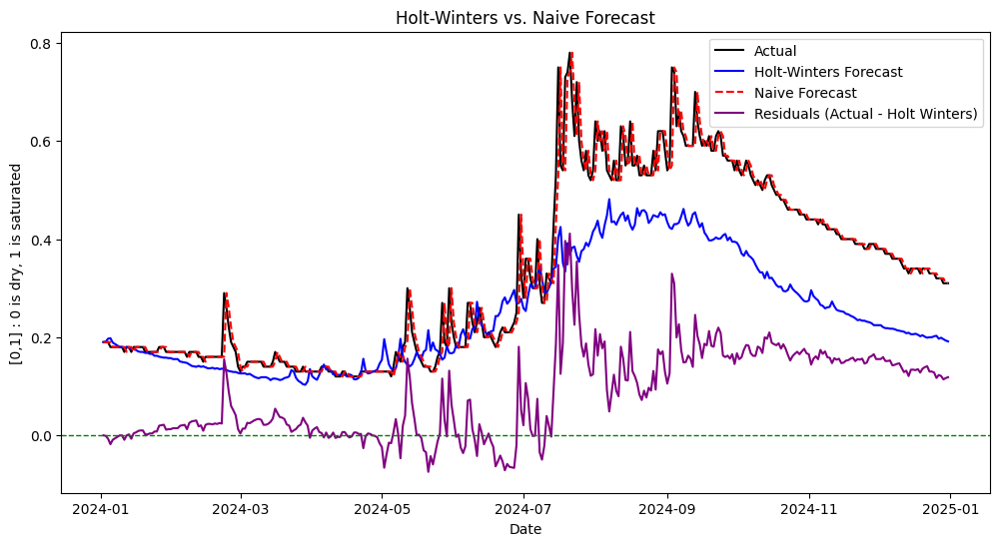

Performance Comparison:
Holt-Winters Annual → MAE: 0.091, RMSE: 0.121, R-Squared: 0.547, sMAPE: 26.790%
Naive Forecast → MAE: 0.018, RMSE: 0.038, R-Squared: 0.955, sMAPE: 5.122%


In [57]:
test_residuals = test - test_pred_hw

# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(test.index, test, label="Actual", color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Forecast", color='blue')
plt.plot(test_pred_naive.index, test_pred_naive, label="Naive Forecast", linestyle="--", color='red')
plt.plot(test_residuals.index, test_residuals, label="Residuals (Actual - Holt Winters)", color='purple')
plt.axhline(0, linestyle="--", color="green", linewidth=1)
plt.title("Holt-Winters vs. Naive Forecast")
plt.xlabel("Date")
plt.ylabel("[0,1] : 0 is dry, 1 is saturated")
plt.legend()
plt.show()

def rmse(y,t):
  return np.sqrt(np.mean((y-t)**2))

# Evaluation: Holt-Winters
mae_hw = mean_absolute_error(test, test_pred_hw)
rmse_hw = rmse(test, test_pred_hw)

# Evaluation: Naive
mae_naive = mean_absolute_error(test, test_pred_naive)
rmse_naive = rmse(test, test_pred_naive)

# R²
from sklearn.metrics import r2_score

r2_hw = r2_score(test, test_pred_hw)
r2_naive = r2_score(test, test_pred_naive)


#sMAPE
import numpy as np

def smape(y_true, y_pred):
    numerator = np.abs(y_true - y_pred)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

hw_annual_smape = smape(test, test_pred_hw)
naive_smape = smape(test, test_pred_naive)


# Print comparison
print("Performance Comparison:")
print(f"Holt-Winters Annual → MAE: {mae_hw:.3f}, RMSE: {rmse_hw:.3f}, R-Squared: {r2_hw:.3f}, sMAPE: {hw_annual_smape:.3f}%")
print(f"Naive Forecast → MAE: {mae_naive:.3f}, RMSE: {rmse_naive:.3f}, R-Squared: {r2_naive:.3f}, sMAPE: {naive_smape:.3f}%")


We can see that while the annual forecast broadly captures seasonality well, it consistently underestimates the surface moisture during the latter half of the year. This suggests that 365 days may be too long a time horizon for getting a reasonably accurate forecast based on univariate time series modelling using Holt Winters Smoothing.

Next, we consider a rolling monthly forecast approach.

### Recursive Forecasting (Every Month) for 2024 - reduces MAE and RSME by 75% ; reduces sMAPE from 27% to 11% ; increases R-Sq from 0.55 to 0.88

In [58]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Select the temperature series and interpolate missing values
series = df['Surface_Soil_Wetness_(1)']

#-------

# Define the full range of 2024
forecast_start = '2024-01-01'
forecast_end = '2024-12-31'
forecast_dates = pd.date_range(start=forecast_start, end=forecast_end, freq='D')

# Get initial training data: up to Dec 31, 2023
train_series = series[:'2024-01-01']

#-------

from datetime import timedelta

# Container to collect forecast results
monthly_forecasts = []

# Define monthly forecast dates for 2024
start_date = pd.to_datetime(forecast_start)
end_date = pd.to_datetime(forecast_end)

# Loop over each month
while start_date <= end_date:
    # Define forecast window: one month
    forecast_window_end = (start_date + pd.DateOffset(months=1)) - timedelta(days=1)
    forecast_dates_month = pd.date_range(start=start_date, end=forecast_window_end, freq='D')

    # Fit Holt-Winters model on available data
    model = ExponentialSmoothing(
        train_series,
        trend='add',
        seasonal='add',
        seasonal_periods=365,
        initialization_method='estimated'
    ).fit()

    # Forecast one month ahead
    forecast = model.forecast(len(forecast_dates_month))
    forecast.name = 'Forecast'
    forecast.index = forecast_dates_month

    # Store forecast
    monthly_forecasts.append(forecast)

    # Update training series with actual observed data from that month (real case)
    # In real use, replace forecast with real 2024 data when available
    actual_observed = series[forecast_dates_month]  # simulate using real 2024 data
    train_series = pd.concat([train_series, actual_observed])

    # Move to the next month
    start_date = forecast_window_end + timedelta(days=1)


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  r

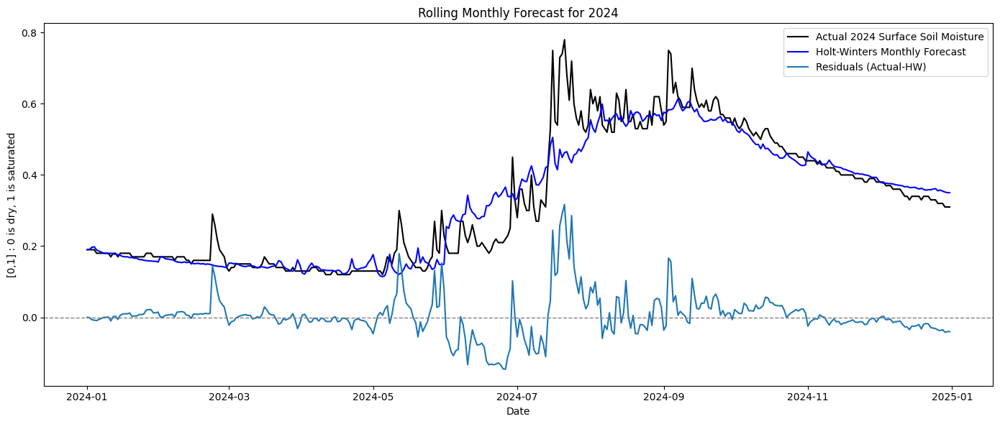

In [59]:
# Combine all forecasts into one series
full_rolling_forecast = pd.concat(monthly_forecasts)

# Extract actual values from 2024
actual_2024 = series['2024-01-01':'2024-12-31']

residuals_monthly = actual_2024 - full_rolling_forecast

# Plot forecast vs actual
plt.figure(figsize=(14, 6))
plt.plot(actual_2024, label='Actual 2024 Surface Soil Moisture', color='black')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Forecast', color='blue')
plt.plot(residuals_monthly, label='Residuals (Actual-HW)')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)
plt.title("Rolling Monthly Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("[0,1] : 0 is dry, 1 is saturated")
plt.legend()
plt.tight_layout()
plt.show()

In [60]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

mae_monthly_forecast = mean_absolute_error(actual_2024, full_rolling_forecast)
rmse_monthly_forecast = rmse(actual_2024, full_rolling_forecast)
r2_score_monthly_forecast = r2_score(actual_2024, full_rolling_forecast)

print(f"Rolling Forecast MAE: {mae_monthly_forecast:.3f} °C")
print(f"Rolling Forecast RMSE: {rmse_monthly_forecast:.3f} °C")
print(f"Rolling Forecast R-Squared: {r2_score_monthly_forecast:.3f}")


# Calculate sMAPE for entire 2024
hw_monthly_smape = smape(actual_2024, full_rolling_forecast)

print(f"Overall sMAPE for Rolling Holt-Winters Forecast (2024): {hw_monthly_smape:.2f}%")

Rolling Forecast MAE: 0.036 °C
Rolling Forecast RMSE: 0.060 °C
Rolling Forecast R-Squared: 0.889
Overall sMAPE for Rolling Holt-Winters Forecast (2024): 11.82%


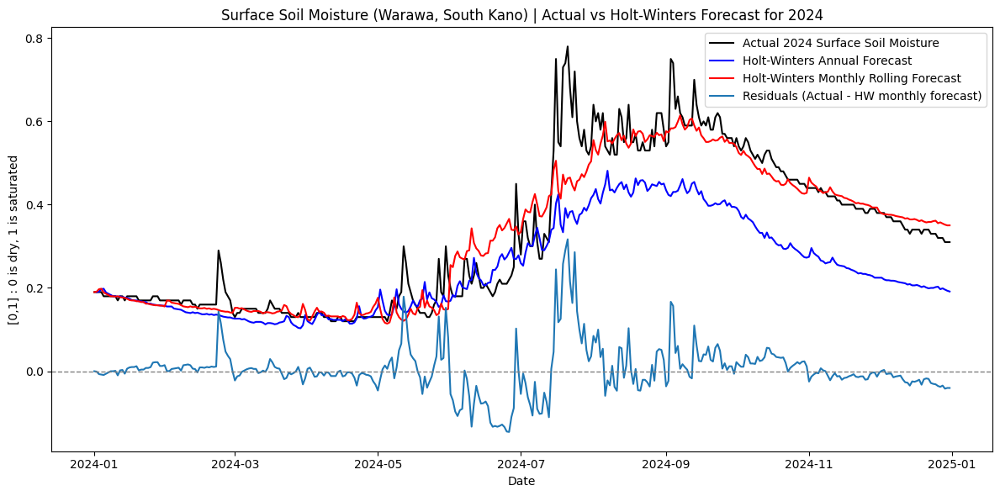

,HW Annual Forecast,| Naive Forecast (benchmark),| HW Monthly Rolling Forecast
Metric,,,
MAE,0.090881,0.018137,0.036443
RMSE,0.121455,0.038471,0.060102
R-squared (>0.8 is good),0.547394,0.954590,0.889043
sMAPE % (<10% is good),26.789804,5.122122,11.816334


In [61]:
# COMPARISON CHART AND EVALUATION TABLE


# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(actual_2024, label='Actual 2024 Surface Soil Moisture', color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Annual Forecast", color='blue')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Rolling Forecast', color='red')
plt.plot(residuals_monthly, label='Residuals (Actual - HW monthly forecast)')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)

plt.title("Surface Soil Moisture (Warawa, South Kano) | Actual vs Holt-Winters Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("[0,1] : 0 is dry, 1 is saturated")
plt.legend()
plt.tight_layout()
plt.show()




# table for mae_hw, rmse_hw, mae_naive, rmse_naive, mae_monthly_forecast, rmse_monthly_forecast, r2_hw, r2_naive, r2_score_monthly_forecast

import pandas as pd
# Create a dictionary to store the evaluation metrics
data = {
    'Metric': ['MAE', 'RMSE', 'R-squared (>0.8 is good)', 'sMAPE % (<10% is good)'],
    'HW Annual Forecast': [mae_hw, rmse_hw, r2_hw, hw_annual_smape],
    '| Naive Forecast (benchmark)': [mae_naive, rmse_naive, r2_naive, naive_smape],
    '| HW Monthly Rolling Forecast': [mae_monthly_forecast, rmse_monthly_forecast, r2_score_monthly_forecast, hw_monthly_smape]
}

# Create the DataFrame
evaluation_df = pd.DataFrame(data)

# Set 'Metric' column as index
evaluation_df = evaluation_df.set_index('Metric')

# Display the DataFrame
evaluation_df

 So we can see that while the annual forecast does a resonably good job of capturing the seasonality and overall movement of surface moisture, it consistently overestimates it during the last 6 months. The monthly rolling forecast helps remedy this by updating the level component at the beginning of each month which helps predict it more accurately.

# 4) Root Soil Wetness Time Series Analysis

## A) Holt Winters

### Modelling

Preprocessing and Visual Inspection

In [62]:
#Imports

import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing


# Select surface soil wetness column
root_soilmois_series = df['Root_Zone_Soil_Wetness_(1)']

root_soilmois_series



,Root_Zone_Soil_Wetness_(1)
Date,
2014-01-01,0.24
2014-01-02,0.24
2014-01-03,0.24
2014-01-04,0.24
2014-01-05,0.24
...,...
2024-12-27,0.33
2024-12-28,0.33
2024-12-29,0.33


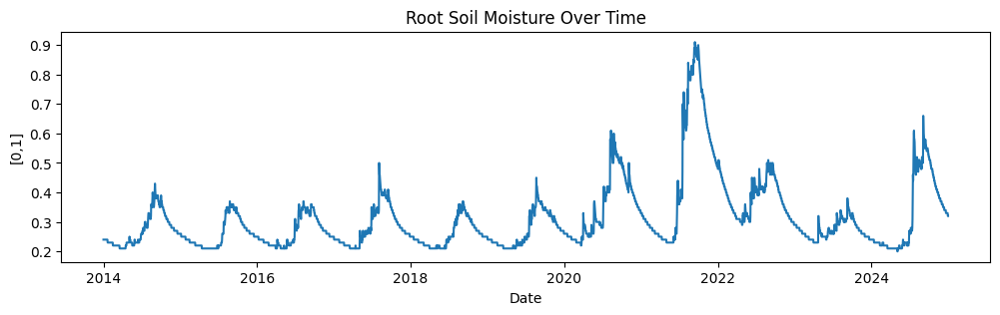

In [63]:
# Plot to check trend & seasonality
plt.figure(figsize=(12, 3))
plt.plot(root_soilmois_series)
plt.title("Root Soil Moisture Over Time")
plt.ylabel("[0,1]")
plt.xlabel("Date")
plt.show()

Model Fitting

In [64]:
#FITTING THE MODEL

# Seasonality length: 365 for daily data with yearly seasonality
season_length = 365

# Fit Holt-Winters additive model (trend + seasonality)
hw_model_rootsoilmois = ExponentialSmoothing(
    root_soilmois_series,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Inspecting Level, Trend, Seasonal Components and Residuals

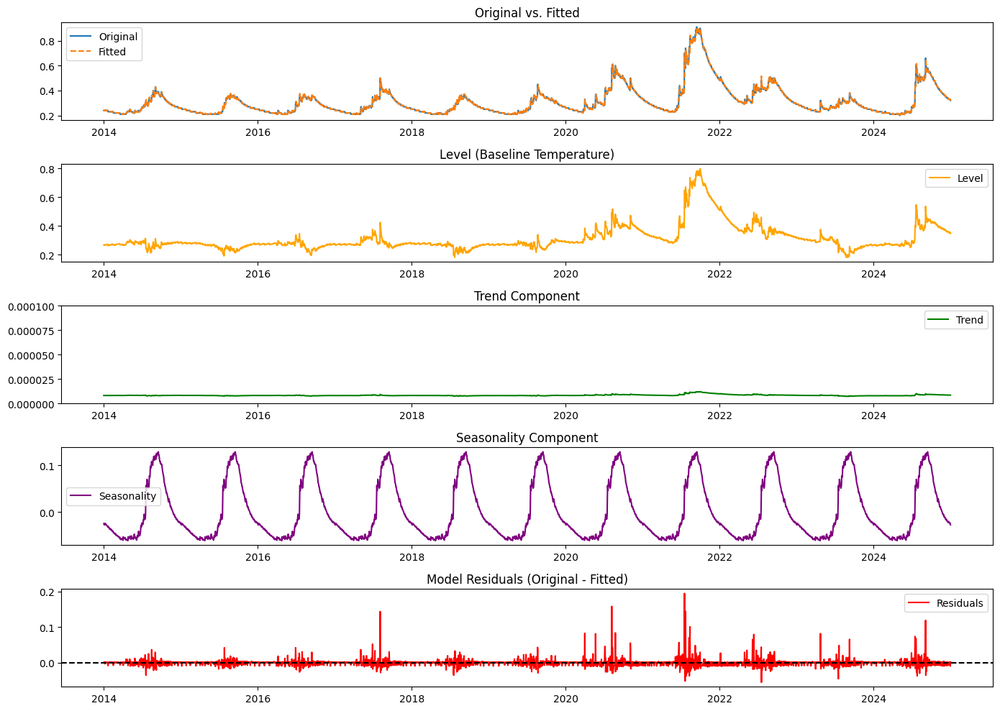

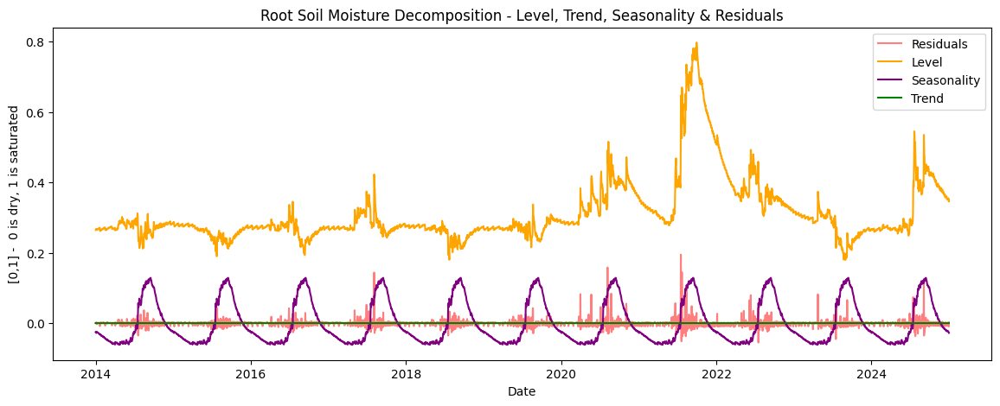

In [65]:
residuals = root_soilmois_series - hw_model_rootsoilmois.fittedvalues

#PLOTTING TREND LEVEL AND SEASONALITY

import matplotlib.pyplot as plt

# Get components
level = hw_model_rootsoilmois.level
trend = hw_model_rootsoilmois.trend
season = hw_model_rootsoilmois.season
fitted = hw_model_rootsoilmois.fittedvalues

# Create subplots
plt.figure(figsize=(14, 10))

# Original series and fitted values
plt.subplot(5, 1, 1)
plt.plot(root_soilmois_series, label='Original')
plt.plot(fitted, label='Fitted', linestyle='--')
plt.title('Original vs. Fitted')
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label='Level', color='orange')
plt.title('Level (Baseline Temperature)')
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label='Trend', color='green')
plt.title('Trend Component')
plt.ylim(0,0.0001)
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label='Seasonality', color='purple')
plt.title('Seasonality Component')
plt.legend()

#R Residuals

plt.subplot(5,1,5)
plt.plot(residuals, label='Residuals', color='red')
plt.title('Model Residuals (Original - Fitted)')
plt.axhline(0, color='black', linestyle='--')
plt.legend()

'''
plt.figure(figsize=(12, 4))
plt.plot(residuals)
plt.title("Model Residuals (Original - Fitted)")
plt.axhline(0, color='black', linestyle='--')
plt.show()
'''

plt.tight_layout()
plt.show()


#plotting all-in-one

plt.figure(figsize=(14, 5))
#plt.plot(fitted, label='Fitted')
plt.plot(residuals, label='Residuals', color='red', alpha = 0.5)
plt.plot(level, label='Level', color='orange')
plt.plot(season, label='Seasonality', color='purple')
plt.plot(trend, label='Trend', color='green')

plt.legend()
plt.title("Root Soil Moisture Decomposition - Level, Trend, Seasonality & Residuals")
plt.ylabel("[0,1] -  0 is dry, 1 is saturated")
plt.xlabel("Date")
plt.show()


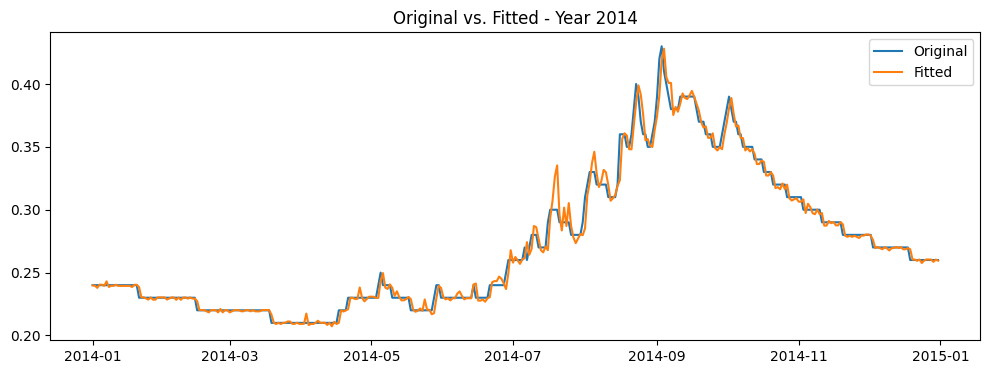

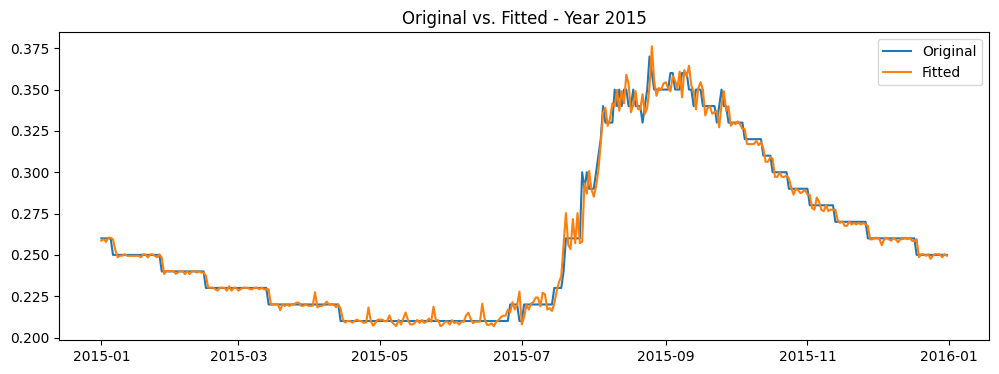

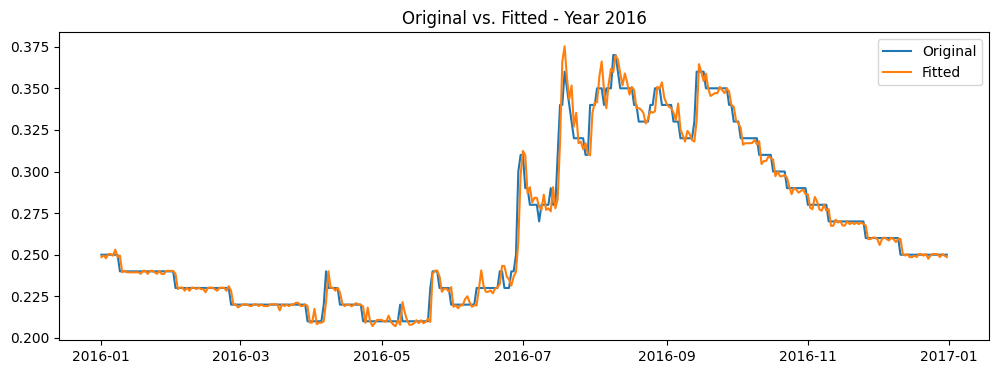

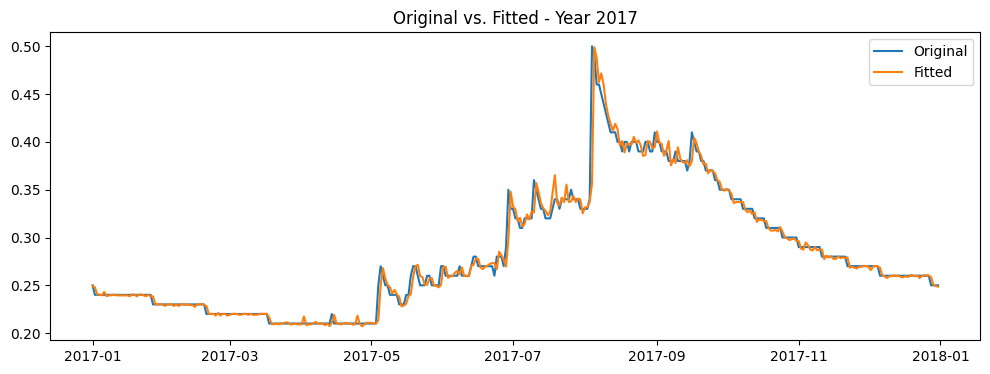

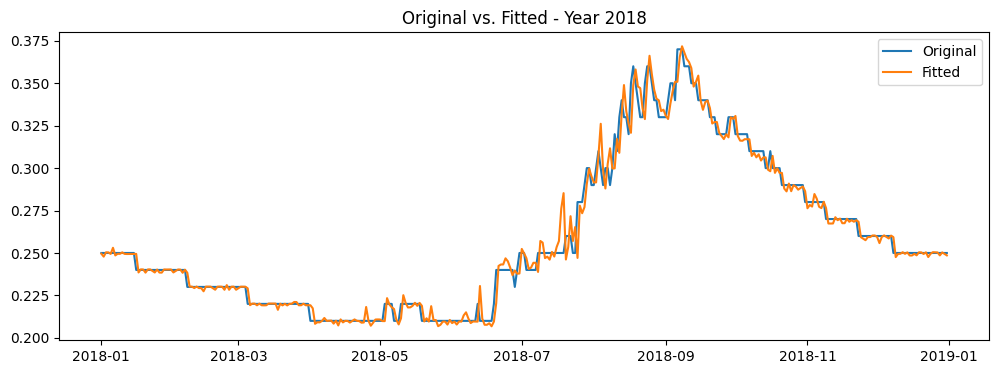

...

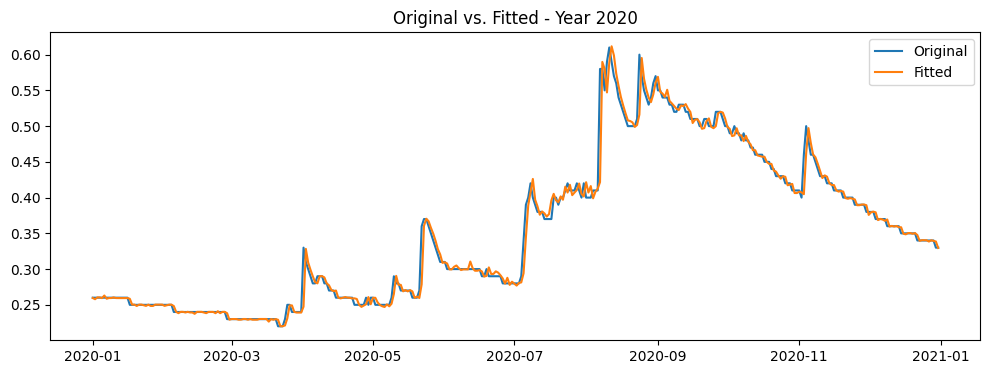

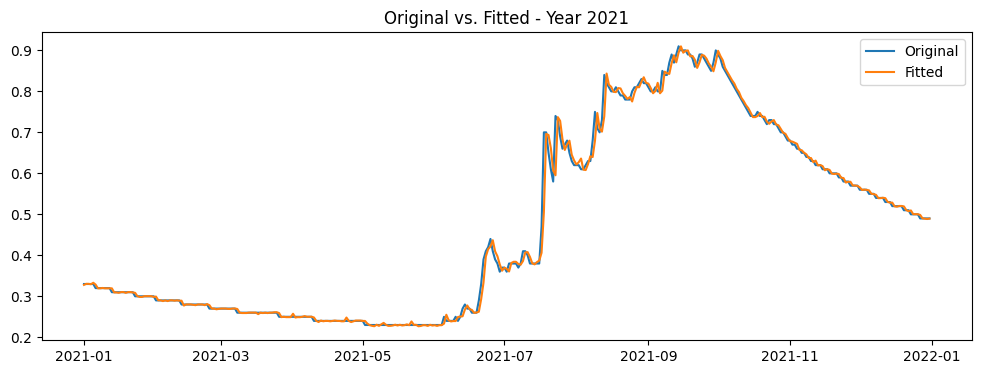

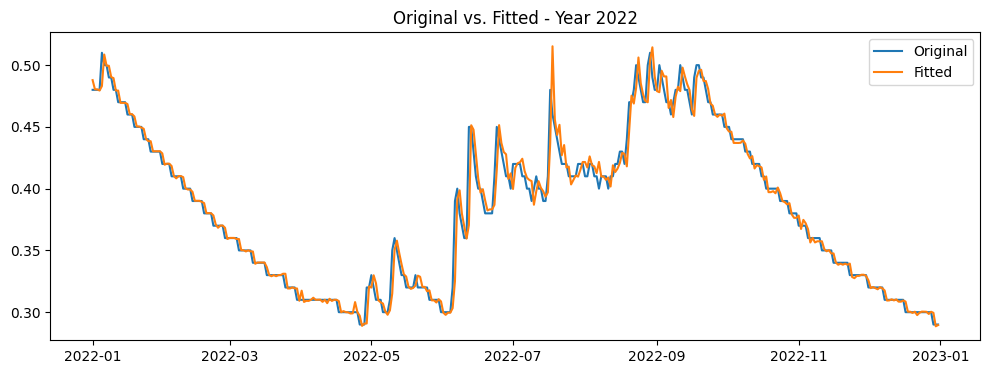

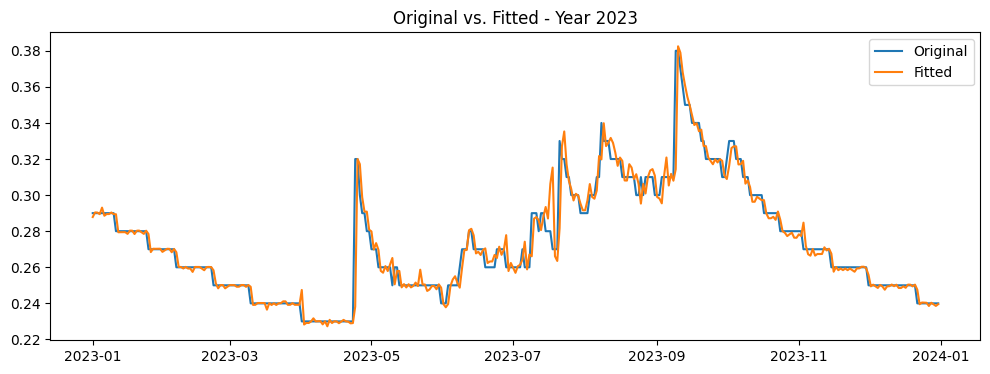

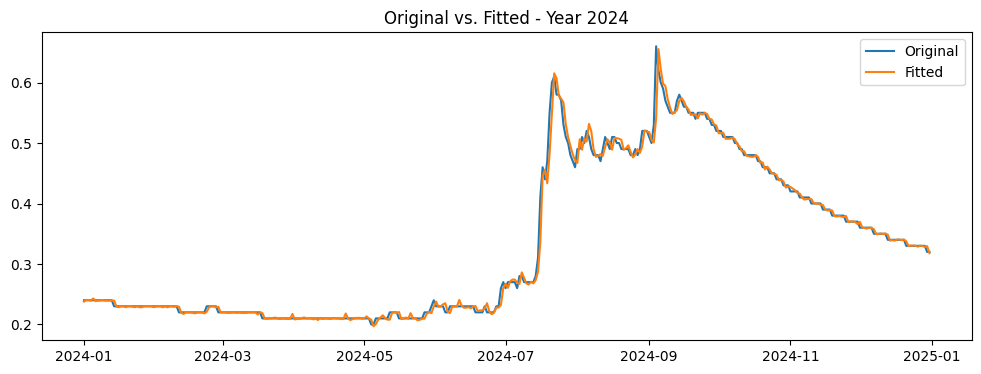

In [66]:
# root_soilmois_series vs fitted for each individual year

import pandas as pd
import matplotlib.pyplot as plt


# Convert the index to datetime objects if it's not already
df.index = pd.to_datetime(df.index)

# Group the data by year
for year, year_data in df.groupby(df.index.year):
    root_soilmois_series_year = year_data['Root_Zone_Soil_Wetness_(1)']
    fitted_year = hw_model_rootsoilmois.fittedvalues[year_data.index]

    plt.figure(figsize=(12, 4))
    plt.plot(root_soilmois_series_year, label='Original')
    plt.plot(fitted_year, label='Fitted')
    plt.title(f'Original vs. Fitted - Year {year}')
    plt.legend()
    plt.show()

###Forecast 2025

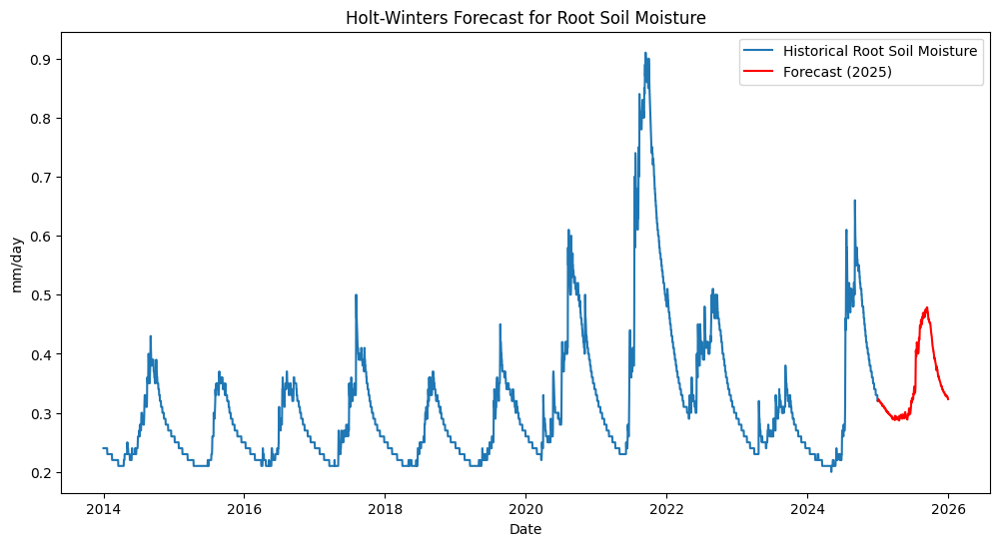

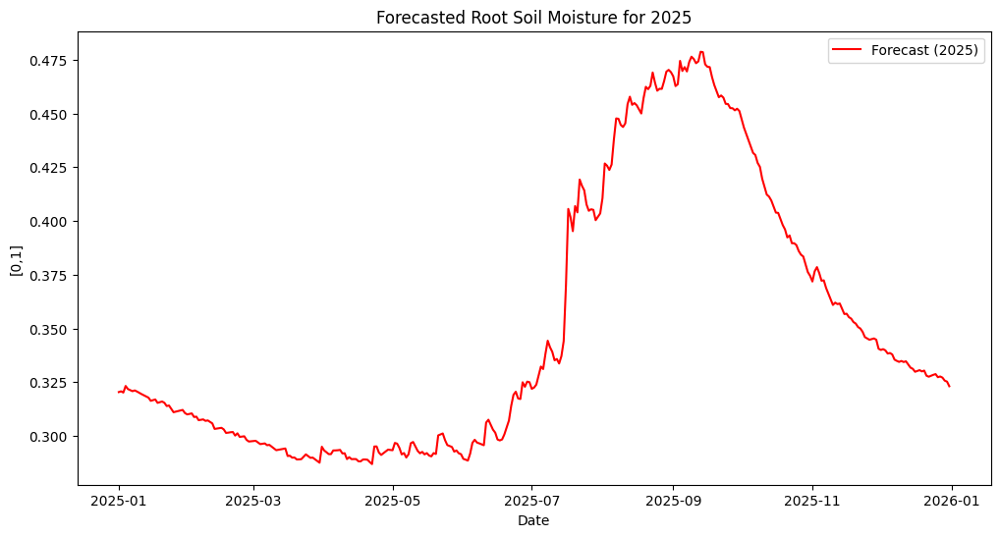

In [67]:
# Forecast next 365 days
forecast_rootsoilmois =  hw_model_rootsoilmois.forecast(365)


#visualise all years
plt.figure(figsize=(12, 6))
plt.plot(root_soilmois_series, label="Historical Root Soil Moisture")
plt.plot(forecast_rootsoilmois.index, forecast_rootsoilmois, label="Forecast (2025)", color='red')
plt.title("Holt-Winters Forecast for Root Soil Moisture")
plt.xlabel("Date")
plt.ylabel("mm/day")
plt.legend()
plt.show()

#visualise forecast
plt.figure(figsize=(12, 6))
plt.plot(forecast_rootsoilmois.index, forecast_rootsoilmois, label="Forecast (2025)", color='red')
plt.title("Forecasted Root Soil Moisture for 2025")
plt.xlabel("Date")
plt.ylabel("[0,1]")
plt.legend()
plt.show()

### Model Evaluation (Train: 2014-2023, Test: 2024)

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


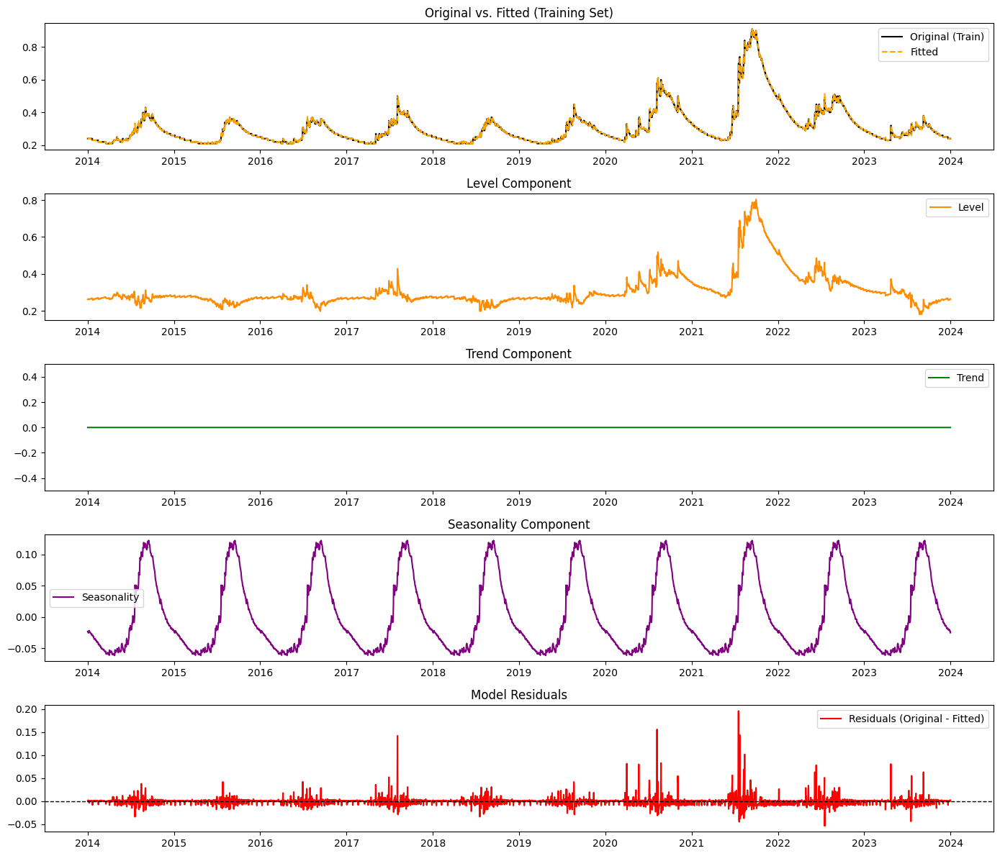

In [68]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
import numpy as np

# Train-test split (last 365 days as test set)
train = root_soilmois_series[:-365]
test = root_soilmois_series[-365:]

# Fit Holt-Winters model on training data
hw_model_eval = ExponentialSmoothing(
    train,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

# Forecast using Holt-Winters
test_pred_hw = hw_model_eval.forecast(365)

# Benchmark: Naive Forecast (each prediction = previous day's value)

test_pred_naive = test.shift(1)

# For the first day, use the last value from training
test_pred_naive.iloc[0] = train.iloc[-1]




# Extract components
level = hw_model_eval.level
trend = hw_model_eval.trend
season = hw_model_eval.season
fitted = hw_model_eval.fittedvalues

# Compute residuals (train set only)
residuals = train - fitted

# Plot all components
plt.figure(figsize=(14, 12))

# Original vs. Fitted
plt.subplot(5, 1, 1)
plt.plot(train, label="Original (Train)", color="black")
plt.plot(fitted, label="Fitted", linestyle="--", color="orange")
plt.title("Original vs. Fitted (Training Set)")
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label="Level", color="darkorange")
plt.title("Level Component")
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label="Trend", color="green")
plt.ylim(-0.5,0.5)
plt.title("Trend Component")
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label="Seasonality", color="purple")
plt.title("Seasonality Component")
plt.legend()

# Residuals
plt.subplot(5, 1, 5)
plt.plot(residuals, label="Residuals (Original - Fitted)", color="red")
plt.axhline(0, linestyle="--", color="black", linewidth=1)
plt.title("Model Residuals")
plt.legend()

plt.tight_layout()
plt.show()


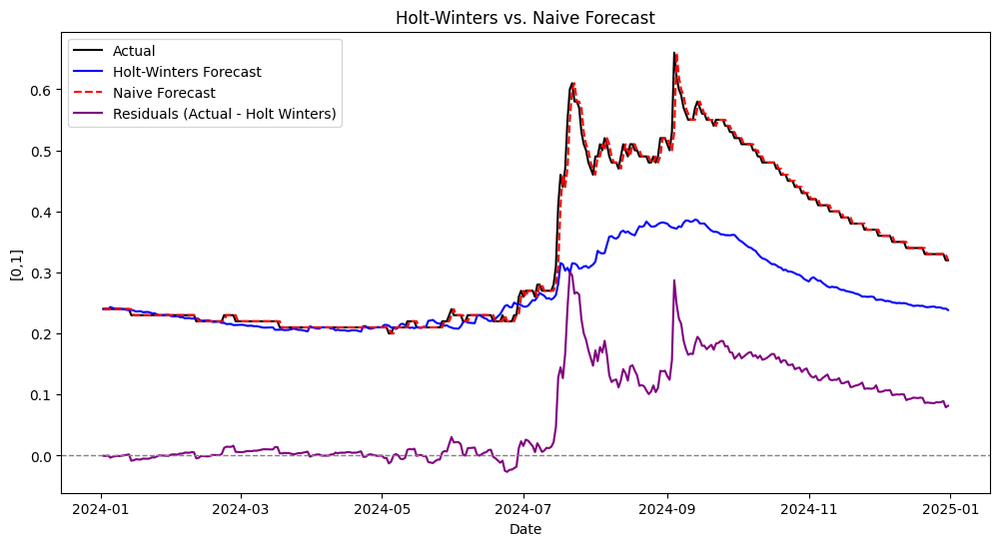

Performance Comparison:
Holt-Winters Annual → MAE: 0.070, RMSE: 0.102, R-Squared: 0.368, sMAPE: 18.711%
Naive Forecast → MAE: 0.005, RMSE: 0.013, R-Squared: 0.990, sMAPE: 1.154%


In [69]:
test_residuals = test - test_pred_hw

# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(test.index, test, label="Actual", color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Forecast", color='blue')
plt.plot(test_pred_naive.index, test_pred_naive, label="Naive Forecast", linestyle="--", color='red')
plt.plot(test_residuals.index, test_residuals, label="Residuals (Actual - Holt Winters)", color='purple')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)
plt.title("Holt-Winters vs. Naive Forecast")
plt.xlabel("Date")
plt.ylabel("[0,1]")
plt.legend()
plt.show()

def rmse(y,t):
  return np.sqrt(np.mean((y-t)**2))

# Evaluation: Holt-Winters
mae_hw = mean_absolute_error(test, test_pred_hw)
rmse_hw = rmse(test, test_pred_hw)

# Evaluation: Naive
mae_naive = mean_absolute_error(test, test_pred_naive)
rmse_naive = rmse(test, test_pred_naive)

# R²
from sklearn.metrics import r2_score

r2_hw = r2_score(test, test_pred_hw)
r2_naive = r2_score(test, test_pred_naive)


#sMAPE
import numpy as np

def smape(y_true, y_pred):
    numerator = np.abs(y_true - y_pred)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

hw_annual_smape = smape(test, test_pred_hw)
naive_smape = smape(test, test_pred_naive)


# Print comparison
print("Performance Comparison:")
print(f"Holt-Winters Annual → MAE: {mae_hw:.3f}, RMSE: {rmse_hw:.3f}, R-Squared: {r2_hw:.3f}, sMAPE: {hw_annual_smape:.3f}%")
print(f"Naive Forecast → MAE: {mae_naive:.3f}, RMSE: {rmse_naive:.3f}, R-Squared: {r2_naive:.3f}, sMAPE: {naive_smape:.3f}%")

We can see that while the annual forecast broadly captures seasonality well, it consistently underestimates the root moisture during the latter half of the year. This suggests that 365 days may be too long a time horizon for getting a reasonably accurate forecast based on univariate time series modelling using Holt Winters Smoothing.

Next, we consider a rolling monthly forecast approach.

### Recursive Forecasting (Every Month) for 2024 - reduces MAE and RSME by 50-70% ; reduces sMAPE from 19% to 6% ; increases R-Sq from 0.36 to 0.88

In [70]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Select the temperature series and interpolate missing values
series = df['Root_Zone_Soil_Wetness_(1)']

#-------

# Define the full range of 2024
forecast_start = '2024-01-01'
forecast_end = '2024-12-31'
forecast_dates = pd.date_range(start=forecast_start, end=forecast_end, freq='D')

# Get initial training data: up to Dec 31, 2023
train_series = series[:'2024-01-01']

#-------

from datetime import timedelta

# Container to collect forecast results
monthly_forecasts = []

# Define monthly forecast dates for 2024
start_date = pd.to_datetime(forecast_start)
end_date = pd.to_datetime(forecast_end)

# Loop over each month
while start_date <= end_date:
    # Define forecast window: one month
    forecast_window_end = (start_date + pd.DateOffset(months=1)) - timedelta(days=1)
    forecast_dates_month = pd.date_range(start=start_date, end=forecast_window_end, freq='D')

    # Fit Holt-Winters model on available data
    model = ExponentialSmoothing(
        train_series,
        trend='add',
        seasonal='add',
        seasonal_periods=365,
        initialization_method='estimated'
    ).fit()

    # Forecast one month ahead
    forecast = model.forecast(len(forecast_dates_month))
    forecast.name = 'Forecast'
    forecast.index = forecast_dates_month

    # Store forecast
    monthly_forecasts.append(forecast)

    # Update training series with actual observed data from that month (real case)
    # In real use, replace forecast with real 2024 data when available
    actual_observed = series[forecast_dates_month]  # simulate using real 2024 data
    train_series = pd.concat([train_series, actual_observed])

    # Move to the next month
    start_date = forecast_window_end + timedelta(days=1)


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  r

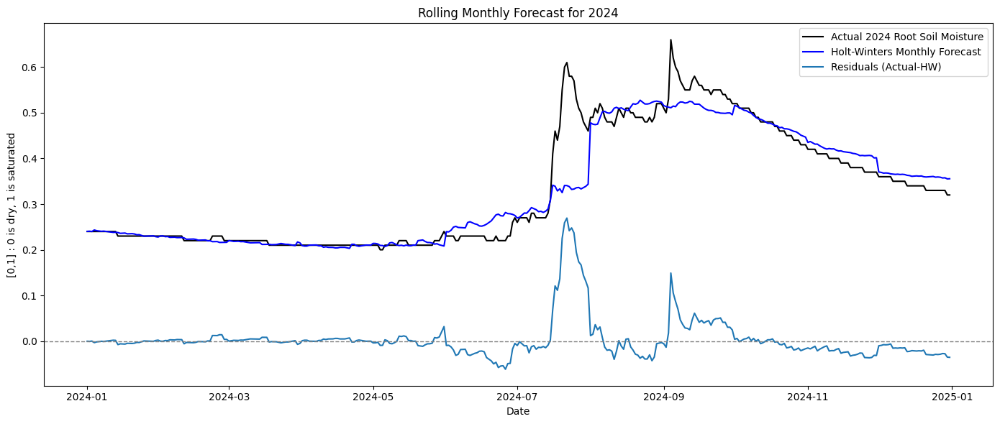

In [71]:
# Combine all forecasts into one series
full_rolling_forecast = pd.concat(monthly_forecasts)

# Extract actual values from 2024
actual_2024 = series['2024-01-01':'2024-12-31']

residuals_monthly = actual_2024 - full_rolling_forecast

# Plot forecast vs actual
plt.figure(figsize=(14, 6))
plt.plot(actual_2024, label='Actual 2024 Root Soil Moisture', color='black')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Forecast', color='blue')
plt.plot(residuals_monthly, label='Residuals (Actual-HW)')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)
plt.title("Rolling Monthly Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("[0,1] : 0 is dry, 1 is saturated")
plt.legend()
plt.tight_layout()
plt.show()

In [72]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

mae_monthly_forecast = mean_absolute_error(actual_2024, full_rolling_forecast)
rmse_monthly_forecast = rmse(actual_2024, full_rolling_forecast)
r2_score_monthly_forecast = r2_score(actual_2024, full_rolling_forecast)

print(f"Rolling Forecast MAE: {mae_monthly_forecast:.3f} °C")
print(f"Rolling Forecast RMSE: {rmse_monthly_forecast:.3f} °C")
print(f"Rolling Forecast R-Squared: {r2_score_monthly_forecast:.3f}")


# Calculate sMAPE for entire 2024
hw_monthly_smape = smape(actual_2024, full_rolling_forecast)

print(f"Overall sMAPE for Rolling Holt-Winters Forecast (2024): {hw_monthly_smape:.2f}%")

Rolling Forecast MAE: 0.022 °C
Rolling Forecast RMSE: 0.045 °C
Rolling Forecast R-Squared: 0.876
Overall sMAPE for Rolling Holt-Winters Forecast (2024): 5.94%


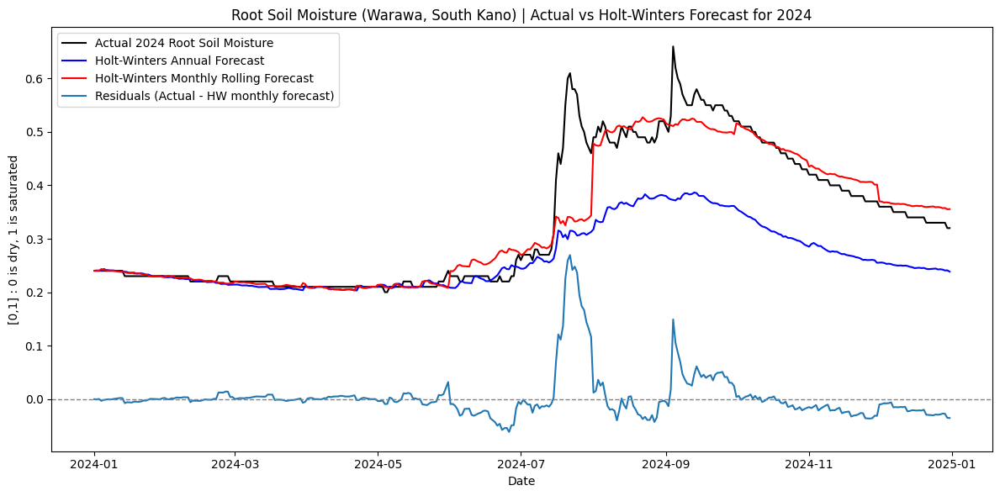

,HW Annual Forecast,| Naive Forecast (benchmark),| HW Monthly Rolling Forecast
Metric,,,
MAE,0.070329,0.004712,0.022367
RMSE,0.102372,0.012885,0.045290
R-squared (>0.8 is good),0.367567,0.989981,0.876058
sMAPE % (<10% is good),18.710693,1.154186,5.943849


In [73]:
# COMPARISON CHART AND EVALUATION TABLE


# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(actual_2024, label='Actual 2024 Root Soil Moisture', color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Annual Forecast", color='blue')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Rolling Forecast', color='red')
plt.plot(residuals_monthly, label='Residuals (Actual - HW monthly forecast)')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)

plt.title("Root Soil Moisture (Warawa, South Kano) | Actual vs Holt-Winters Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("[0,1] : 0 is dry, 1 is saturated")
plt.legend()
plt.tight_layout()
plt.show()




# table for mae_hw, rmse_hw, mae_naive, rmse_naive, mae_monthly_forecast, rmse_monthly_forecast, r2_hw, r2_naive, r2_score_monthly_forecast

import pandas as pd
# Create a dictionary to store the evaluation metrics
data = {
    'Metric': ['MAE', 'RMSE', 'R-squared (>0.8 is good)', 'sMAPE % (<10% is good)'],
    'HW Annual Forecast': [mae_hw, rmse_hw, r2_hw, hw_annual_smape],
    '| Naive Forecast (benchmark)': [mae_naive, rmse_naive, r2_naive, naive_smape],
    '| HW Monthly Rolling Forecast': [mae_monthly_forecast, rmse_monthly_forecast, r2_score_monthly_forecast, hw_monthly_smape]
}

# Create the DataFrame
evaluation_df = pd.DataFrame(data)

# Set 'Metric' column as index
evaluation_df = evaluation_df.set_index('Metric')

# Display the DataFrame
evaluation_df

# 5) Precipitation Time Series Analysis

## A) Holt Winters

### Modelling

Preprocessing and Visual Inspection

In [74]:
#Imports

import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Select surface soil wetness column
rain_series = df['Precipitation_Corrected_(mm/day)']

rain_series


,Precipitation_Corrected_(mm/day)
Date,
2014-01-01,0.0
2014-01-02,0.0
2014-01-03,0.0
2014-01-04,0.0
2014-01-05,0.0
...,...
2024-12-27,0.0
2024-12-28,0.0
2024-12-29,0.0


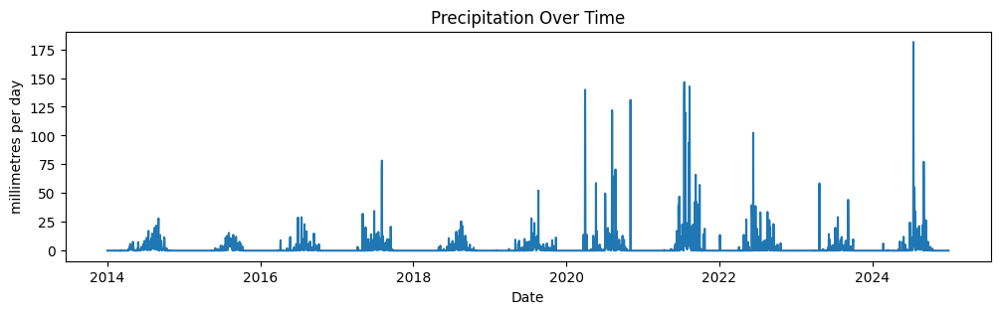

In [75]:
# Plot to check trend & seasonality
plt.figure(figsize=(12, 3))
plt.plot(rain_series)
plt.title("Precipitation Over Time")
plt.ylabel("millimetres per day")
plt.xlabel("Date")
plt.show()

In [76]:
#check missing values
print(rain_series.isna().sum())

0


Model Fitting

In [77]:
#FITTING THE MODEL

# Seasonality length: 365 for daily data with yearly seasonality
season_length = 365

# Fit Holt-Winters additive model (trend + seasonality)
hw_model_rain = ExponentialSmoothing(
    rain_series,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


Inspecting Level, Trend, Seasonal Components and Residuals


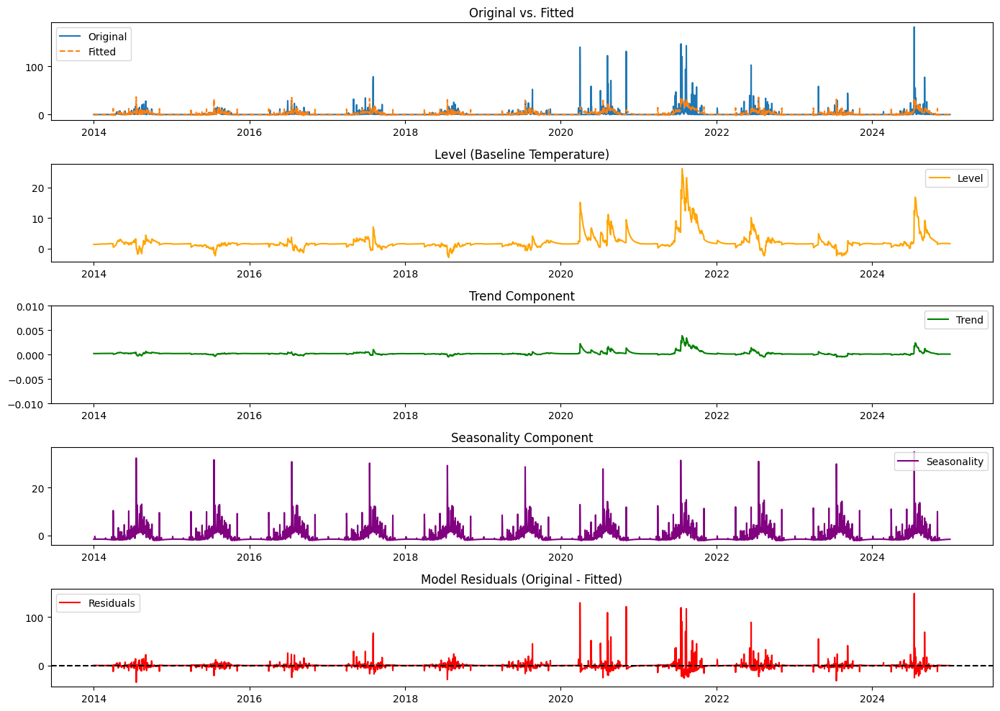

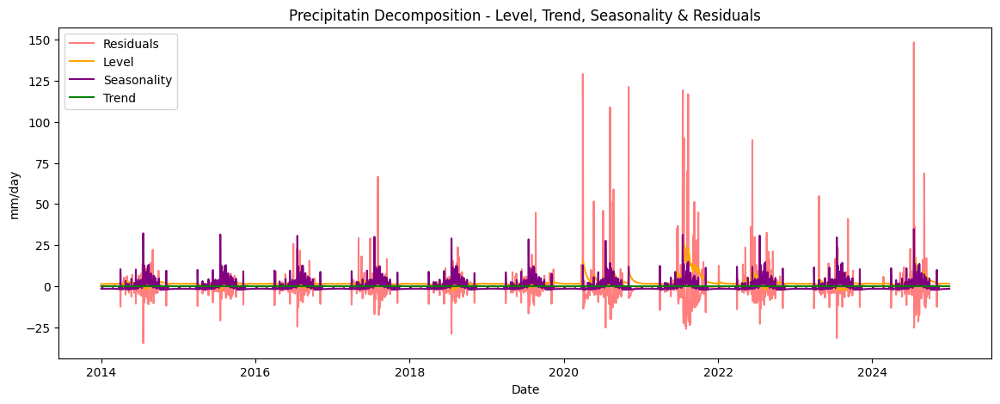

In [78]:
residuals = rain_series - hw_model_rain.fittedvalues

#PLOTTING TREND LEVEL AND SEASONALITY

import matplotlib.pyplot as plt

# Get components
level = hw_model_rain.level
trend = hw_model_rain.trend
season = hw_model_rain.season
fitted = hw_model_rain.fittedvalues

# Create subplots
plt.figure(figsize=(14, 10))

# Original series and fitted values
plt.subplot(5, 1, 1)
plt.plot(rain_series, label='Original')
plt.plot(fitted, label='Fitted', linestyle='--')
plt.title('Original vs. Fitted')
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label='Level', color='orange')
plt.title('Level (Baseline Temperature)')
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label='Trend', color='green')
plt.title('Trend Component')
plt.ylim(-0.01,0.01)
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label='Seasonality', color='purple')
plt.title('Seasonality Component')
plt.legend()

#R Residuals

plt.subplot(5,1,5)
plt.plot(residuals, label='Residuals', color='red')
plt.title('Model Residuals (Original - Fitted)')
plt.axhline(0, color='black', linestyle='--')
plt.legend()

plt.tight_layout()
plt.show()




#plotting all-in-one

plt.figure(figsize=(14, 5))
#plt.plot(fitted, label='Fitted')
plt.plot(residuals, label='Residuals', color='red', alpha = 0.5)
plt.plot(level, label='Level', color='orange')
plt.plot(season, label='Seasonality', color='purple')
plt.plot(trend, label='Trend', color='green')

plt.legend()
plt.title("Precipitatin Decomposition - Level, Trend, Seasonality & Residuals")
plt.ylabel("mm/day")
plt.xlabel("Date")
plt.show()



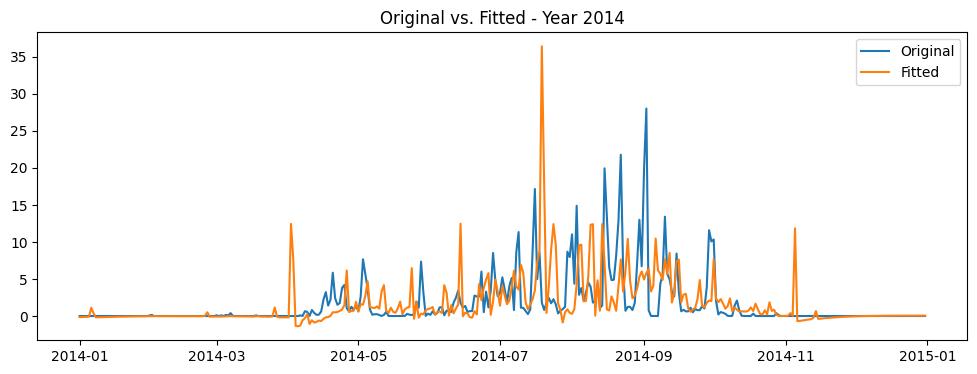

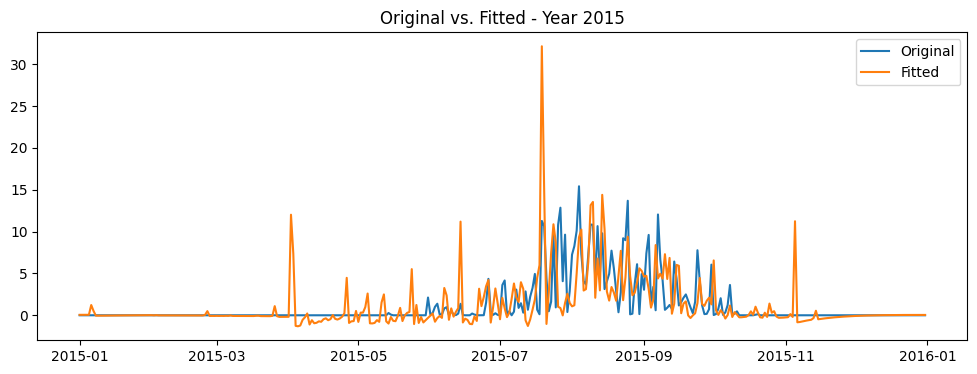

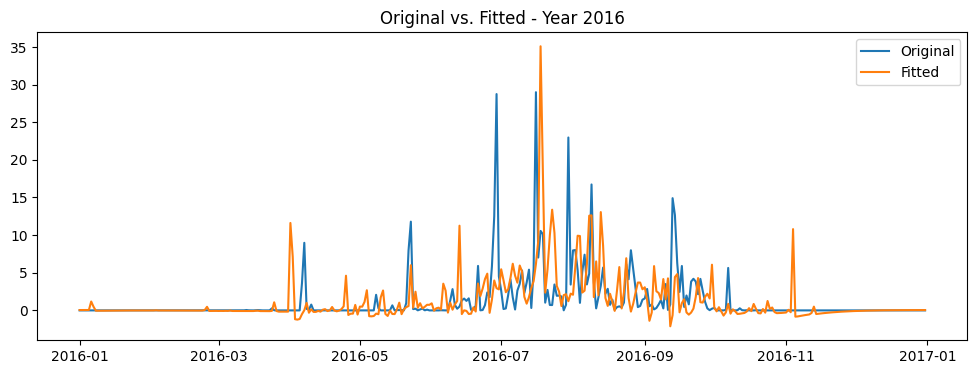

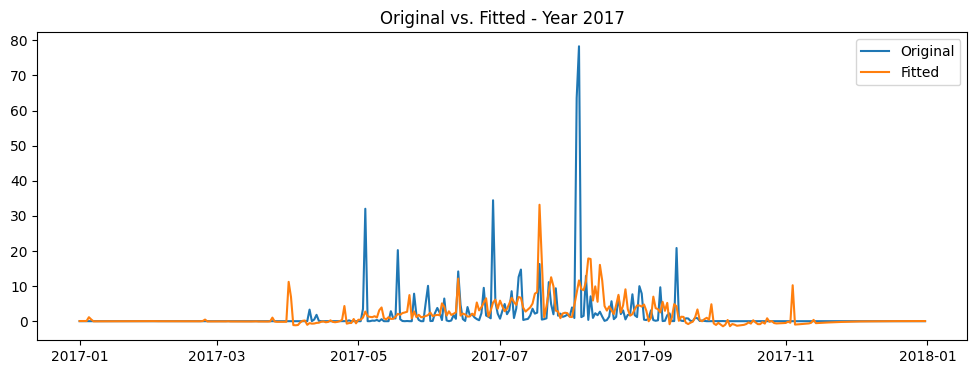

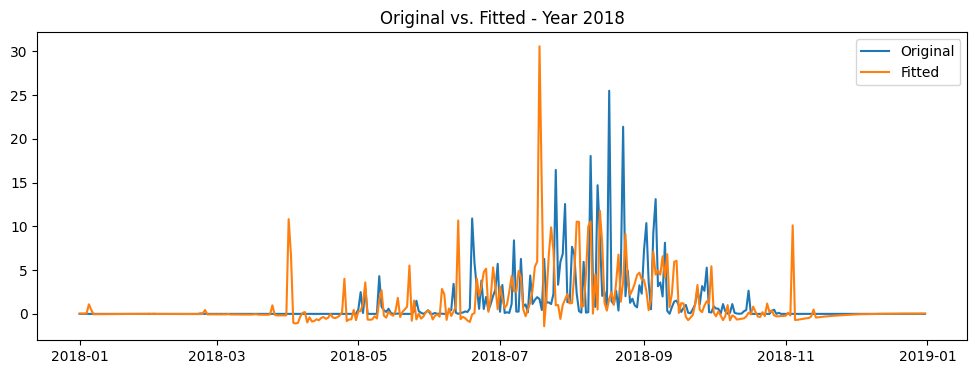

...

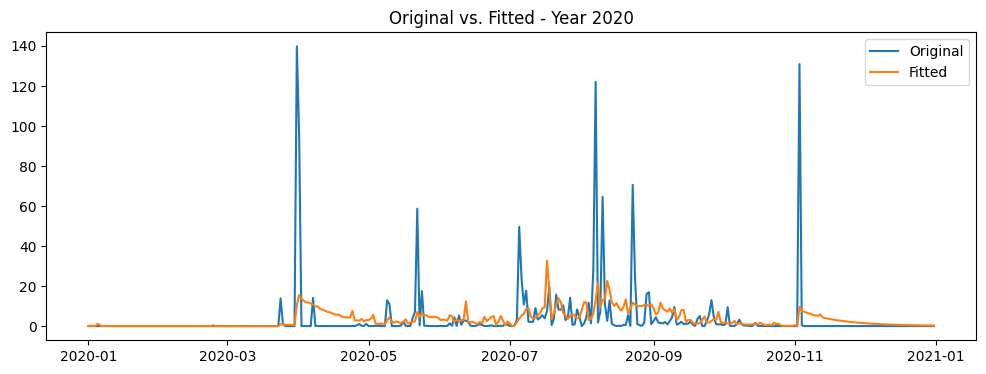

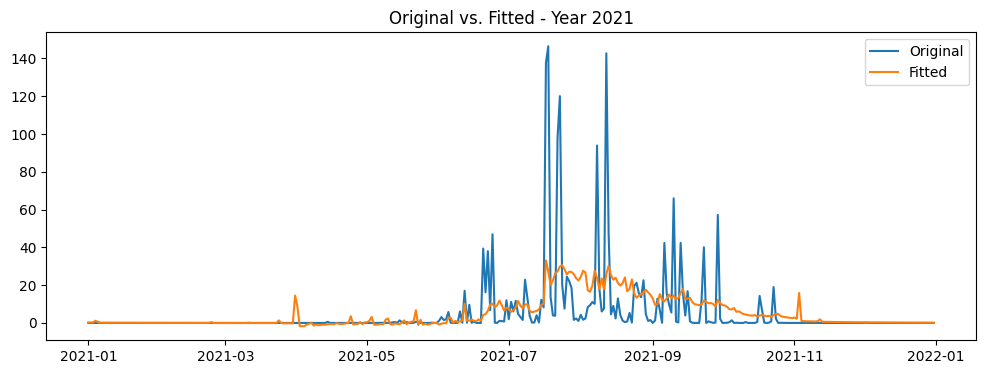

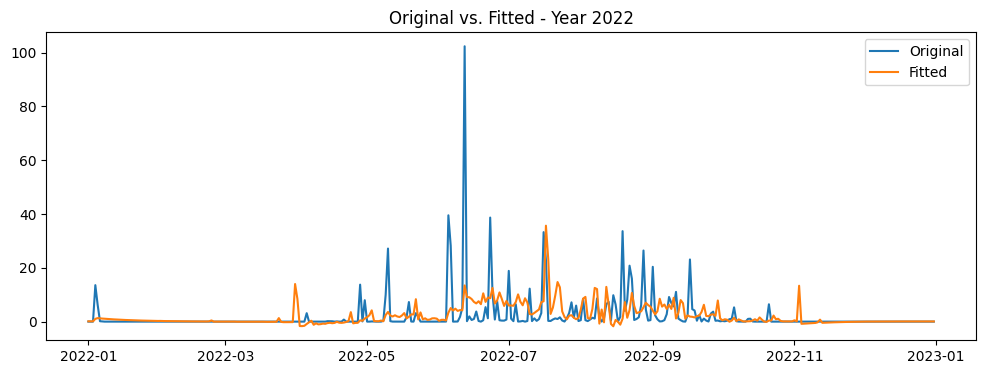

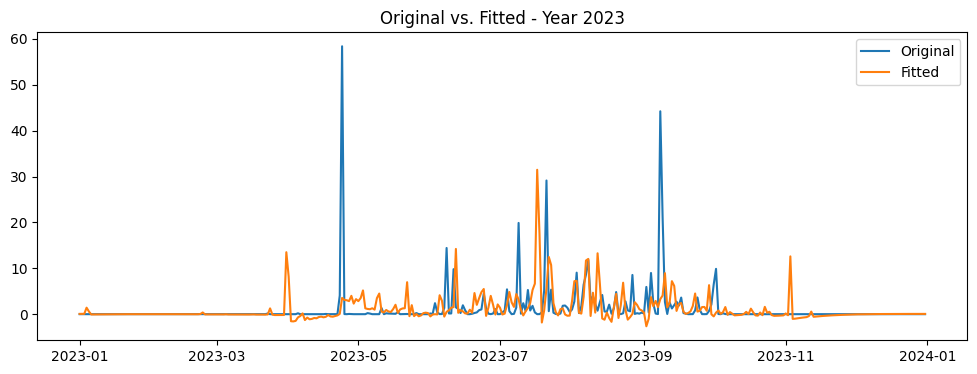

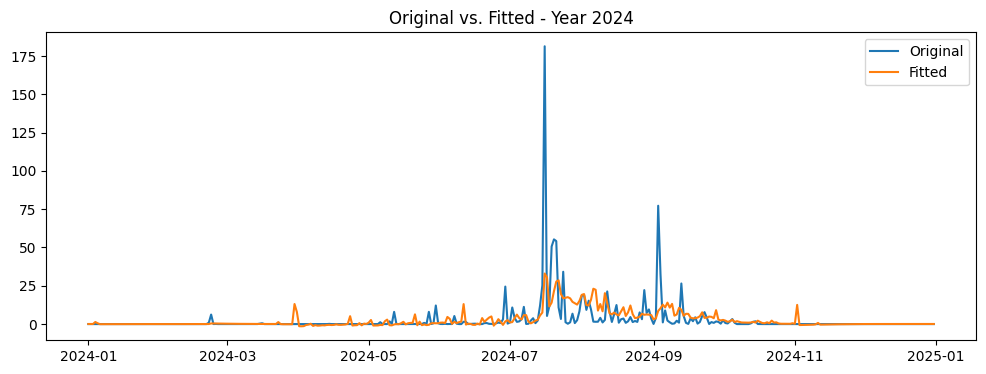

In [79]:
# rain_series vs fitted for each individual year

import pandas as pd
import matplotlib.pyplot as plt


# Convert the index to datetime objects if it's not already
df.index = pd.to_datetime(df.index)

# Group the data by year
for year, year_data in df.groupby(df.index.year):
    rain_series_year = year_data['Precipitation_Corrected_(mm/day)']
    fitted_year = hw_model_rain.fittedvalues[year_data.index]

    plt.figure(figsize=(12, 4))
    plt.plot(rain_series_year, label='Original')
    plt.plot(fitted_year, label='Fitted')
    plt.title(f'Original vs. Fitted - Year {year}')
    plt.legend()
    plt.show()

### Forecast 2025

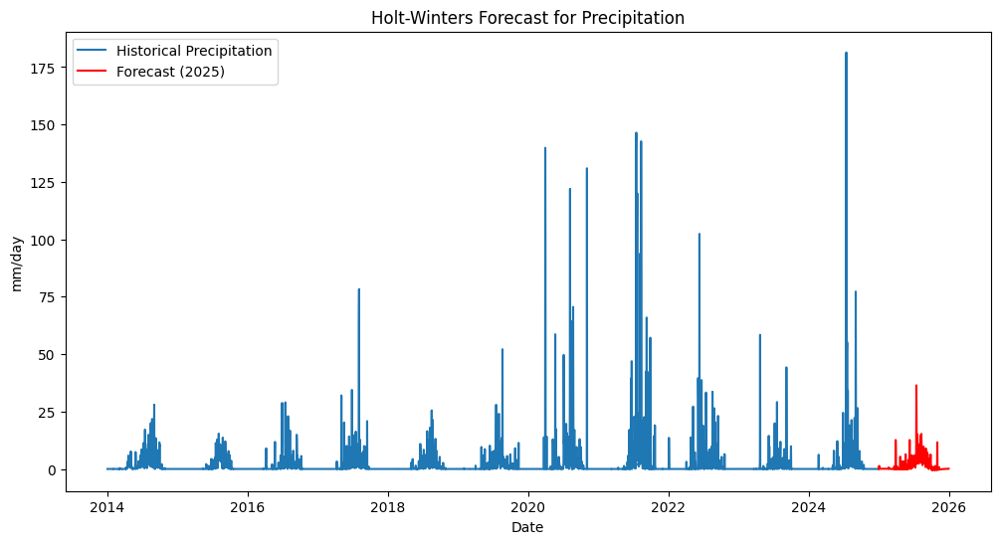

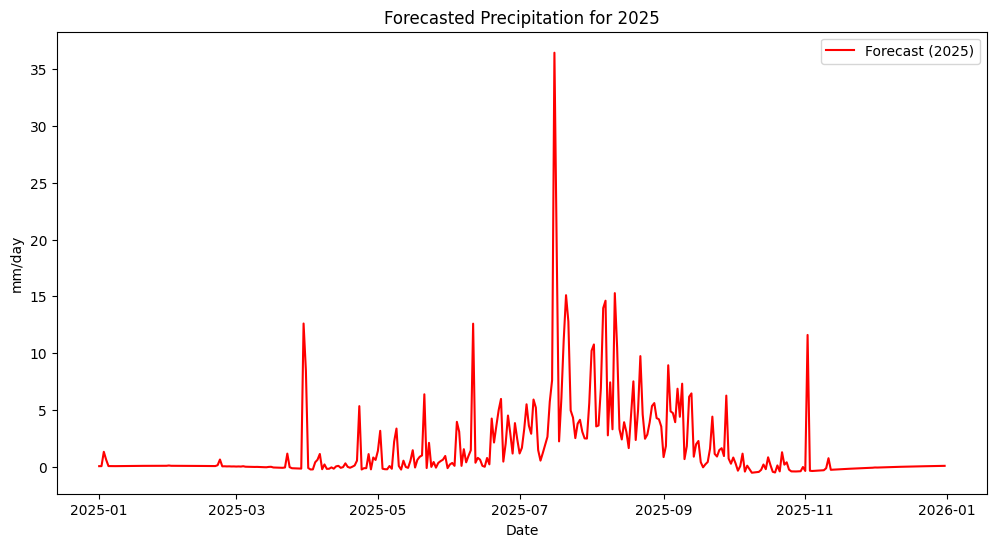

In [80]:
# Forecast next 365 days
forecast_rain =  hw_model_rain.forecast(365)


#visualise all years
plt.figure(figsize=(12, 6))
plt.plot(rain_series, label="Historical Precipitation")
plt.plot(forecast_rain.index, forecast_rain, label="Forecast (2025)", color='red')
plt.title("Holt-Winters Forecast for Precipitation")
plt.xlabel("Date")
plt.ylabel("mm/day")
plt.legend()
plt.show()

#visualise forecast
plt.figure(figsize=(12, 6))
plt.plot(forecast_rain.index, forecast_rain, label="Forecast (2025)", color='red')
plt.title("Forecasted Precipitation for 2025")
plt.xlabel("Date")
plt.ylabel("mm/day")
plt.legend()
plt.show()

### Model Evaluation (Train: 2014-2023, Test: 2024)

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


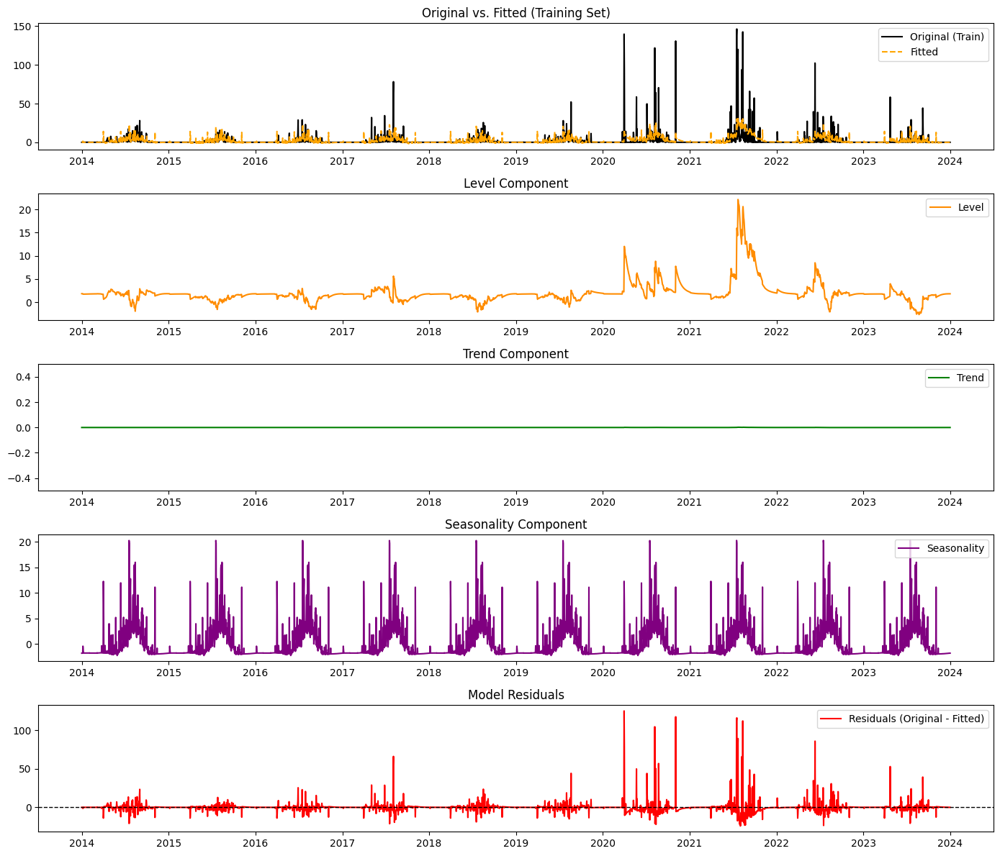

In [81]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
import numpy as np

# Train-test split (last 365 days as test set)
train = rain_series[:-365]
test = rain_series[-365:]

# Fit Holt-Winters model on training data
hw_model_eval = ExponentialSmoothing(
    train,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

# Forecast using Holt-Winters
test_pred_hw = hw_model_eval.forecast(365)

# Benchmark: Naive Forecast (each prediction = previous day's value)

test_pred_naive = test.shift(1)

# For the first day, use the last value from training
test_pred_naive.iloc[0] = train.iloc[-1]


# Extract components
level = hw_model_eval.level
trend = hw_model_eval.trend
season = hw_model_eval.season
fitted = hw_model_eval.fittedvalues

# Compute residuals (train set only)
residuals = train - fitted

# Plot all components
plt.figure(figsize=(14, 12))

# Original vs. Fitted
plt.subplot(5, 1, 1)
plt.plot(train, label="Original (Train)", color="black")
plt.plot(fitted, label="Fitted", linestyle="--", color="orange")
plt.title("Original vs. Fitted (Training Set)")
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label="Level", color="darkorange")
plt.title("Level Component")
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label="Trend", color="green")
plt.ylim(-0.5,0.5)
plt.title("Trend Component")
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label="Seasonality", color="purple")
plt.title("Seasonality Component")
plt.legend()

# Residuals
plt.subplot(5, 1, 5)
plt.plot(residuals, label="Residuals (Original - Fitted)", color="red")
plt.axhline(0, linestyle="--", color="black", linewidth=1)
plt.title("Model Residuals")
plt.legend()

plt.tight_layout()
plt.show()


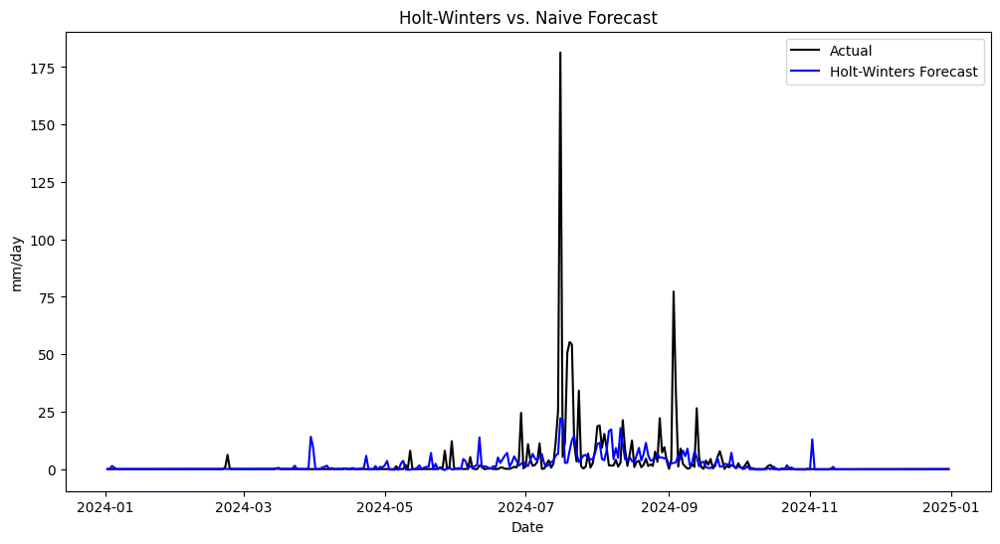

Performance Comparison:
Holt-Winters Annual → MAE: 2.968, RMSE: 11.043, R-Squared: 0.160, sMAPE: 165.987%
Naive Forecast → MAE: 3.242, RMSE: 14.325, R-Squared: -0.413, sMAPE: 130.349%


In [82]:
test_residuals = test - test_pred_hw

# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(test.index, test, label="Actual", color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Forecast", color='blue')
#plt.plot(test_pred_naive.index, test_pred_naive, label="Naive Forecast", linestyle="--", color='red')
#plt.plot(test_residuals.index, test_residuals, label="Residuals (Actual - Holt Winters)", color='purple')
#plt.axhline(0, linestyle="--", color="green", linewidth=1)
plt.title("Holt-Winters vs. Naive Forecast")
plt.xlabel("Date")
plt.ylabel("mm/day")
plt.legend()
plt.show()

def rmse(y,t):
  return np.sqrt(np.mean((y-t)**2))

# Evaluation: Holt-Winters
mae_hw = mean_absolute_error(test, test_pred_hw)
rmse_hw = rmse(test, test_pred_hw)

# Evaluation: Naive
mae_naive = mean_absolute_error(test, test_pred_naive)
rmse_naive = rmse(test, test_pred_naive)

# R²
from sklearn.metrics import r2_score

r2_hw = r2_score(test, test_pred_hw)
r2_naive = r2_score(test, test_pred_naive)


#sMAPE
import numpy as np

def smape(y_true, y_pred):
    numerator = np.abs(y_true - y_pred)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

hw_annual_smape = smape(test, test_pred_hw)
naive_smape = smape(test, test_pred_naive)


# Print comparison
print("Performance Comparison:")
print(f"Holt-Winters Annual → MAE: {mae_hw:.3f}, RMSE: {rmse_hw:.3f}, R-Squared: {r2_hw:.3f}, sMAPE: {hw_annual_smape:.3f}%")
print(f"Naive Forecast → MAE: {mae_naive:.3f}, RMSE: {rmse_naive:.3f}, R-Squared: {r2_naive:.3f}, sMAPE: {naive_smape:.3f}%")


### Recursive Forecasting (Every Month) - does not lead to any improvement, again emphasising that accurately modelling precipitation using a univariate approach without access to large scale ensemble models and extensive weather data is very difficult

In [83]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Select the temperature series and interpolate missing values
series = df['Precipitation_Corrected_(mm/day)']

#-------

# Define the full range of 2024
forecast_start = '2024-01-01'
forecast_end = '2024-12-31'
forecast_dates = pd.date_range(start=forecast_start, end=forecast_end, freq='D')

# Get initial training data: up to Dec 31, 2023
train_series = series[:'2024-01-01']

#-------

from datetime import timedelta

# Container to collect forecast results
monthly_forecasts = []

# Define monthly forecast dates for 2024
start_date = pd.to_datetime(forecast_start)
end_date = pd.to_datetime(forecast_end)

# Loop over each month
while start_date <= end_date:
    # Define forecast window: one month
    forecast_window_end = (start_date + pd.DateOffset(months=1)) - timedelta(days=1)
    forecast_dates_month = pd.date_range(start=start_date, end=forecast_window_end, freq='D')

    # Fit Holt-Winters model on available data
    model = ExponentialSmoothing(
        train_series,
        trend='add',
        seasonal='add',
        seasonal_periods=365,
        initialization_method='estimated'
    ).fit()

    # Forecast one month ahead
    forecast = model.forecast(len(forecast_dates_month))
    forecast.name = 'Forecast'
    forecast.index = forecast_dates_month

    # Store forecast
    monthly_forecasts.append(forecast)

    # Update training series with actual observed data from that month (real case)
    # In real use, replace forecast with real 2024 data when available
    actual_observed = series[forecast_dates_month]  # simulate using real 2024 data
    train_series = pd.concat([train_series, actual_observed])

    # Move to the next month
    start_date = forecast_window_end + timedelta(days=1)


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/usr/local/lib/python3.11/dist-packages/statsmode

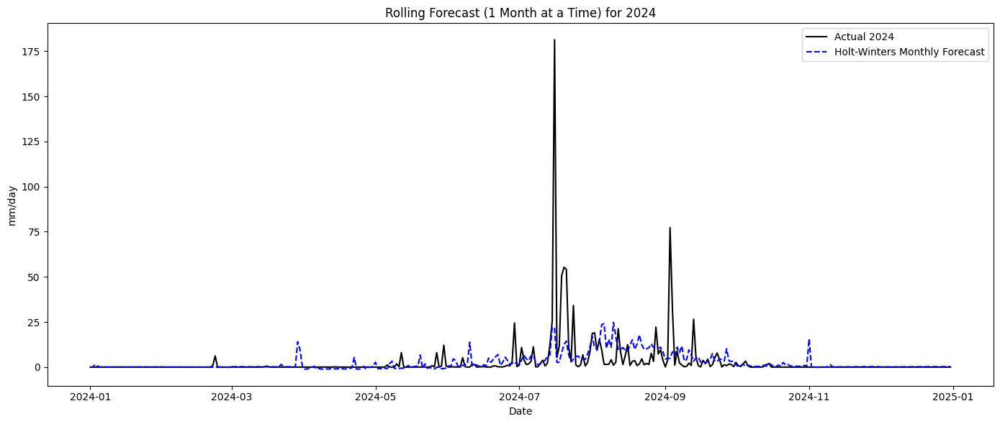

In [84]:
# Combine all forecasts into one series
full_rolling_forecast = pd.concat(monthly_forecasts)

# Extract actual values from 2024
actual_2024 = series['2024-01-01':'2024-12-31']

residuals_monthly = actual_2024 - full_rolling_forecast

# Plot forecast vs actual
plt.figure(figsize=(14, 6))
plt.plot(actual_2024, label='Actual 2024', color='black')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Forecast', color='blue', linestyle='--')
#plt.plot(residuals_monthly, label='Residuals', color='red')
#plt.axhline(0, linestyle="--", color="green", linewidth=1)
plt.title("Rolling Forecast (1 Month at a Time) for 2024")
plt.xlabel("Date")
plt.ylabel("mm/day")
plt.legend()
plt.tight_layout()
plt.show()

In [85]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

mae_monthly_forecast = mean_absolute_error(actual_2024, full_rolling_forecast)
rmse_monthly_forecast = rmse(actual_2024, full_rolling_forecast)
r2_score_monthly_forecast = r2_score(actual_2024, full_rolling_forecast)

print(f"Rolling Forecast MAE: {mae_monthly_forecast:.3f}")
print(f"Rolling Forecast RMSE: {rmse_monthly_forecast:.3f}")
print(f"Rolling Forecast R-Squared: {r2_score_monthly_forecast:.3f}")


# Calculate sMAPE for entire 2024
hw_monthly_smape = smape(actual_2024, full_rolling_forecast)

print(f"Overall sMAPE for Rolling Holt-Winters Forecast (2024): {hw_monthly_smape:.2f}%")

Rolling Forecast MAE: 3.195
Rolling Forecast RMSE: 10.998
Rolling Forecast R-Squared: 0.165
Overall sMAPE for Rolling Holt-Winters Forecast (2024): 166.49%


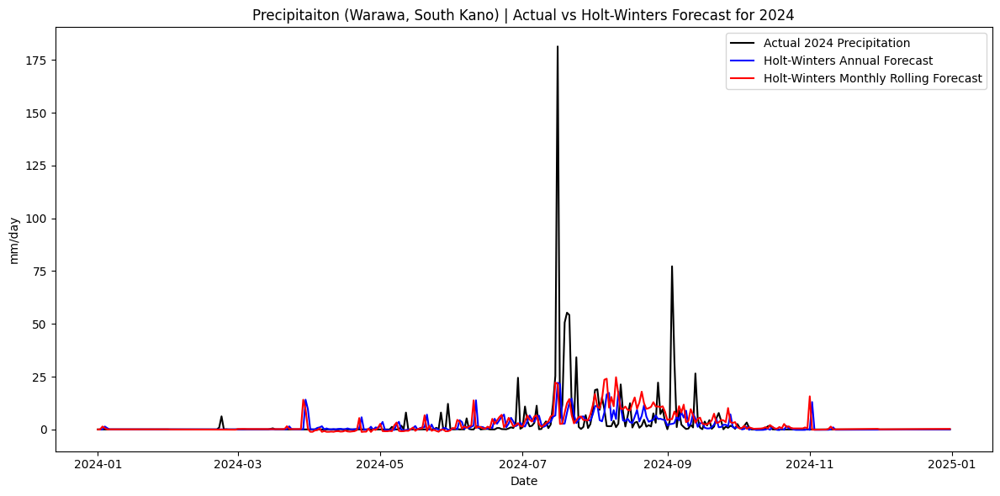

,HW Annual Forecast,| Naive Forecast (benchmark),| HW Monthly Rolling Forecast
Metric,,,
MAE,2.967592,3.242137,3.195096
RMSE,11.042658,14.325358,10.998279
R-squared (>0.8 is good),0.160236,-0.413257,0.164810
sMAPE % (<10% is good),165.987113,130.349495,166.487172


In [86]:
# COMPARISON CHART AND EVALUATION TABLE


# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(actual_2024, label='Actual 2024 Precipitation', color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Annual Forecast", color='blue')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Rolling Forecast', color='red')
#plt.plot(residuals_monthly, label='Residuals (Actual - HW monthly forecast)')
#plt.axhline(0, linestyle="--", color="grey", linewidth=1)

plt.title("Precipitaiton (Warawa, South Kano) | Actual vs Holt-Winters Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("mm/day")
plt.legend()
plt.tight_layout()
plt.show()




# table for mae_hw, rmse_hw, mae_naive, rmse_naive, mae_monthly_forecast, rmse_monthly_forecast, r2_hw, r2_naive, r2_score_monthly_forecast

import pandas as pd
# Create a dictionary to store the evaluation metrics
data = {
    'Metric': ['MAE', 'RMSE', 'R-squared (>0.8 is good)', 'sMAPE % (<10% is good)'],
    'HW Annual Forecast': [mae_hw, rmse_hw, r2_hw, hw_annual_smape],
    '| Naive Forecast (benchmark)': [mae_naive, rmse_naive, r2_naive, naive_smape],
    '| HW Monthly Rolling Forecast': [mae_monthly_forecast, rmse_monthly_forecast, r2_score_monthly_forecast, hw_monthly_smape]
}

# Create the DataFrame
evaluation_df = pd.DataFrame(data)

# Set 'Metric' column as index
evaluation_df = evaluation_df.set_index('Metric')

# Display the DataFrame
evaluation_df

# Average Wind Speed Time Series Analysis

## A) Holt-Winters

### Modelling

In [87]:
vars_of_int

['Temperature_at_2_Meters_Average_(C)',
 'Temperature_at_2_Meters_Maximum_(C)',
 'Temperature_at_2_Meters_Minimum_(C)',
 'Relative_Humidity_at_2_Meters_(%)',
 'Precipitation_Corrected_(mm/day)',
 'Wind_Speed_at_2_Meters_Average_(m/s)',
 'Wind_Speed_at_2_Meters_Maximum_(m/s)',
 'Wind_Speed_at_2_Meters_Minimum_(m/s)',
 'Wind_Direction_at_2_Meters_(Degrees)',
 'Surface_Soil_Wetness_(1)',
 'Root_Zone_Soil_Wetness_(1)',
 'Profile_Soil_Moisture_(1)']

Visual Inspection and Preprocessing

In [88]:
#Imports

import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing


# Select surface soil wetness column
avg_wind_series = df['Wind_Speed_at_2_Meters_Average_(m/s)']


avg_wind_series

,Wind_Speed_at_2_Meters_Average_(m/s)
Date,
2014-01-01,0.90
2014-01-02,1.07
2014-01-03,1.33
2014-01-04,1.34
2014-01-05,1.23
...,...
2024-12-27,1.06
2024-12-28,1.01
2024-12-29,1.08


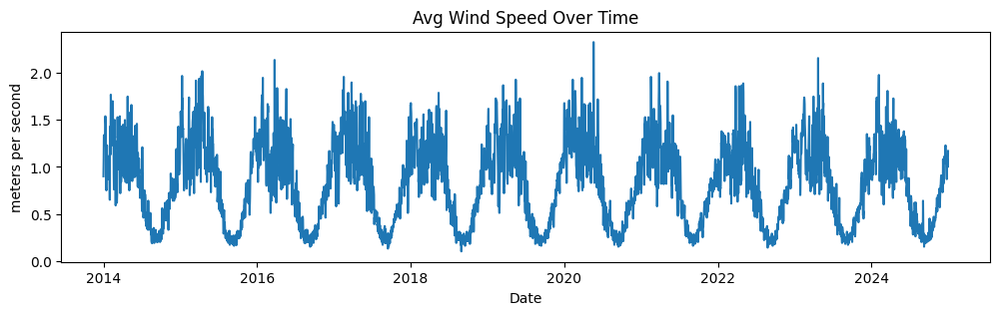

In [89]:
# Plot to check trend & seasonality
plt.figure(figsize=(12, 3))
plt.plot(avg_wind_series)
plt.title("Avg Wind Speed Over Time")
plt.ylabel("meters per second")
plt.xlabel("Date")
plt.show()

In [90]:
#check missing values
print(avg_wind_series.isna().sum())

0


Model Fitting

In [91]:
#FITTING THE MODEL

# Seasonality length: 365 for daily data with yearly seasonality
season_length = 365

# Fit Holt-Winters additive model (trend + seasonality)
hw_model_avg_wind = ExponentialSmoothing(
    avg_wind_series,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Inspecting Level, Trend, Seasonal Components and Residuals

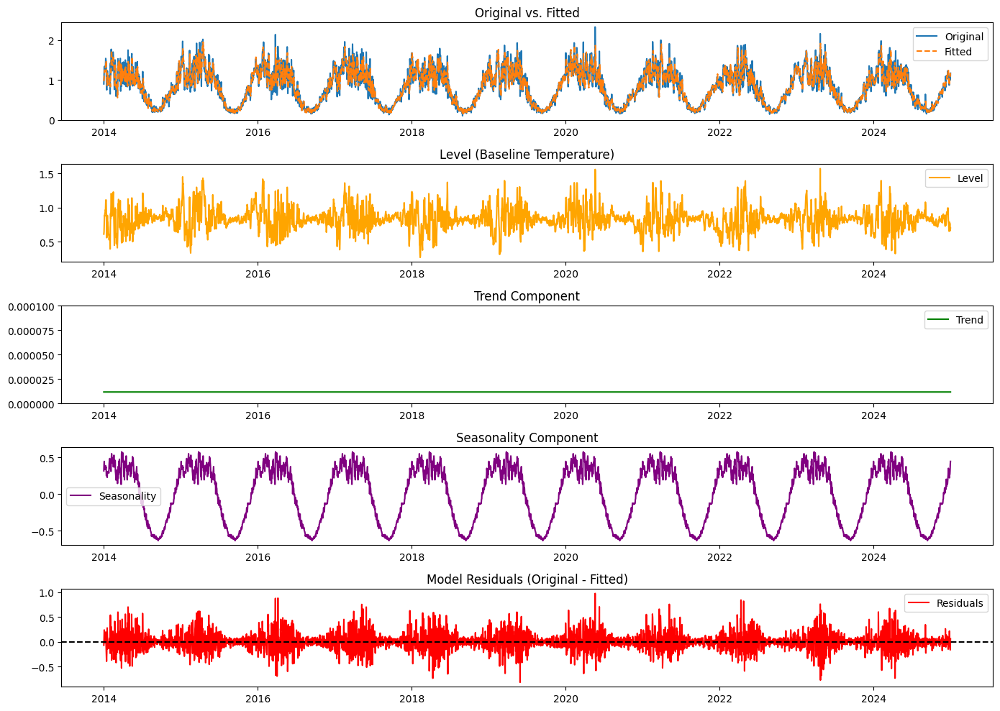

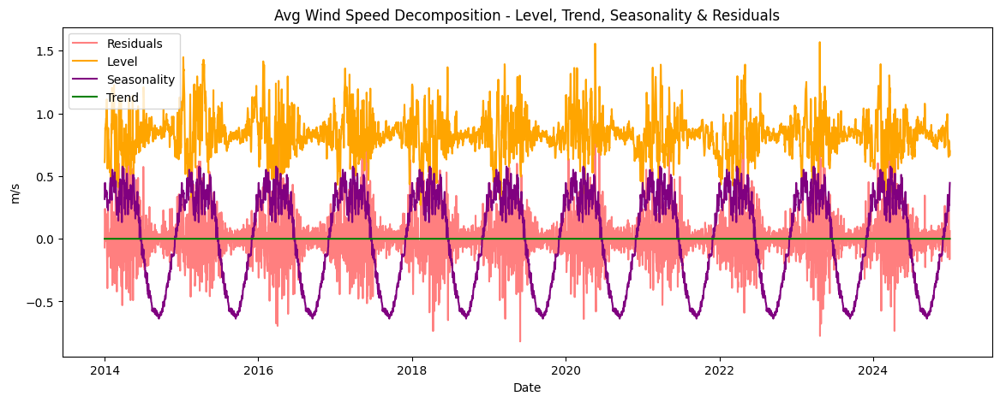

In [92]:
residuals = avg_wind_series - hw_model_avg_wind.fittedvalues

#PLOTTING TREND LEVEL AND SEASONALITY

import matplotlib.pyplot as plt

# Get components
level = hw_model_avg_wind.level
trend = hw_model_avg_wind.trend
season = hw_model_avg_wind.season
fitted = hw_model_avg_wind.fittedvalues

# Create subplots
plt.figure(figsize=(14, 10))

# Original series and fitted values
plt.subplot(5, 1, 1)
plt.plot(avg_wind_series, label='Original')
plt.plot(fitted, label='Fitted', linestyle='--')
plt.title('Original vs. Fitted')
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label='Level', color='orange')
plt.title('Level (Baseline Temperature)')
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label='Trend', color='green')
plt.title('Trend Component')
plt.ylim(0,0.0001)
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label='Seasonality', color='purple')
plt.title('Seasonality Component')
plt.legend()

#R Residuals

plt.subplot(5,1,5)
plt.plot(residuals, label='Residuals', color='red')
plt.title('Model Residuals (Original - Fitted)')
plt.axhline(0, color='black', linestyle='--')
plt.legend()


plt.tight_layout()
plt.show()



#plotting all-in-one

plt.figure(figsize=(14, 5))
#plt.plot(fitted, label='Fitted')
plt.plot(residuals, label='Residuals', color='red', alpha = 0.5)
plt.plot(level, label='Level', color='orange')
plt.plot(season, label='Seasonality', color='purple')
plt.plot(trend, label='Trend', color='green')

plt.legend()
plt.title("Avg Wind Speed Decomposition - Level, Trend, Seasonality & Residuals")
plt.ylabel("m/s")
plt.xlabel("Date")
plt.show()


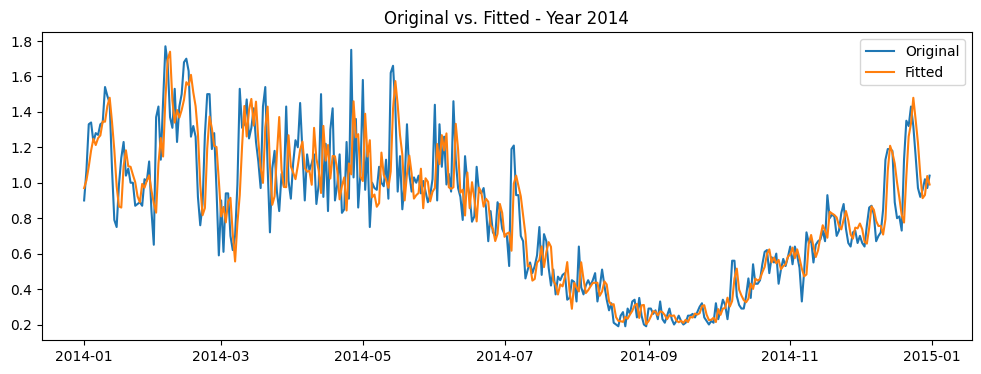

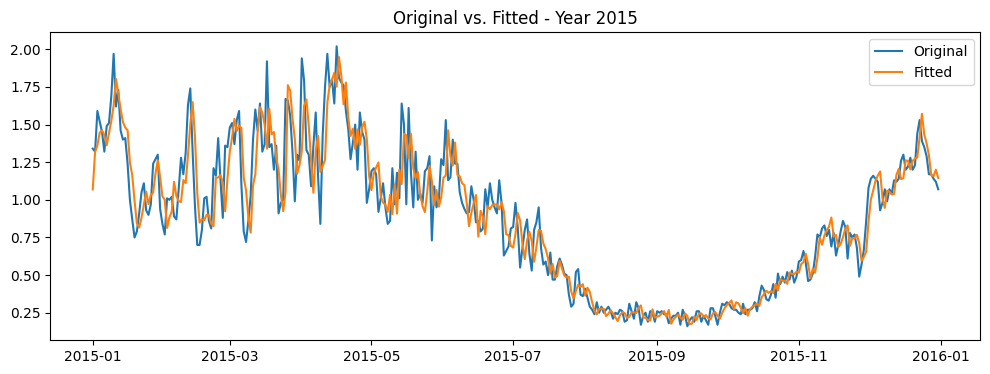

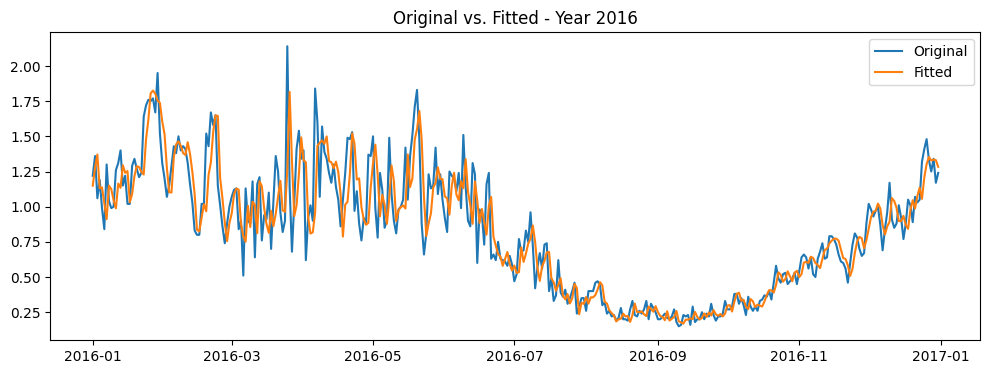

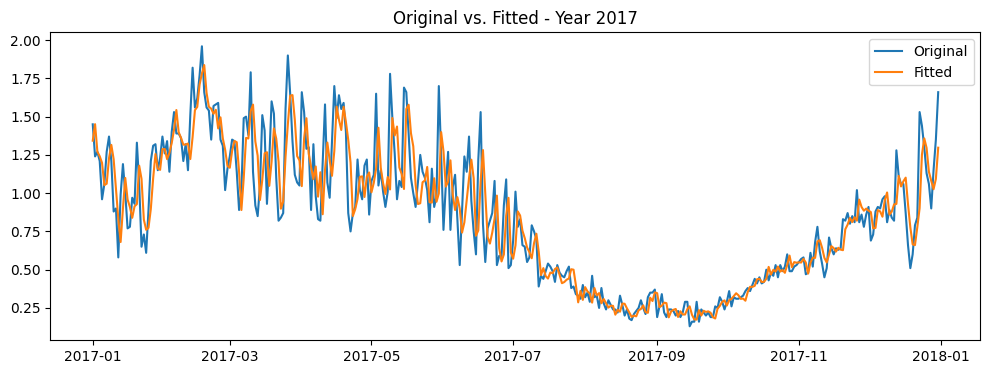

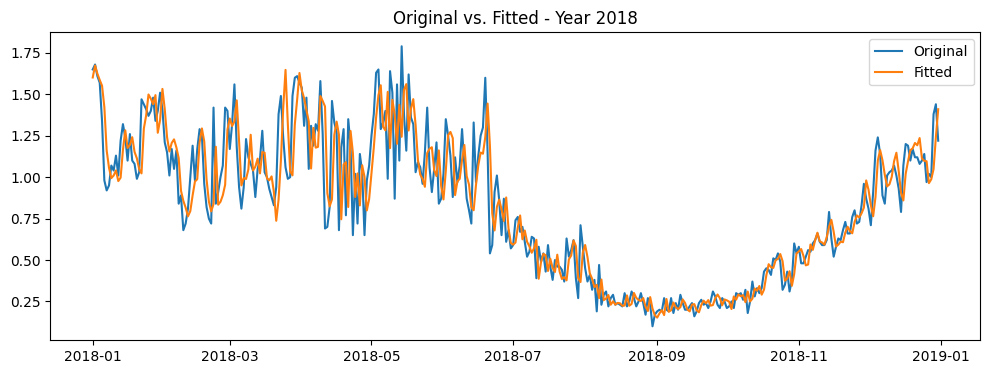

...

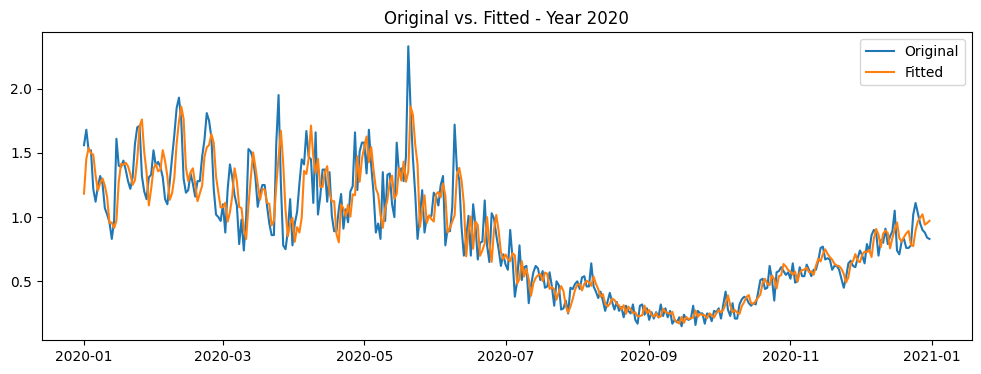

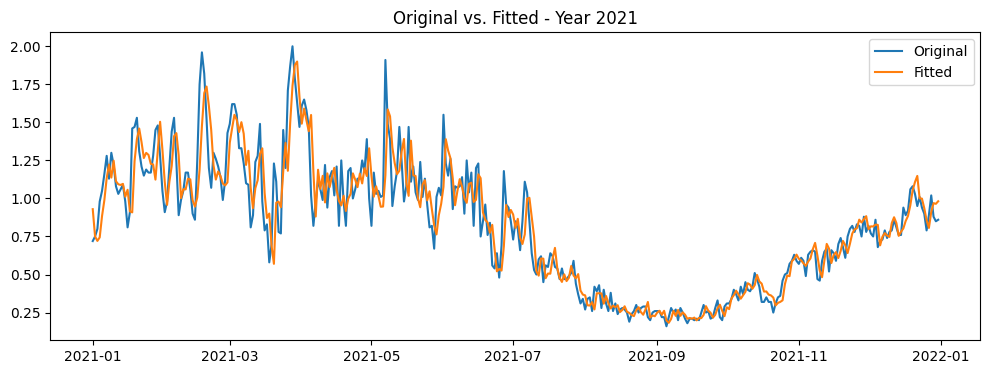

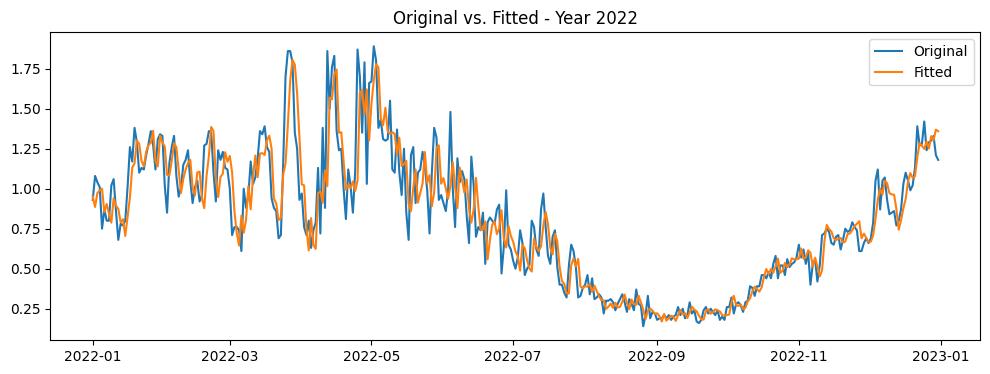

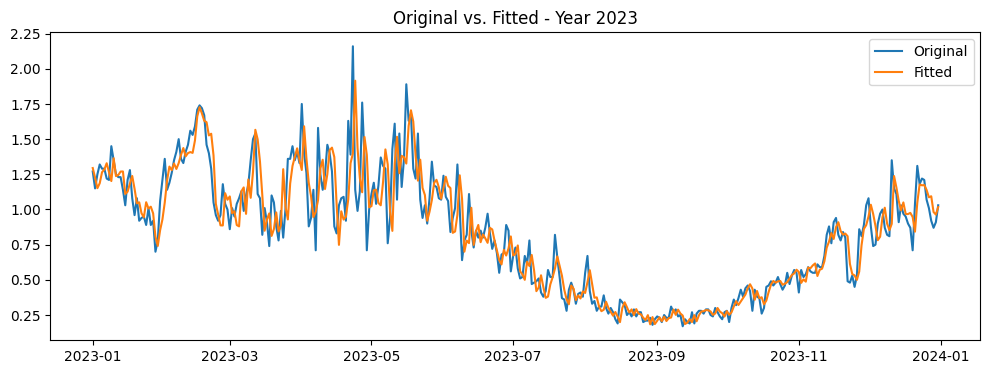

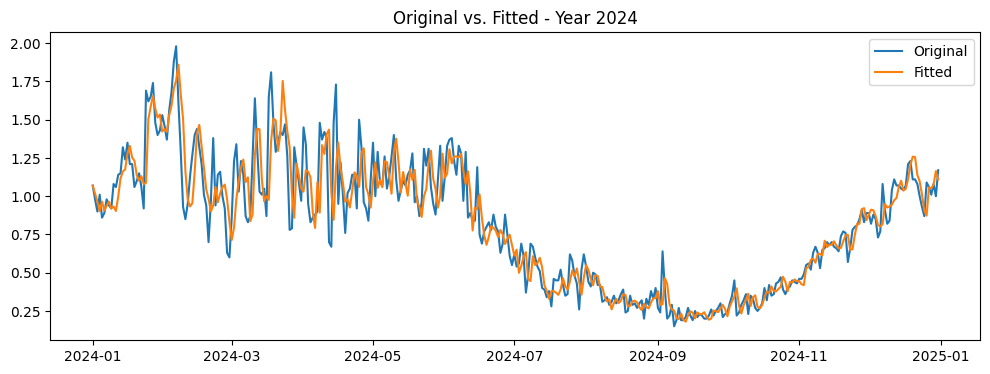

In [93]:
# avg_wind_series vs fitted for each individual year

import pandas as pd
import matplotlib.pyplot as plt


# Convert the index to datetime objects if it's not already
df.index = pd.to_datetime(df.index)

# Group the data by year
for year, year_data in df.groupby(df.index.year):
    avg_wind_series_year = year_data['Wind_Speed_at_2_Meters_Average_(m/s)']
    fitted_year = hw_model_avg_wind.fittedvalues[year_data.index]

    plt.figure(figsize=(12, 4))
    plt.plot(avg_wind_series_year, label='Original')
    plt.plot(fitted_year, label='Fitted')
    plt.title(f'Original vs. Fitted - Year {year}')
    plt.legend()
    plt.show()

### Forecast 2025

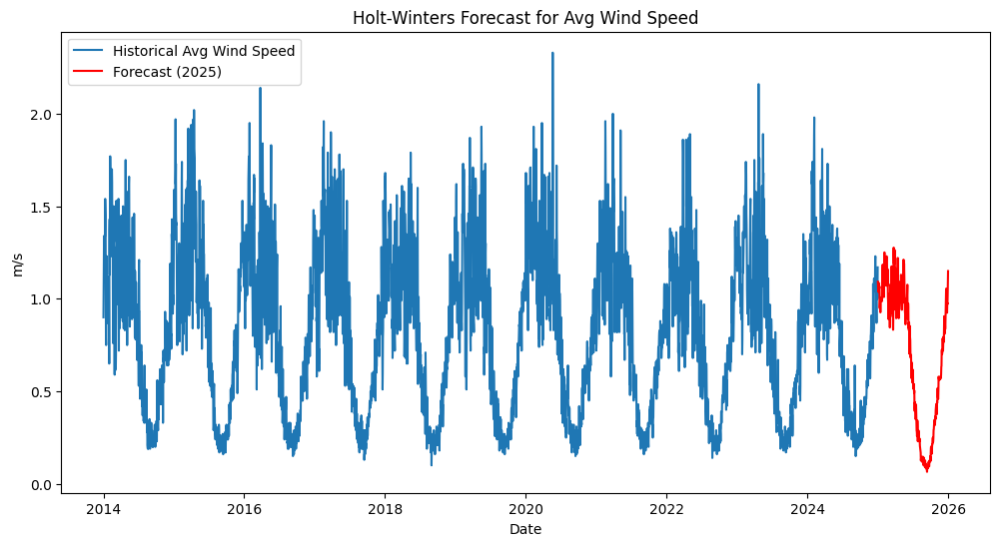

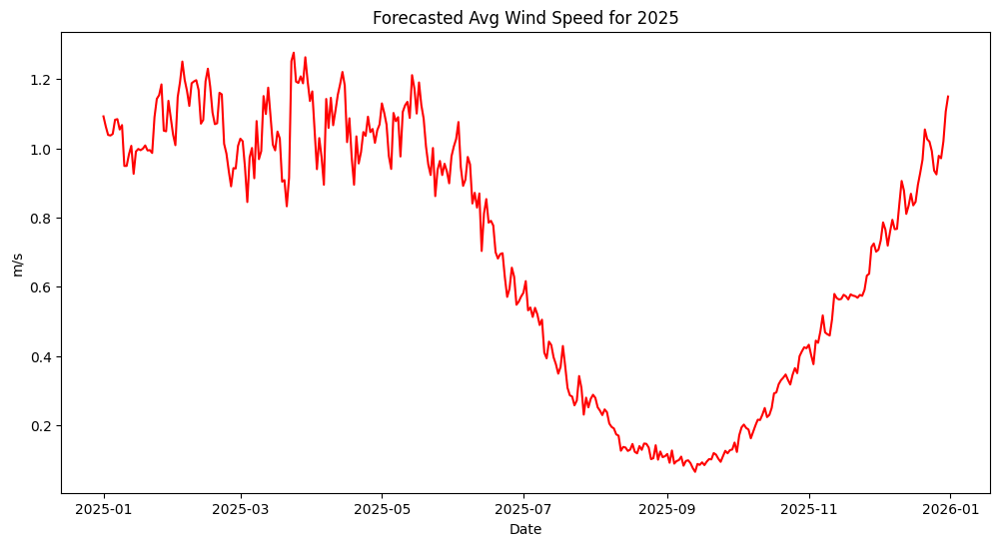

In [94]:
# Forecast next 365 days
forecast_avg_wind =  hw_model_avg_wind.forecast(365)


#visualise all years
plt.figure(figsize=(12, 6))
plt.plot(avg_wind_series, label="Historical Avg Wind Speed")
plt.plot(forecast_avg_wind.index, forecast_avg_wind, label="Forecast (2025)", color='red')
plt.title("Holt-Winters Forecast for Avg Wind Speed")
plt.xlabel("Date")
plt.ylabel("m/s")
plt.legend()
plt.show()

#visualise forecast
plt.figure(figsize=(12, 6))
plt.plot(forecast_avg_wind.index, forecast_avg_wind, label="Forecast (2025)", color='red')
plt.title("Forecasted Avg Wind Speed for 2025")
plt.xlabel("Date")
plt.ylabel("m/s")
plt.show()

### Model Evaluation (Train: 2014-2023, Test: 2024)

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


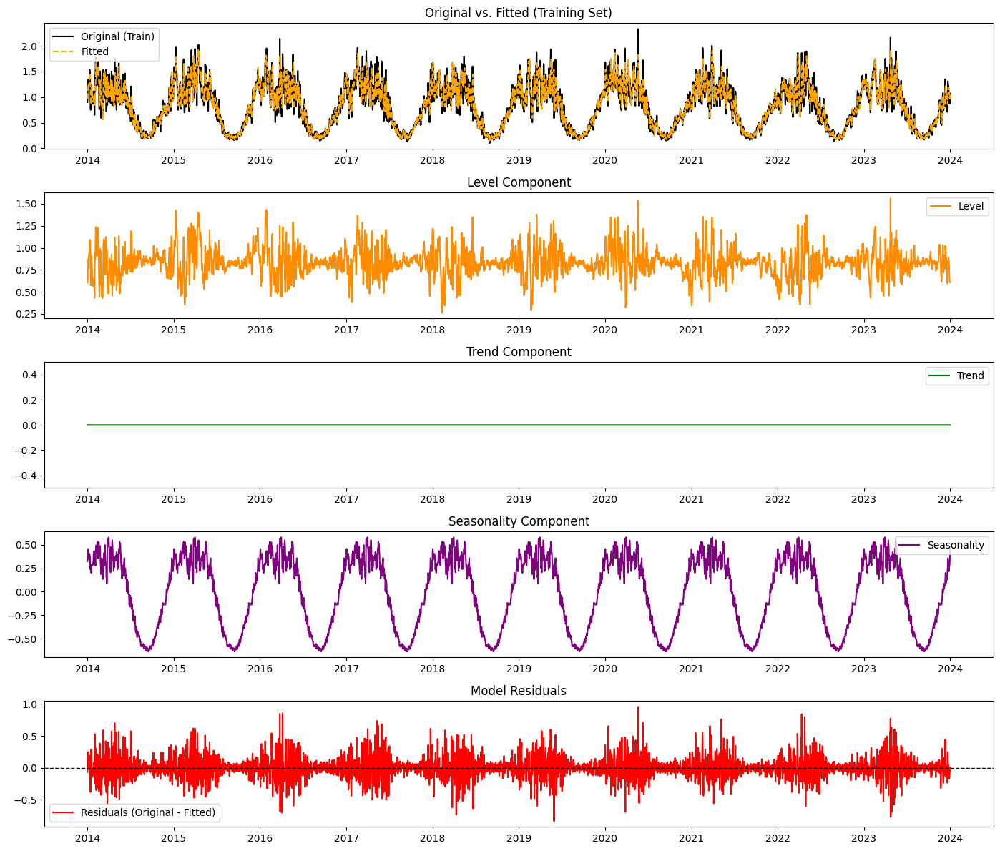

In [95]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
import numpy as np

# Train-test split (last 365 days as test set)
train = avg_wind_series[:-365]
test = avg_wind_series[-365:]

# Fit Holt-Winters model on training data
hw_model_eval = ExponentialSmoothing(
    train,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

# Forecast using Holt-Winters
test_pred_hw = hw_model_eval.forecast(365)

# Benchmark: Naive Forecast (each prediction = previous day's value)

test_pred_naive = test.shift(1)

# For the first day, use the last value from training
test_pred_naive.iloc[0] = train.iloc[-1]


# Extract components
level = hw_model_eval.level
trend = hw_model_eval.trend
season = hw_model_eval.season
fitted = hw_model_eval.fittedvalues

# Compute residuals (train set only)
residuals = train - fitted

# Plot all components
plt.figure(figsize=(14, 12))

# Original vs. Fitted
plt.subplot(5, 1, 1)
plt.plot(train, label="Original (Train)", color="black")
plt.plot(fitted, label="Fitted", linestyle="--", color="orange")
plt.title("Original vs. Fitted (Training Set)")
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label="Level", color="darkorange")
plt.title("Level Component")
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label="Trend", color="green")
plt.ylim(-0.5,0.5)
plt.title("Trend Component")
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label="Seasonality", color="purple")
plt.title("Seasonality Component")
plt.legend()

# Residuals
plt.subplot(5, 1, 5)
plt.plot(residuals, label="Residuals (Original - Fitted)", color="red")
plt.axhline(0, linestyle="--", color="black", linewidth=1)
plt.title("Model Residuals")
plt.legend()

plt.tight_layout()
plt.show()


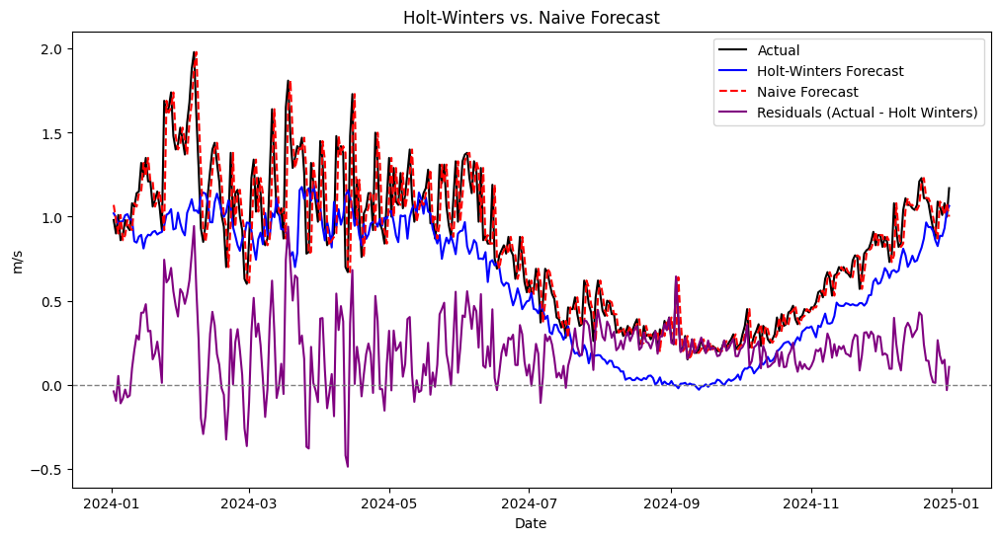

Performance Comparison:
Holt-Winters Annual → MAE: 0.243, RMSE: 0.292, R-Squared: 0.493, sMAPE: 55.234%
Naive Forecast → MAE: 0.119, RMSE: 0.179, R-Squared: 0.810, sMAPE: 15.353%


In [96]:
test_residuals = test - test_pred_hw

# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(test.index, test, label="Actual", color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Forecast", color='blue')
plt.plot(test_pred_naive.index, test_pred_naive, label="Naive Forecast", linestyle="--", color='red')
plt.plot(test_residuals.index, test_residuals, label="Residuals (Actual - Holt Winters)", color='purple')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)
plt.title("Holt-Winters vs. Naive Forecast")
plt.xlabel("Date")
plt.ylabel("m/s")
plt.legend()
plt.show()

def rmse(y,t):
  return np.sqrt(np.mean((y-t)**2))

# Evaluation: Holt-Winters
mae_hw = mean_absolute_error(test, test_pred_hw)
rmse_hw = rmse(test, test_pred_hw)

# Evaluation: Naive
mae_naive = mean_absolute_error(test, test_pred_naive)
rmse_naive = rmse(test, test_pred_naive)

# R²
from sklearn.metrics import r2_score

r2_hw = r2_score(test, test_pred_hw)
r2_naive = r2_score(test, test_pred_naive)


#sMAPE
import numpy as np

def smape(y_true, y_pred):
    numerator = np.abs(y_true - y_pred)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

hw_annual_smape = smape(test, test_pred_hw)
naive_smape = smape(test, test_pred_naive)


# Print comparison
print("Performance Comparison:")
print(f"Holt-Winters Annual → MAE: {mae_hw:.3f}, RMSE: {rmse_hw:.3f}, R-Squared: {r2_hw:.3f}, sMAPE: {hw_annual_smape:.3f}%")
print(f"Naive Forecast → MAE: {mae_naive:.3f}, RMSE: {rmse_naive:.3f}, R-Squared: {r2_naive:.3f}, sMAPE: {naive_smape:.3f}%")

### Recursive Forecasting (Every Month) for 2024 - reduces MAE and RSME by 20% ; reduces sMAPE from 55% to 26% ; R-Sq remains largely unchanged

In [97]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Select the temperature series and interpolate missing values
series = df['Wind_Speed_at_2_Meters_Average_(m/s)']

#-------

# Define the full range of 2024
forecast_start = '2024-01-01'
forecast_end = '2024-12-31'
forecast_dates = pd.date_range(start=forecast_start, end=forecast_end, freq='D')

# Get initial training data: up to Dec 31, 2023
train_series = series[:'2024-01-01']

#-------

from datetime import timedelta

# Container to collect forecast results
monthly_forecasts = []

# Define monthly forecast dates for 2024
start_date = pd.to_datetime(forecast_start)
end_date = pd.to_datetime(forecast_end)

# Loop over each month
while start_date <= end_date:
    # Define forecast window: one month
    forecast_window_end = (start_date + pd.DateOffset(months=1)) - timedelta(days=1)
    forecast_dates_month = pd.date_range(start=start_date, end=forecast_window_end, freq='D')

    # Fit Holt-Winters model on available data
    model = ExponentialSmoothing(
        train_series,
        trend='add',
        seasonal='add',
        seasonal_periods=365,
        initialization_method='estimated'
    ).fit()

    # Forecast one month ahead
    forecast = model.forecast(len(forecast_dates_month))
    forecast.name = 'Forecast'
    forecast.index = forecast_dates_month

    # Store forecast
    monthly_forecasts.append(forecast)

    # Update training series with actual observed data from that month (real case)
    # In real use, replace forecast with real 2024 data when available
    actual_observed = series[forecast_dates_month]  # simulate using real 2024 data
    train_series = pd.concat([train_series, actual_observed])

    # Move to the next month
    start_date = forecast_window_end + timedelta(days=1)


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  r

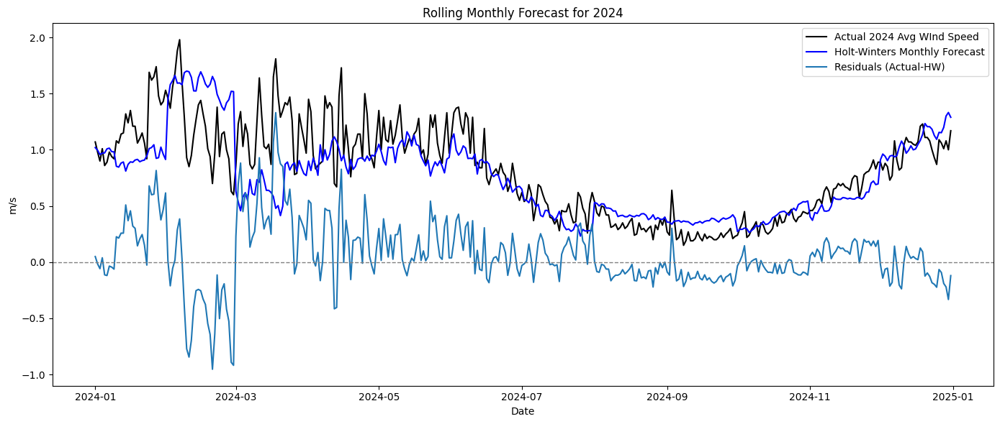

In [98]:
# Combine all forecasts into one series
full_rolling_forecast = pd.concat(monthly_forecasts)

# Extract actual values from 2024
actual_2024 = series['2024-01-01':'2024-12-31']

residuals_monthly = actual_2024 - full_rolling_forecast

# Plot forecast vs actual
plt.figure(figsize=(14, 6))
plt.plot(actual_2024, label='Actual 2024 Avg WInd Speed', color='black')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Forecast', color='blue')
plt.plot(residuals_monthly, label='Residuals (Actual-HW)')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)
plt.title("Rolling Monthly Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("m/s")
plt.legend()
plt.tight_layout()
plt.show()

In [99]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

mae_monthly_forecast = mean_absolute_error(actual_2024, full_rolling_forecast)
rmse_monthly_forecast = rmse(actual_2024, full_rolling_forecast)
r2_score_monthly_forecast = r2_score(actual_2024, full_rolling_forecast)

print(f"Rolling Forecast MAE: {mae_monthly_forecast:.3f}")
print(f"Rolling Forecast RMSE: {rmse_monthly_forecast:.3f}")
print(f"Rolling Forecast R-Squared: {r2_score_monthly_forecast:.3f}")


# Calculate sMAPE for entire 2024
hw_monthly_smape = smape(actual_2024, full_rolling_forecast)

print(f"Overall sMAPE for Rolling Holt-Winters Forecast (2024): {hw_monthly_smape:.2f}%")

Rolling Forecast MAE: 0.206
Rolling Forecast RMSE: 0.296
Rolling Forecast R-Squared: 0.478
Overall sMAPE for Rolling Holt-Winters Forecast (2024): 26.43%


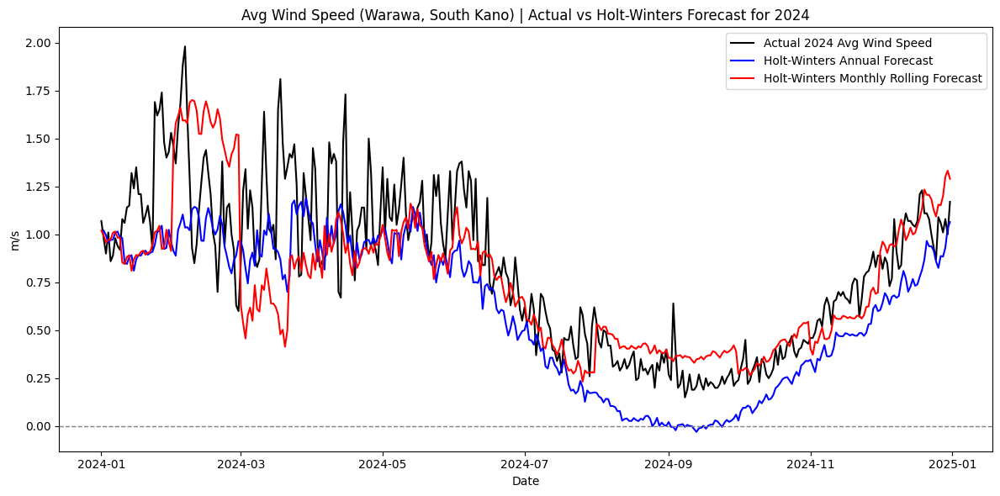

,HW Annual Forecast,| Naive Forecast (benchmark),| HW Monthly Rolling Forecast
Metric,,,
MAE,0.243193,0.119342,0.206024
RMSE,0.292035,0.178613,0.296045
R-squared (>0.8 is good),0.492956,0.810329,0.478036
sMAPE % (<10% is good),55.233685,15.352522,26.431011


In [100]:
# COMPARISON CHART AND EVALUATION TABLE


# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(actual_2024, label='Actual 2024 Avg Wind Speed', color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Annual Forecast", color='blue')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Rolling Forecast', color='red')
#plt.plot(residuals_monthly, label='Residuals (Actual - HW monthly forecast)')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)

plt.title("Avg Wind Speed (Warawa, South Kano) | Actual vs Holt-Winters Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("m/s")
plt.legend()
plt.tight_layout()
plt.show()




# table for mae_hw, rmse_hw, mae_naive, rmse_naive, mae_monthly_forecast, rmse_monthly_forecast, r2_hw, r2_naive, r2_score_monthly_forecast

import pandas as pd
# Create a dictionary to store the evaluation metrics
data = {
    'Metric': ['MAE', 'RMSE', 'R-squared (>0.8 is good)', 'sMAPE % (<10% is good)'],
    'HW Annual Forecast': [mae_hw, rmse_hw, r2_hw, hw_annual_smape],
    '| Naive Forecast (benchmark)': [mae_naive, rmse_naive, r2_naive, naive_smape],
    '| HW Monthly Rolling Forecast': [mae_monthly_forecast, rmse_monthly_forecast, r2_score_monthly_forecast, hw_monthly_smape]
}

# Create the DataFrame
evaluation_df = pd.DataFrame(data)

# Set 'Metric' column as index
evaluation_df = evaluation_df.set_index('Metric')

# Display the DataFrame
evaluation_df

# Max Wind Speed Time Series Analysis

## A) Holt-Winters

### Modelling

In [101]:
vars_of_int

['Temperature_at_2_Meters_Average_(C)',
 'Temperature_at_2_Meters_Maximum_(C)',
 'Temperature_at_2_Meters_Minimum_(C)',
 'Relative_Humidity_at_2_Meters_(%)',
 'Precipitation_Corrected_(mm/day)',
 'Wind_Speed_at_2_Meters_Average_(m/s)',
 'Wind_Speed_at_2_Meters_Maximum_(m/s)',
 'Wind_Speed_at_2_Meters_Minimum_(m/s)',
 'Wind_Direction_at_2_Meters_(Degrees)',
 'Surface_Soil_Wetness_(1)',
 'Root_Zone_Soil_Wetness_(1)',
 'Profile_Soil_Moisture_(1)']

Preprocessing and Visual Inspection

In [102]:
#Imports

import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing


# Select surface soil wetness column
max_wind_series = df['Wind_Speed_at_2_Meters_Maximum_(m/s)']


max_wind_series

,Wind_Speed_at_2_Meters_Maximum_(m/s)
Date,
2014-01-01,1.70
2014-01-02,1.85
2014-01-03,2.46
2014-01-04,2.46
2014-01-05,2.10
...,...
2024-12-27,1.92
2024-12-28,1.82
2024-12-29,1.86


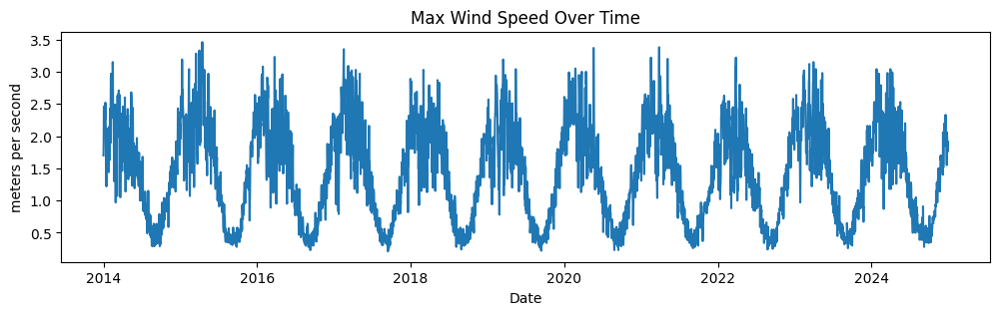

In [103]:
# Plot to check trend & seasonality
plt.figure(figsize=(12, 3))
plt.plot(max_wind_series)
#plt.plot(avg_wind_series)
plt.title("Max Wind Speed Over Time")
plt.ylabel("meters per second")
plt.xlabel("Date")
plt.show()

In [104]:
#check missing values
print(max_wind_series.isna().sum())

0


Model Fitting

In [105]:
#FITTING THE MODEL

# Seasonality length: 365 for daily data with yearly seasonality
season_length = 365

# Fit Holt-Winters additive model (trend + seasonality)
hw_model_max_wind = ExponentialSmoothing(
    max_wind_series,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


Inspecting Level, Trend, Seasonal Components and Residuals

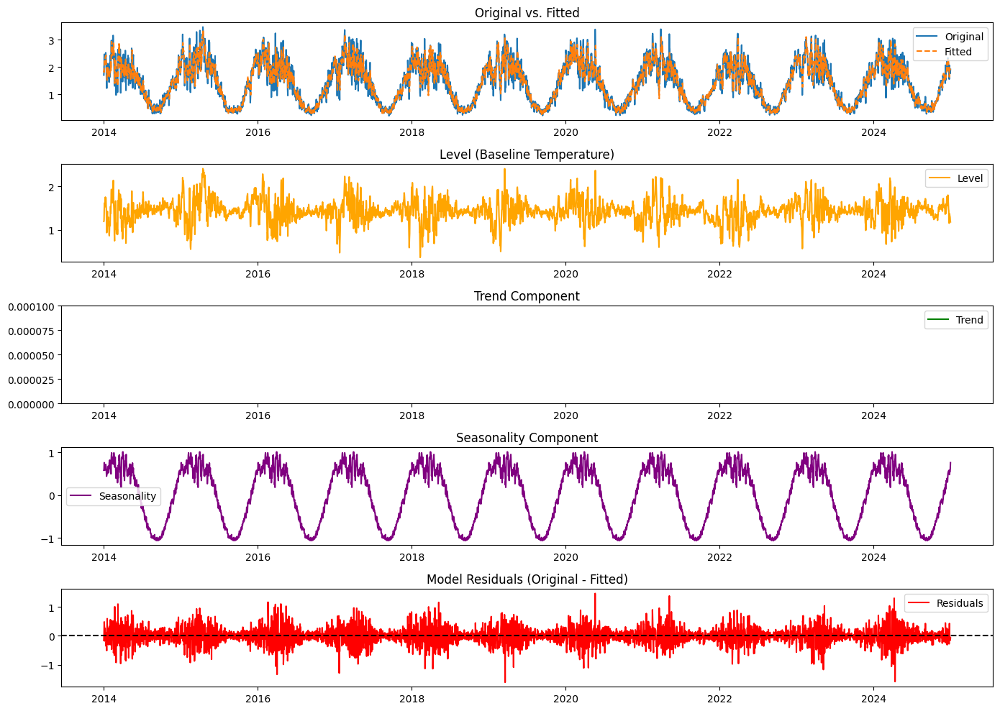

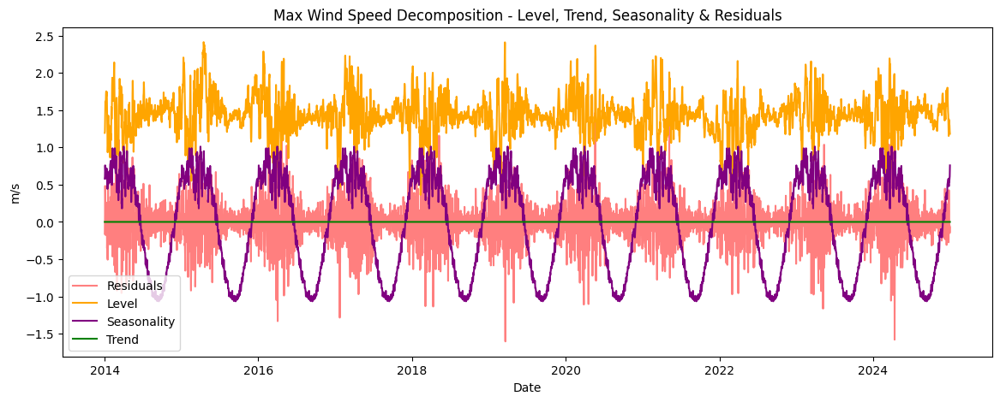

In [106]:
residuals = max_wind_series - hw_model_max_wind.fittedvalues

#PLOTTING TREND LEVEL AND SEASONALITY

import matplotlib.pyplot as plt

# Get components
level = hw_model_max_wind.level
trend = hw_model_max_wind.trend
season = hw_model_max_wind.season
fitted = hw_model_max_wind.fittedvalues

# Create subplots
plt.figure(figsize=(14, 10))

# Original series and fitted values
plt.subplot(5, 1, 1)
plt.plot(max_wind_series, label='Original')
plt.plot(fitted, label='Fitted', linestyle='--')
plt.title('Original vs. Fitted')
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label='Level', color='orange')
plt.title('Level (Baseline Temperature)')
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label='Trend', color='green')
plt.title('Trend Component')
plt.ylim(0,0.0001)
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label='Seasonality', color='purple')
plt.title('Seasonality Component')
plt.legend()

#R Residuals

plt.subplot(5,1,5)
plt.plot(residuals, label='Residuals', color='red')
plt.title('Model Residuals (Original - Fitted)')
plt.axhline(0, color='black', linestyle='--')
plt.legend()


plt.tight_layout()
plt.show()



#plotting all-in-one

plt.figure(figsize=(14, 5))
#plt.plot(fitted, label='Fitted')
plt.plot(residuals, label='Residuals', color='red', alpha = 0.5)
plt.plot(level, label='Level', color='orange')
plt.plot(season, label='Seasonality', color='purple')
plt.plot(trend, label='Trend', color='green')

plt.legend()
plt.title("Max Wind Speed Decomposition - Level, Trend, Seasonality & Residuals")
plt.ylabel("m/s")
plt.xlabel("Date")
plt.show()


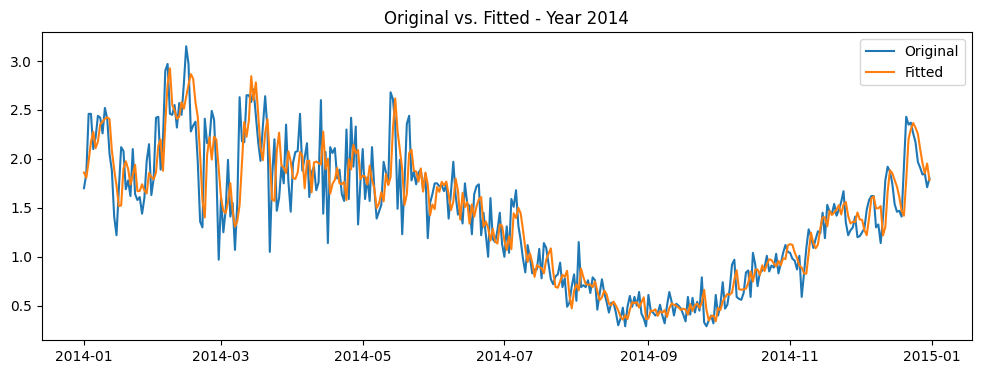

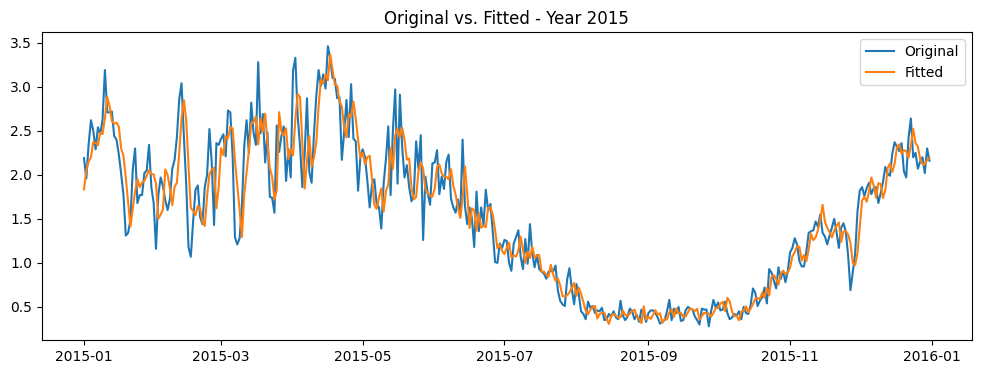

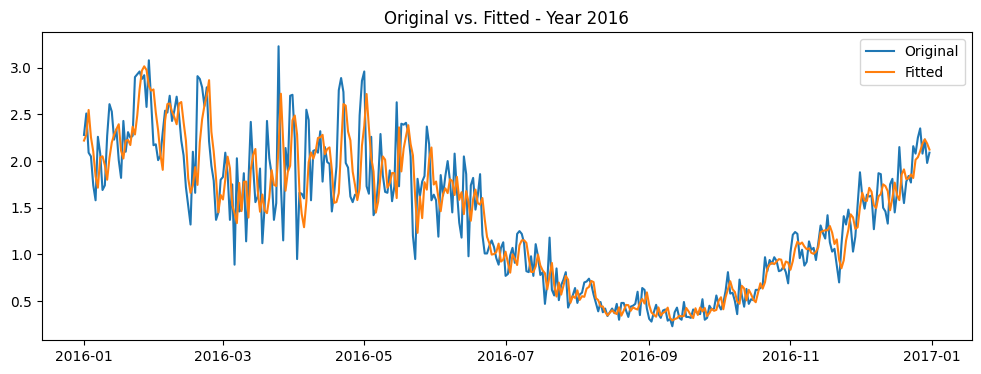

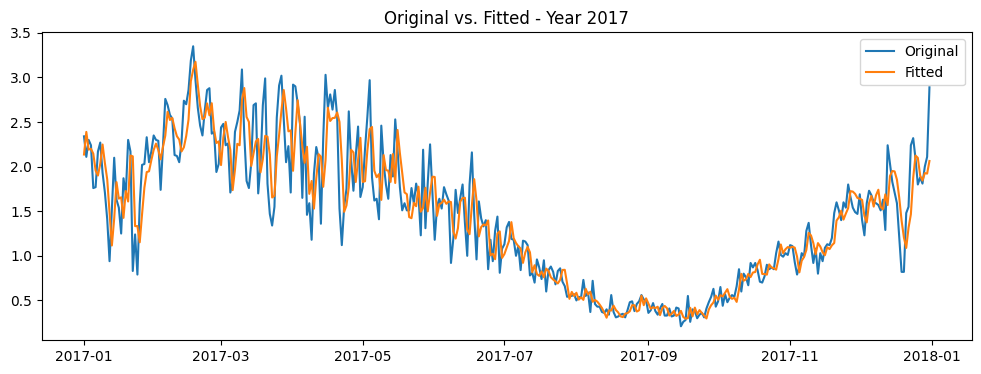

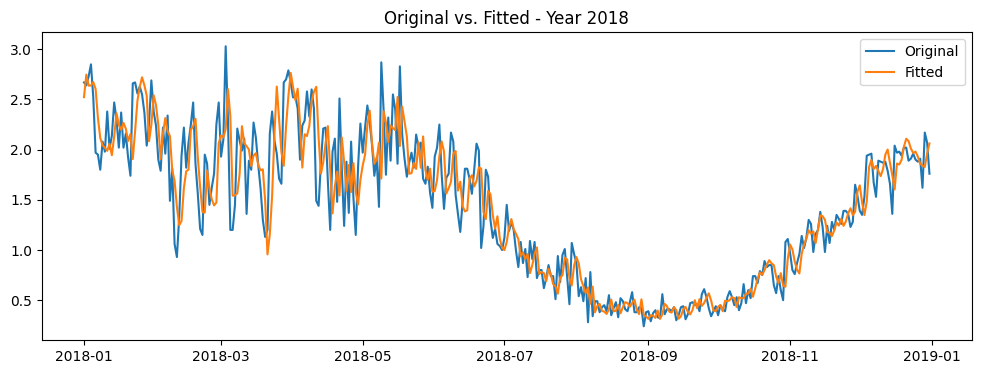

...

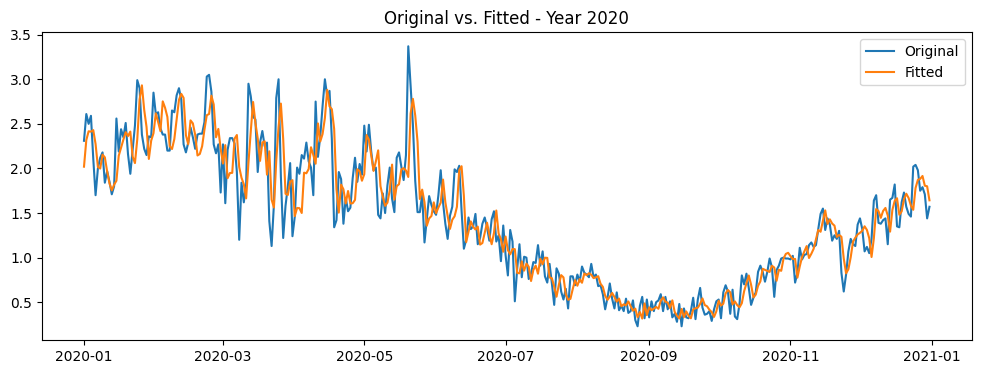

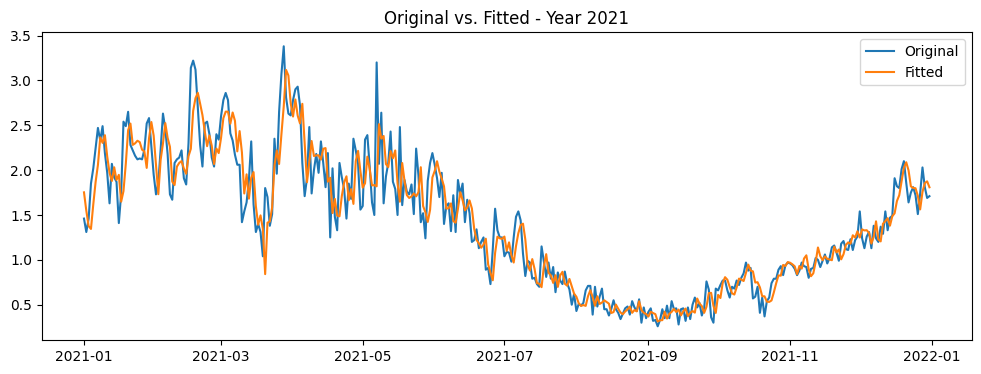

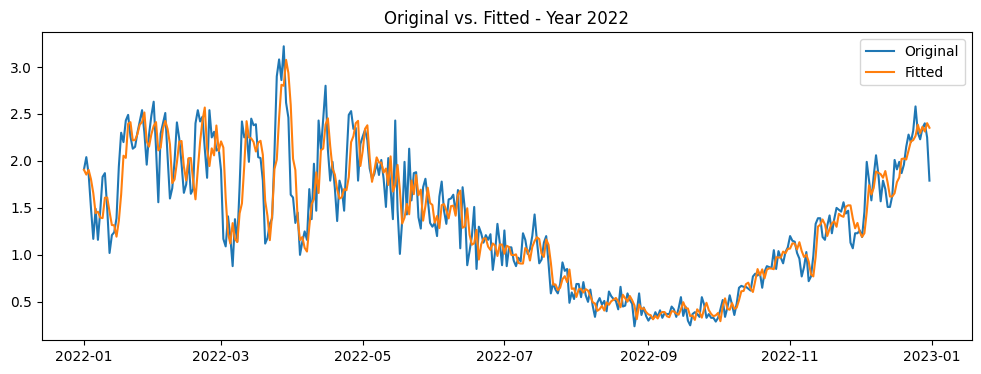

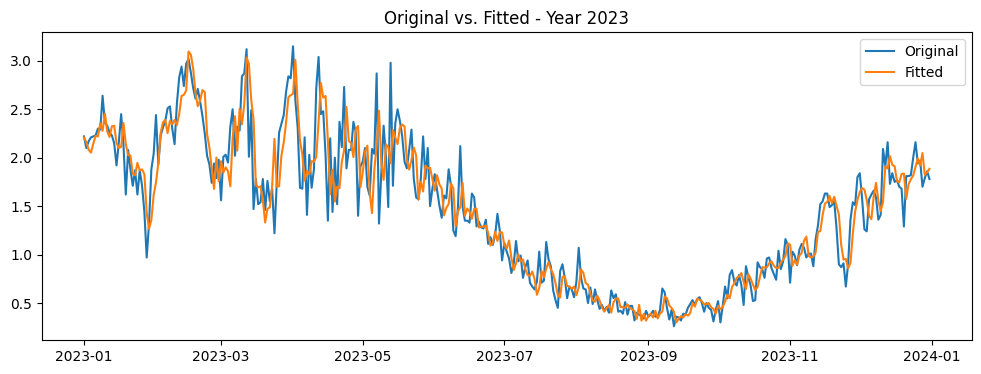

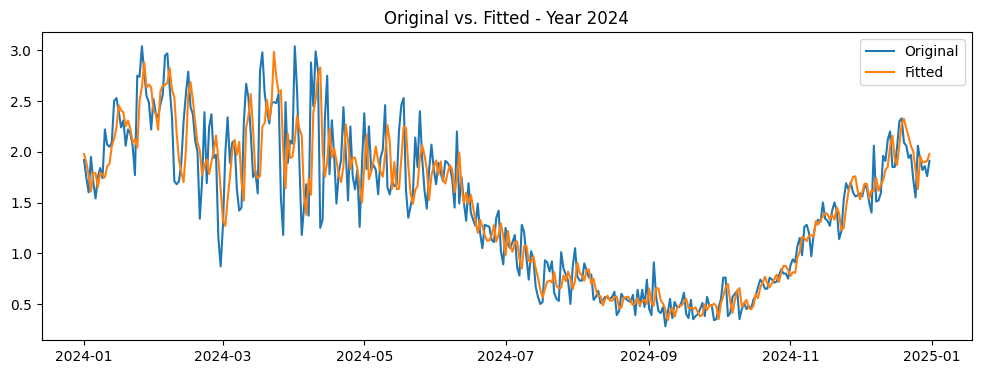

In [107]:
# max_wind_series vs fitted for each individual year

import pandas as pd
import matplotlib.pyplot as plt


# Convert the index to datetime objects if it's not already
df.index = pd.to_datetime(df.index)

# Group the data by year
for year, year_data in df.groupby(df.index.year):
    max_wind_series_year = year_data['Wind_Speed_at_2_Meters_Maximum_(m/s)']
    fitted_year = hw_model_max_wind.fittedvalues[year_data.index]

    plt.figure(figsize=(12, 4))
    plt.plot(max_wind_series_year, label='Original')
    plt.plot(fitted_year, label='Fitted')
    plt.title(f'Original vs. Fitted - Year {year}')
    plt.legend()
    plt.show()

### Forecast 2025

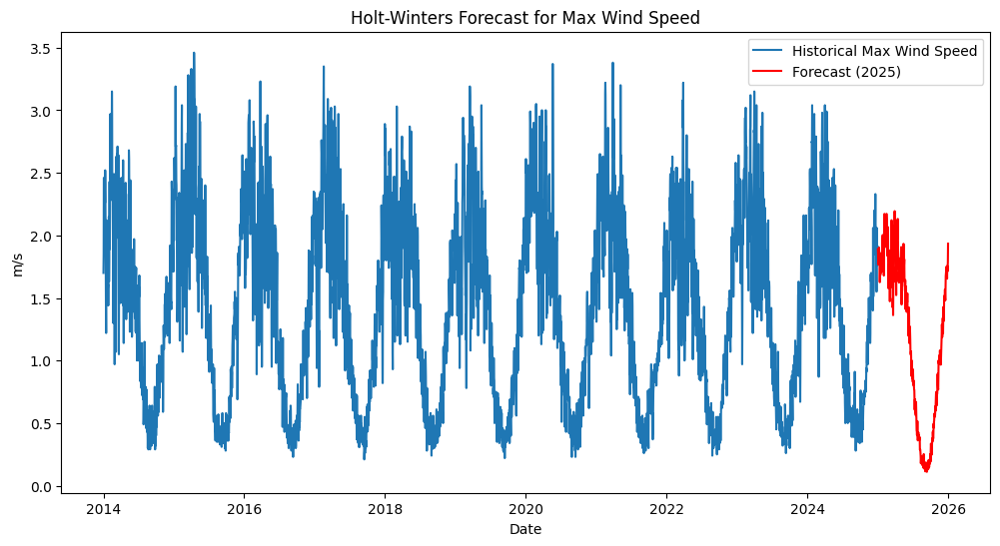

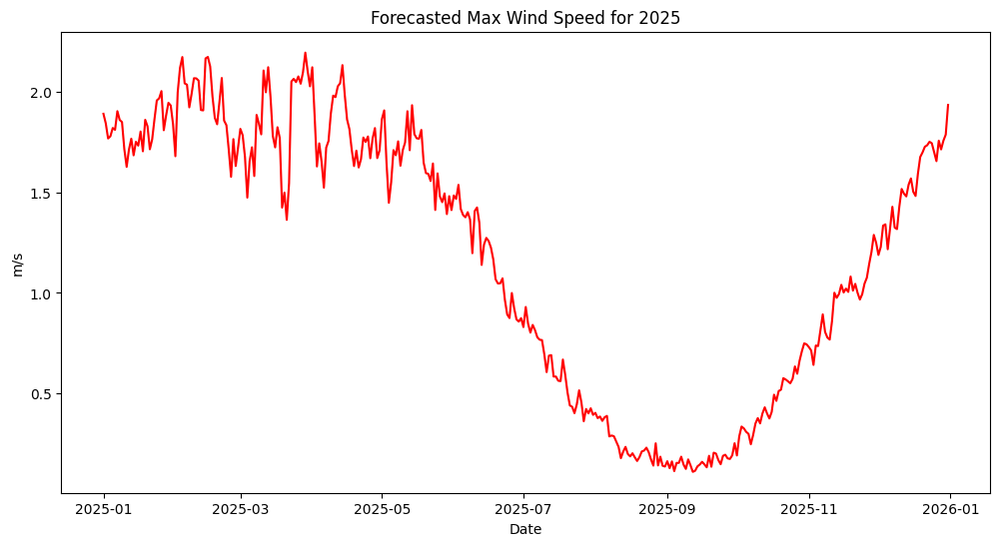

In [108]:
# Forecast next 365 days
forecast_max_wind =  hw_model_max_wind.forecast(365)


#visualise all years
plt.figure(figsize=(12, 6))
plt.plot(max_wind_series, label="Historical Max Wind Speed")
plt.plot(forecast_max_wind.index, forecast_max_wind, label="Forecast (2025)", color='red')
plt.title("Holt-Winters Forecast for Max Wind Speed")
plt.xlabel("Date")
plt.ylabel("m/s")
plt.legend()
plt.show()

#visualise forecast
plt.figure(figsize=(12, 6))
plt.plot(forecast_max_wind.index, forecast_max_wind, label="Forecast (2025)", color='red')
plt.title("Forecasted Max Wind Speed for 2025")
plt.xlabel("Date")
plt.ylabel("m/s")
plt.show()

### Model Evaluation (Train: 2014-2023, Test: 2024)

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(


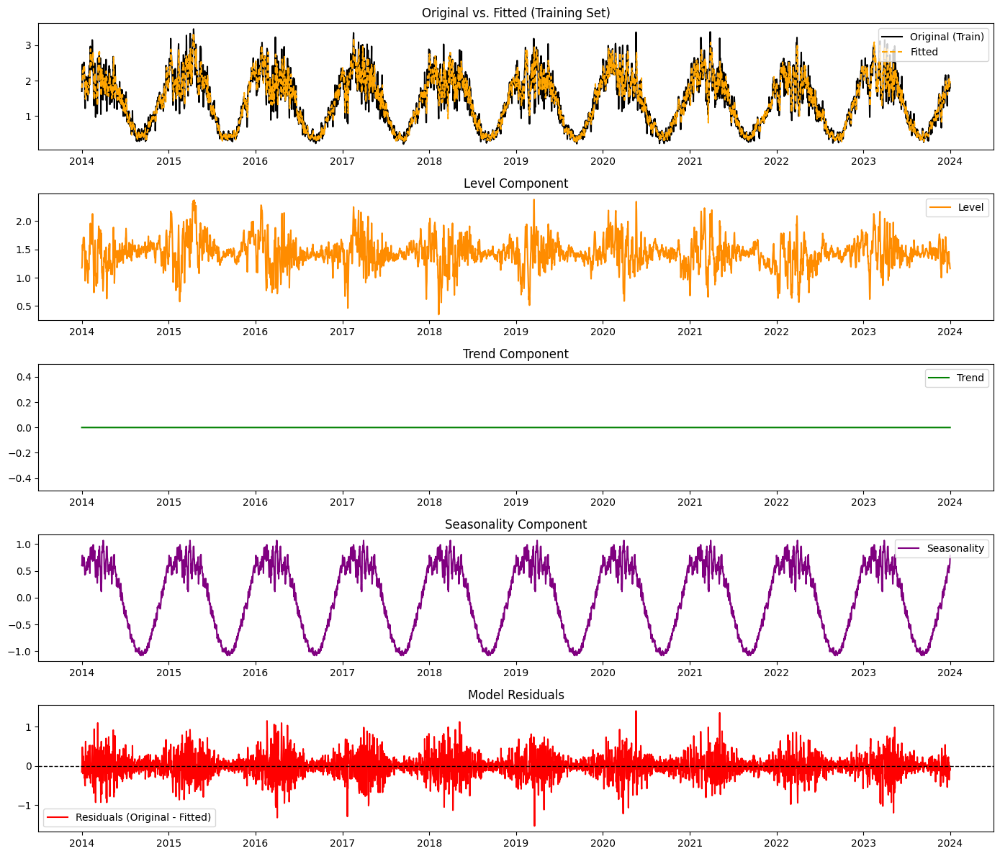

In [114]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
import numpy as np

# Train-test split (last 365 days as test set)
train = max_wind_series[:-365]
test = max_wind_series[-365:]

# Fit Holt-Winters model on training data
hw_model_eval = ExponentialSmoothing(
    train,
    trend='add',
    seasonal='add',
    seasonal_periods=season_length,
    initialization_method='estimated').fit()

# Forecast using Holt-Winters
test_pred_hw = hw_model_eval.forecast(365)

# Benchmark: Naive Forecast (each prediction = previous day's value)

test_pred_naive = test.shift(1)

# For the first day, use the last value from training
test_pred_naive.iloc[0] = train.iloc[-1]


# Extract components
level = hw_model_eval.level
trend = hw_model_eval.trend
season = hw_model_eval.season
fitted = hw_model_eval.fittedvalues

# Compute residuals (train set only)
residuals = train - fitted

# Plot all components
plt.figure(figsize=(14, 12))

# Original vs. Fitted
plt.subplot(5, 1, 1)
plt.plot(train, label="Original (Train)", color="black")
plt.plot(fitted, label="Fitted", linestyle="--", color="orange")
plt.title("Original vs. Fitted (Training Set)")
plt.legend()

# Level
plt.subplot(5, 1, 2)
plt.plot(level, label="Level", color="darkorange")
plt.title("Level Component")
plt.legend()

# Trend
plt.subplot(5, 1, 3)
plt.plot(trend, label="Trend", color="green")
plt.ylim(-0.5,0.5)
plt.title("Trend Component")
plt.legend()

# Seasonality
plt.subplot(5, 1, 4)
plt.plot(season, label="Seasonality", color="purple")
plt.title("Seasonality Component")
plt.legend()

# Residuals
plt.subplot(5, 1, 5)
plt.plot(residuals, label="Residuals (Original - Fitted)", color="red")
plt.axhline(0, linestyle="--", color="black", linewidth=1)
plt.title("Model Residuals")
plt.legend()

plt.tight_layout()
plt.show()


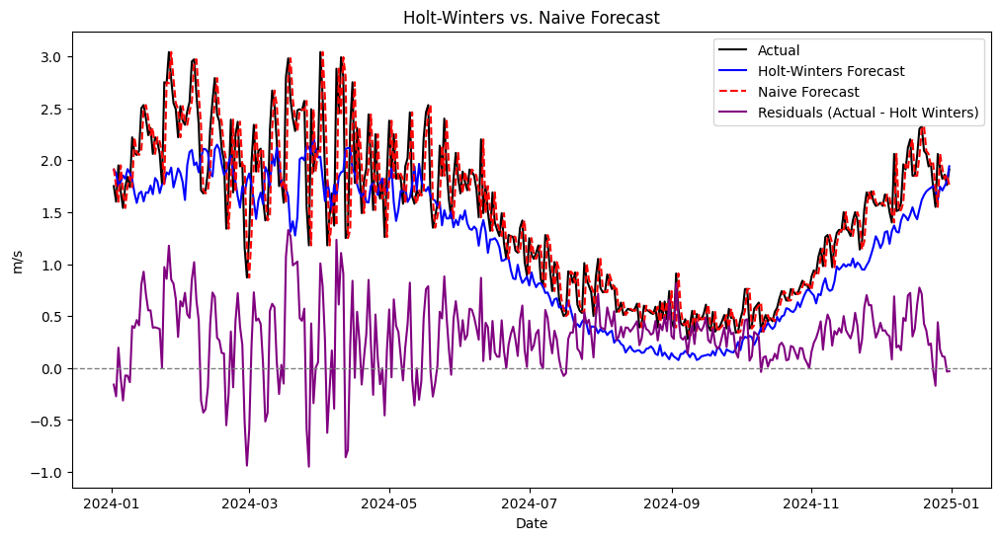

Performance Comparison:
Holt-Winters Annual → MAE: 0.378, RMSE: 0.453, R-Squared: 0.599, sMAPE: 39.485%
Naive Forecast → MAE: 0.223, RMSE: 0.327, R-Squared: 0.791, sMAPE: 16.323%


In [115]:
test_residuals = test - test_pred_hw

# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(test.index, test, label="Actual", color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Forecast", color='blue')
plt.plot(test_pred_naive.index, test_pred_naive, label="Naive Forecast", linestyle="--", color='red')
plt.plot(test_residuals.index, test_residuals, label="Residuals (Actual - Holt Winters)", color='purple')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)
plt.title("Holt-Winters vs. Naive Forecast")
plt.xlabel("Date")
plt.ylabel("m/s")
plt.legend()
plt.show()

def rmse(y,t):
  return np.sqrt(np.mean((y-t)**2))

# Evaluation: Holt-Winters
mae_hw = mean_absolute_error(test, test_pred_hw)
rmse_hw = rmse(test, test_pred_hw)

# Evaluation: Naive
mae_naive = mean_absolute_error(test, test_pred_naive)
rmse_naive = rmse(test, test_pred_naive)

# R²
from sklearn.metrics import r2_score

r2_hw = r2_score(test, test_pred_hw)
r2_naive = r2_score(test, test_pred_naive)


#sMAPE
import numpy as np

def smape(y_true, y_pred):
    numerator = np.abs(y_true - y_pred)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

hw_annual_smape = smape(test, test_pred_hw)
naive_smape = smape(test, test_pred_naive)


# Print comparison
print("Performance Comparison:")
print(f"Holt-Winters Annual → MAE: {mae_hw:.3f}, RMSE: {rmse_hw:.3f}, R-Squared: {r2_hw:.3f}, sMAPE: {hw_annual_smape:.3f}%")
print(f"Naive Forecast → MAE: {mae_naive:.3f}, RMSE: {rmse_naive:.3f}, R-Squared: {r2_naive:.3f}, sMAPE: {naive_smape:.3f}%")

### Recursive Forecasting (Every Month) for 2024 - no substantial improvement in evaluation metrics

In [116]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Select the temperature series and interpolate missing values
series = df['Wind_Speed_at_2_Meters_Maximum_(m/s)']

#-------

# Define the full range of 2024
forecast_start = '2024-01-01'
forecast_end = '2024-12-31'
forecast_dates = pd.date_range(start=forecast_start, end=forecast_end, freq='D')

# Get initial training data: up to Dec 31, 2023
train_series = series[:'2024-01-01']

#-------

from datetime import timedelta

# Container to collect forecast results
monthly_forecasts = []

# Define monthly forecast dates for 2024
start_date = pd.to_datetime(forecast_start)
end_date = pd.to_datetime(forecast_end)

# Loop over each month
while start_date <= end_date:
    # Define forecast window: one month
    forecast_window_end = (start_date + pd.DateOffset(months=1)) - timedelta(days=1)
    forecast_dates_month = pd.date_range(start=start_date, end=forecast_window_end, freq='D')

    # Fit Holt-Winters model on available data
    model = ExponentialSmoothing(
        train_series,
        trend='add',
        seasonal='add',
        seasonal_periods=365,
        initialization_method='estimated'
    ).fit()

    # Forecast one month ahead
    forecast = model.forecast(len(forecast_dates_month))
    forecast.name = 'Forecast'
    forecast.index = forecast_dates_month

    # Store forecast
    monthly_forecasts.append(forecast)

    # Update training series with actual observed data from that month (real case)
    # In real use, replace forecast with real 2024 data when available
    actual_observed = series[forecast_dates_month]  # simulate using real 2024 data
    train_series = pd.concat([train_series, actual_observed])

    # Move to the next month
    start_date = forecast_window_end + timedelta(days=1)


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  r

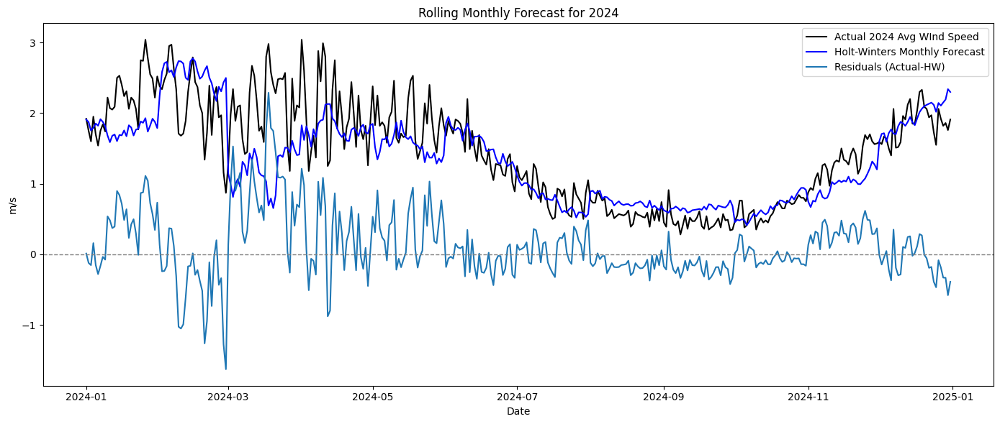

In [117]:
# Combine all forecasts into one series
full_rolling_forecast = pd.concat(monthly_forecasts)

# Extract actual values from 2024
actual_2024 = series['2024-01-01':'2024-12-31']

residuals_monthly = actual_2024 - full_rolling_forecast

# Plot forecast vs actual
plt.figure(figsize=(14, 6))
plt.plot(actual_2024, label='Actual 2024 Avg WInd Speed', color='black')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Forecast', color='blue')
plt.plot(residuals_monthly, label='Residuals (Actual-HW)')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)
plt.title("Rolling Monthly Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("m/s")
plt.legend()
plt.tight_layout()
plt.show()

In [118]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

mae_monthly_forecast = mean_absolute_error(actual_2024, full_rolling_forecast)
rmse_monthly_forecast = rmse(actual_2024, full_rolling_forecast)
r2_score_monthly_forecast = r2_score(actual_2024, full_rolling_forecast)

print(f"Rolling Forecast MAE: {mae_monthly_forecast:.3f}")
print(f"Rolling Forecast RMSE: {rmse_monthly_forecast:.3f}")
print(f"Rolling Forecast R-Squared: {r2_score_monthly_forecast:.3f}")


# Calculate sMAPE for entire 2024
hw_monthly_smape = smape(actual_2024, full_rolling_forecast)

print(f"Overall sMAPE for Rolling Holt-Winters Forecast (2024): {hw_monthly_smape:.2f}%")

Rolling Forecast MAE: 0.341
Rolling Forecast RMSE: 0.486
Rolling Forecast R-Squared: 0.538
Overall sMAPE for Rolling Holt-Winters Forecast (2024): 24.99%


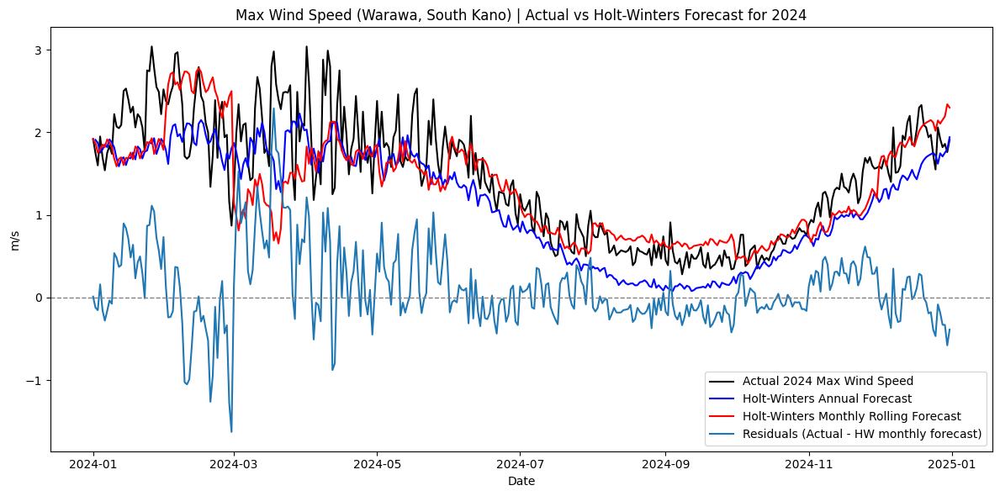

,HW Annual Forecast,| Naive Forecast (benchmark),| HW Monthly Rolling Forecast
Metric,,,
MAE,0.378021,0.223096,0.341273
RMSE,0.453145,0.326922,0.486218
R-squared (>0.8 is good),0.599157,0.791364,0.537782
sMAPE % (<10% is good),39.485350,16.322657,24.991431


In [119]:
# COMPARISON CHART AND EVALUATION TABLE


# Plot predictions
plt.figure(figsize=(12, 6))
plt.plot(actual_2024, label='Actual 2024 Max Wind Speed', color='black')
plt.plot(test_pred_hw.index, test_pred_hw, label="Holt-Winters Annual Forecast", color='blue')
plt.plot(full_rolling_forecast, label='Holt-Winters Monthly Rolling Forecast', color='red')
plt.plot(residuals_monthly, label='Residuals (Actual - HW monthly forecast)')
plt.axhline(0, linestyle="--", color="grey", linewidth=1)

plt.title("Max Wind Speed (Warawa, South Kano) | Actual vs Holt-Winters Forecast for 2024")
plt.xlabel("Date")
plt.ylabel("m/s")
plt.legend()
plt.tight_layout()
plt.show()




# table for mae_hw, rmse_hw, mae_naive, rmse_naive, mae_monthly_forecast, rmse_monthly_forecast, r2_hw, r2_naive, r2_score_monthly_forecast

import pandas as pd
# Create a dictionary to store the evaluation metrics
data = {
    'Metric': ['MAE', 'RMSE', 'R-squared (>0.8 is good)', 'sMAPE % (<10% is good)'],
    'HW Annual Forecast': [mae_hw, rmse_hw, r2_hw, hw_annual_smape],
    '| Naive Forecast (benchmark)': [mae_naive, rmse_naive, r2_naive, naive_smape],
    '| HW Monthly Rolling Forecast': [mae_monthly_forecast, rmse_monthly_forecast, r2_score_monthly_forecast, hw_monthly_smape]
}

# Create the DataFrame
evaluation_df = pd.DataFrame(data)

# Set 'Metric' column as index
evaluation_df = evaluation_df.set_index('Metric')

# Display the DataFrame
evaluation_df

# Takeaways

## Holt-Winters good for forecasting soil moisture and temperature

**Therefore, the Holt Winters monthly time series model can be useful for univariate forecasting of temperature and soil moisture, but not precipitation. Wind speed forecasts are also not too bad, but not as accurate as those of temperature and soil moisture.**

# Resources and References

Some useful reference material:

<br>

- Intro to time series techniques by Brian Christopher https://www.blackarbs.com/blog/time-series-analysis-in-python-linear-models-to-garch/11/1/2016

- Medium reference implementation and testing https://medium.com/thedeephub/mastering-time-series-forecasting-f49f45855c83

- FRM L1 time series analysis personal notes

- Weather prediction discussion https://www.youtube.com/watch?v=FHmIq_6V7wk ; and PPT - https://docs.google.com/presentation/d/1XXSLSTDOUnlYK1ksA4p3Kym-sDd7Nzj2r7__2fYqkxo/edit#slide=id.g93d1cce560_0_59

- Temp modelling fourier series + AR https://github.com/rkraig/DLA/blob/master/202008_codingChallenges/20200904_madrid/madridWeather.ipynb

- Carl McBride Ellid LSTM for stock prediction https://www.kaggle.com/code/carlmcbrideellis/lstm-time-series-stock-price-prediction-fail

- Modern Time Series Forecasting with Python (book by Manu Joseph and Jeffrey Tackes)

- lazy programmer dlc.com time series course - time series basics, exponential smoothing and ets methods, arima, ml methods
